<a href="https://colab.research.google.com/github/fabriziobasso/Colab_backup/blob/main/MINST_Autoencoders_v3.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **AUTOENCODERS for DIMENSION REDUCTION: A STUDY**

There are so many practical applications of autoencoders. Dimensionality reduction is one of them.

There are so many techniques for dimensionality reduction. Autoencoders (AEs) and Principal Component Analysis (PCA) are popular among them.

PCA is not suitable for dimensionality reduction in non-linear data. In contrast, autoencoders work really well with non-linear data in dimensionality reduction.

In [ ]:
%%capture
# adabelief
!pip install adabelief-tf --no-cache-di
!pip install tensorflow-addons

In [ ]:
%%capture
import os
# Connect to Colab:
from google.colab import drive
drive.mount('/content/drive')

old_wd = os.getcwd()
os.chdir("/content/drive/MyDrive/Exercises/Autoencoders")

In [ ]:
# Acquire MNIST data
from tensorflow.keras.datasets import mnist
import matplotlib.pyplot as plt
import numpy as np
from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split, StratifiedKFold, cross_validate, KFold

from tensorflow.keras import Model
from tensorflow.keras.layers import Dense
from tensorflow import keras
import tensorflow as tf
from keras.layers import Reshape
from keras.layers import LeakyReLU
from tensorflow.keras.metrics import Metric
from keras.layers import BatchNormalization
from keras.layers import Concatenate
from keras.layers import MultiHeadAttention, Attention
from tensorflow.keras.utils import plot_model
from tensorflow.keras.callbacks import ReduceLROnPlateau, LearningRateScheduler, EarlyStopping
from tensorflow.keras.applications.resnet50 import preprocess_input, decode_predictions
from tensorflow.keras.callbacks import ReduceLROnPlateau, LearningRateScheduler, EarlyStopping
from tensorflow.keras.layers import Dense, Input, InputLayer, Add, Concatenate, Dropout, BatchNormalization, Conv1D, Reshape, Flatten, AveragePooling1D, MaxPool1D
import tensorflow.keras.backend as K
from tensorflow_addons.activations import sparsemax
from tensorflow_addons.metrics import FBetaScore, F1Score
from adabelief_tf import AdaBeliefOptimizer
from keras import layers
import tensorflow.keras.backend as K

**Objectives**

At the end of this article, you’ll be able to

* Use Autoencoders to reduce the dimensionality of the input data
* Use PCA to reduce the dimensionality of the input data
* Compare the performance of PCA and Autoencoders in dimensionality reduction
* See how Autoencoders outperform PCA in dimensionality reduction
* Learn key differences between PCA and Autoencoders
* Learn when to use which method for dimensionality reduction

In [ ]:
(train_images, train_labels), (test_images, test_labels) = mnist.load_data()

11501568/11490434 [==============================] - 0s 0us/step


In [ ]:
train_images.shape

(60000, 28, 28)

In [ ]:
# Reshape data
train_images = np.reshape(train_images, (-1, 784))
test_images = np.reshape(test_images, (-1, 784))

# Normalize data
train_images = train_images.astype('float32') / 255
test_images = test_images.astype('float32') / 255

### TRAIN VALIDATION SPLIT:

In [ ]:
X_t, X_v, y_t, y_v = train_test_split(train_images, train_labels, stratify=train_labels, test_size=0.16, random_state=1978)

print("Test-Validation Split Sizes: {}, {}, {}. and {}".format(X_t.shape, y_t.shape, X_v.shape, y_v.shape))

Test-Validation Split Sizes: (50400, 784), (50400,), (9600, 784). and (9600,)


## 1.0 Traditional Approaches

### Test PCA:

In [ ]:
pca = PCA(n_components=2)
pca.fit(train_images)
compressed_images = pca.transform(test_images)
recovered_images = pca.inverse_transform(compressed_images)

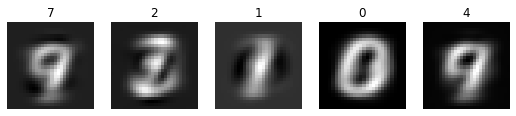

In [ ]:
# Visualize compressed MNIST digits after PCA
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(recovered_images[i].reshape(28, 28), cmap="gray")
  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

In [ ]:
pca = PCA(n_components=2, whiten=True)
pca.fit(train_images)
compressed_images = pca.transform(test_images)
recovered_images = pca.inverse_transform(compressed_images)

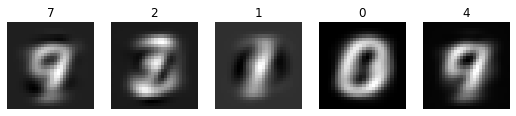

In [ ]:
# Visualize compressed MNIST digits after PCA
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(recovered_images[i].reshape(28, 28), cmap="gray")
  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

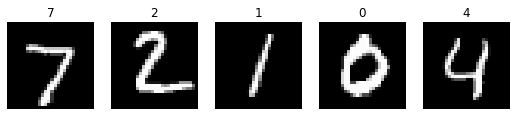

In [ ]:
# Visualize compressed MNIST digits after PCA
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(test_images[i].reshape(28, 28), cmap="gray")
  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

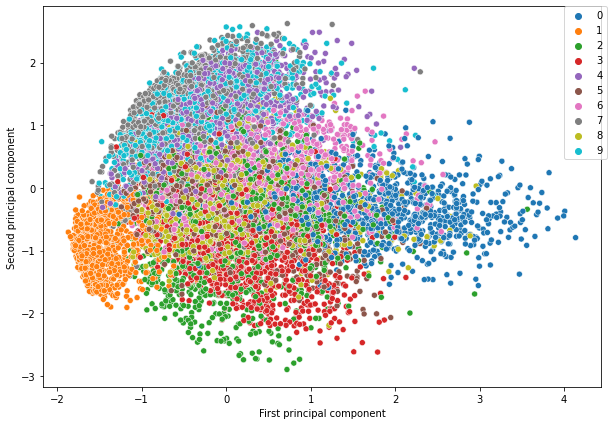

In [ ]:
import seaborn as sns

plt.figure(figsize=(10, 7))

sns.scatterplot(x=compressed_images[:,0],
                y=compressed_images[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("First principal component")
plt.ylabel("Second principal component")

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

### LinearDiscriminantAnalysis

In [ ]:
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.manifold import Isomap

In [ ]:
#%%time
#embedding = Isomap(n_neighbors=30, n_components=2)
#X_transformed = embedding.fit(train_images)

#### **DEFINE CALLBACKS**

In [ ]:
lr = tf.keras.callbacks.ReduceLROnPlateau(monitor="val_loss",
                        factor=0.75,
                        patience=10,
                        verbose=1,
                        mode="min")

early_stop = tf.keras.callbacks.EarlyStopping(monitor="val_loss",
                            patience=25,
                            verbose=1,
                            mode="min",
                            restore_best_weights=True)


checkpoint_filepath = '/checkpoint/'

Checkpoint = tf.keras.callbacks.keras.callbacks.ModelCheckpoint(filepath=checkpoint_filepath,
                                                 save_weights_only=True,
                                                 monitor="val_loss",
                                                 mode='min',
                                                 restore_best_weights=True)

## **2.0 Perform dimensionality reduction with Autoencoder**
Now, we’ll build a deep autoencoder to apply dimensionality reduction to the same MNIST data. We also keep the dimensionality of the latent vector two-dimensional so that it is easy to compare the output with the previous output returned by PCA.

- Step 1: Acquire and prepare the MNIST dataset as previously.
- Step 2: Define the autoencoder architecture

In [ ]:
def model_autoencoder(act_1='sigmoid',act_lat='tanh'):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, activation=act_1)(input_layer)
  enc_layer_2 = Dense(300, activation=act_1)(enc_layer_1)
  enc_layer_3 = Dense(100, activation=act_1)(enc_layer_2)
  enc_layer_4 = Dense(latent_vec_dim, activation=act_lat)(enc_layer_3)
  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, activation=act_1)(encoder)
  dec_layer_2 = Dense(300, activation=act_1)(dec_layer_1)
  dec_layer_3 = Dense(500, activation=act_1)(dec_layer_2)
  dec_layer_4 = Dense(input_dim, activation=act_1)(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
input_dim = 28*28
latent_vec_dim = 2

input_layer = Input(shape=(input_dim,))

# Define the autoencoder architecture
# First build the encoder
enc_layer_1 = Dense(500, activation='sigmoid')(input_layer)
enc_layer_2 = Dense(300, activation='sigmoid')(enc_layer_1)
enc_layer_3 = Dense(100, activation='sigmoid')(enc_layer_2)
enc_layer_4 = Dense(latent_vec_dim, activation='tanh')(enc_layer_3)
encoder = enc_layer_4

# Then build the decoder
dec_layer_1 = Dense(100, activation='sigmoid')(encoder)
dec_layer_2 = Dense(300, activation='sigmoid')(dec_layer_1)
dec_layer_3 = Dense(500, activation='sigmoid')(dec_layer_2)
dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
decoder = dec_layer_4

# Connect both encoder and decoder
autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

# Latent representation (Optional)
latent_model = Model(input_layer, encoder)

In [ ]:
X_t.shape, y_t.shape, X_v.shape, y_v.shape

((50400, 784), (50400,), (9600, 784), (9600,))

### 2.1 Optimizing Alogrithm: ADAM

In [ ]:
autoencoder_adam_lr, latent_model_adam_lr = model_autoencoder(act_1='sigmoid',act_lat='tanh')

# Get summary
autoencoder_adam_lr.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense_8 (Dense)             (None, 500)               392500    
                                                                 
 dense_9 (Dense)             (None, 300)               150300    
                                                                 
 dense_10 (Dense)            (None, 100)               30100     
                                                                 
 dense_11 (Dense)            (None, 2)                 202       
                                                                 
 dense_12 (Dense)            (None, 100)               300       
                                                                 
 dense_13 (Dense)            (None, 300)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_adam_lr.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_lr = autoencoder_adam_lr.fit(X_t, X_t, epochs=250, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                          shuffle=True, validation_data=(X_v, X_v))

autoencoder_adam_lr.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/adam/autoencoder')
latent_model_adam_lr.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/adam/encoder')

Epoch 1/100
394/394 [==============================] - 5s 4ms/step - loss: 0.0692 - val_loss: 0.0677 - lr: 0.0010
Epoch 2/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0675 - val_loss: 0.0676 - lr: 0.0010
Epoch 3/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0615 - val_loss: 0.0584 - lr: 0.0010
Epoch 4/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0565 - val_loss: 0.0549 - lr: 0.0010
Epoch 5/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0539 - val_loss: 0.0530 - lr: 0.0010
Epoch 6/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0520 - val_loss: 0.0511 - lr: 0.0010
Epoch 7/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0505 - val_loss: 0.0497 - lr: 0.0010
Epoch 8/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0495 - val_loss: 0.0488 - lr: 0.0010
Epoch 9/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0487 - val_

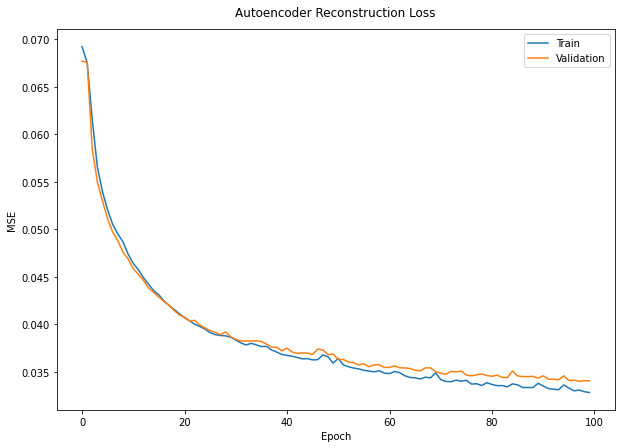

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_lr.history['loss'], label='Train')
plt.plot(history_lr.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

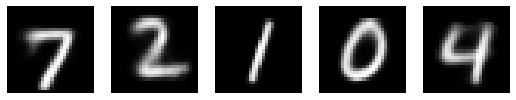

In [ ]:
compressed_images = autoencoder_adam_lr.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

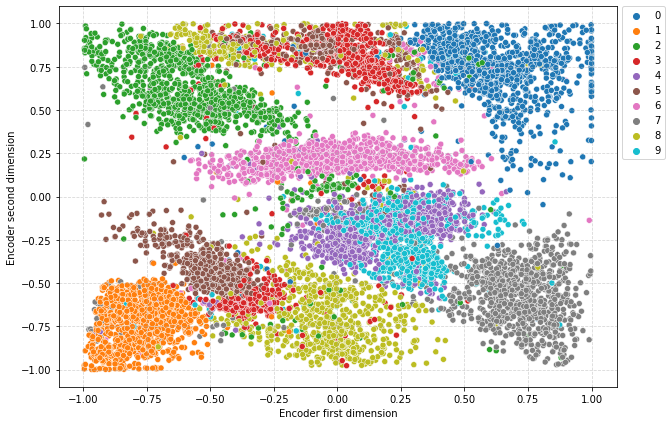

In [ ]:
latent_representation = latent_model_adam_lr.predict(test_images)

import seaborn as sns

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### Adam with no LR

In [ ]:
autoencoder_adam, latent_model_adam = model_autoencoder(act_1='sigmoid',act_lat='tanh')

# Get summary
autoencoder_adam.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense_32 (Dense)            (None, 500)               392500    
                                                                 
 dense_33 (Dense)            (None, 300)               150300    
                                                                 
 dense_34 (Dense)            (None, 100)               30100     
                                                                 
 dense_35 (Dense)            (None, 2)                 202       
                                                                 
 dense_36 (Dense)            (None, 100)               300       
                                                                 
 dense_37 (Dense)            (None, 300)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_adam.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_nolr = autoencoder_adam.fit(X_t, X_t, epochs=100, batch_size=128, callbacks = [early_stop, Checkpoint],
                          shuffle=True, validation_data=(X_v, X_v))

autoencoder_adam.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/adam_nolr/autoencoder')
latent_model_adam.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/adam_nolr/encoder')

Epoch 1/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0692 - val_loss: 0.0676
Epoch 2/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0675 - val_loss: 0.0675
Epoch 3/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0674 - val_loss: 0.0675
Epoch 4/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0601 - val_loss: 0.0582
Epoch 5/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0565 - val_loss: 0.0549
Epoch 6/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0541 - val_loss: 0.0532
Epoch 7/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0522 - val_loss: 0.0514
Epoch 8/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0506 - val_loss: 0.0500
Epoch 9/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0496 - val_loss: 0.0490
Epoch 10/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0489 - val_lo

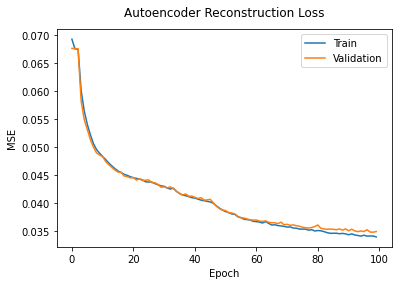

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.plot(history_nolr.history['loss'], label='Train')
plt.plot(history_nolr.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

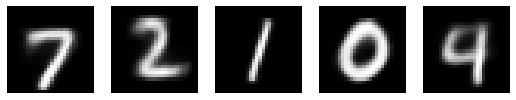

In [ ]:
compressed_images = autoencoder_adam.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

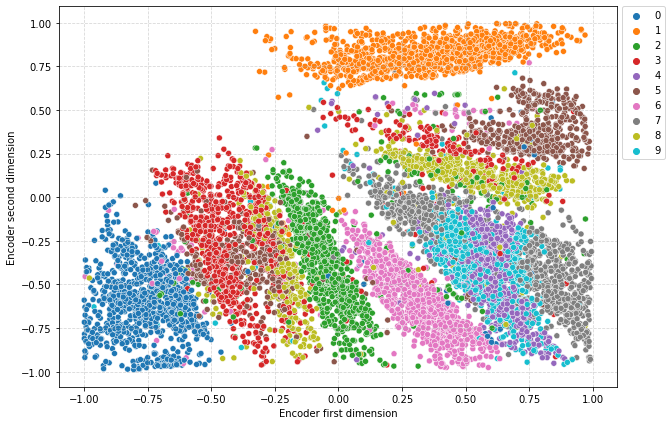

In [ ]:
latent_representation = latent_model_adam.predict(test_images)

import seaborn as sns

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

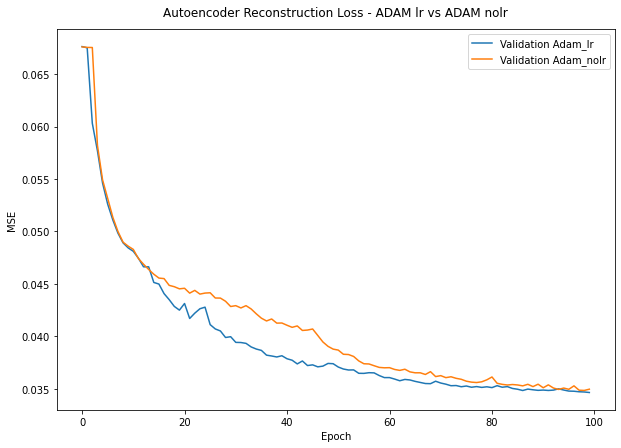

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_lr.history['val_loss'], label='Validation Adam_lr')
plt.plot(history_nolr.history['val_loss'], label='Validation Adam_nolr')

plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - ADAM lr vs ADAM nolr', pad=13)
plt.legend(loc='upper right')

### 2.2 Optimizing Algo: NADAM

In [ ]:
autoencoder_nadam, latent_model_nadam = model_autoencoder(act_1='sigmoid',act_lat='tanh')

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Nadam()
loss = 'mse'
autoencoder_nadam.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_nadam = autoencoder_nadam.fit(X_t, X_t, epochs=100, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                      shuffle=True, validation_data=(X_v, X_v))

autoencoder_nadam.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/nadam/autoencoder')
latent_model_nadam.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/nadam/encoder')

Epoch 1/100
394/394 [==============================] - 4s 7ms/step - loss: 0.0695 - val_loss: 0.0676 - lr: 0.0010
Epoch 2/100
394/394 [==============================] - 2s 6ms/step - loss: 0.0675 - val_loss: 0.0676 - lr: 0.0010
Epoch 3/100
394/394 [==============================] - 2s 6ms/step - loss: 0.0674 - val_loss: 0.0667 - lr: 0.0010
Epoch 4/100
394/394 [==============================] - 2s 6ms/step - loss: 0.0606 - val_loss: 0.0583 - lr: 0.0010
Epoch 5/100
394/394 [==============================] - 3s 6ms/step - loss: 0.0568 - val_loss: 0.0557 - lr: 0.0010
Epoch 6/100
394/394 [==============================] - 3s 7ms/step - loss: 0.0544 - val_loss: 0.0533 - lr: 0.0010
Epoch 7/100
394/394 [==============================] - 3s 7ms/step - loss: 0.0525 - val_loss: 0.0516 - lr: 0.0010
Epoch 8/100
394/394 [==============================] - 3s 7ms/step - loss: 0.0510 - val_loss: 0.0504 - lr: 0.0010
Epoch 9/100
394/394 [==============================] - 2s 6ms/step - loss: 0.0500 - val_

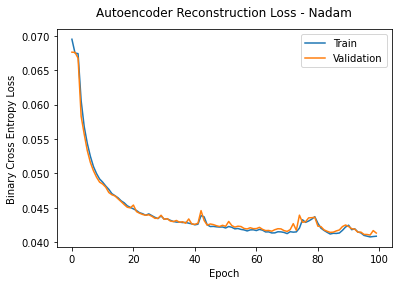

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.plot(history_nadam.history['loss'], label='Train')
plt.plot(history_nadam.history['val_loss'], label='Validation')
plt.ylabel('Binary Cross Entropy Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam', pad=13)
plt.legend(loc='upper right')

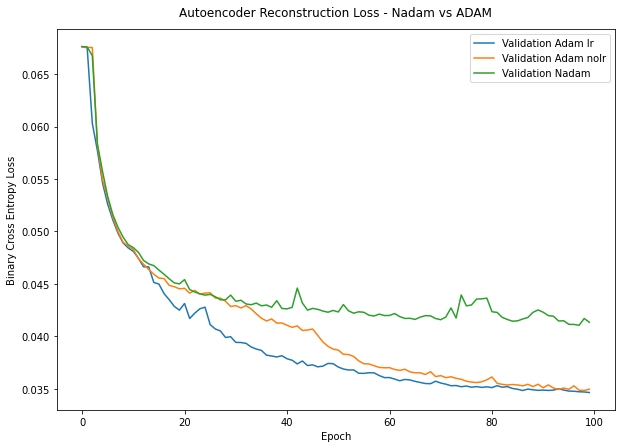

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_lr.history['val_loss'], label='Validation Adam lr')
plt.plot(history_nolr.history['val_loss'], label='Validation Adam nolr')
plt.plot(history_nadam.history['val_loss'], label='Validation Nadam')
plt.ylabel('Binary Cross Entropy Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam vs ADAM', pad=13)
plt.legend(loc='upper right')

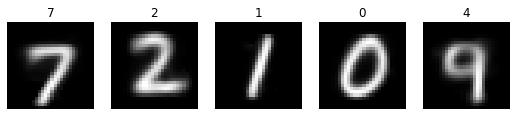

In [ ]:
compressed_images = autoencoder_nadam.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")

  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

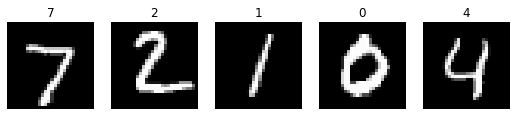

In [ ]:
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(test_images[i].reshape(28, 28), cmap="gray")
  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

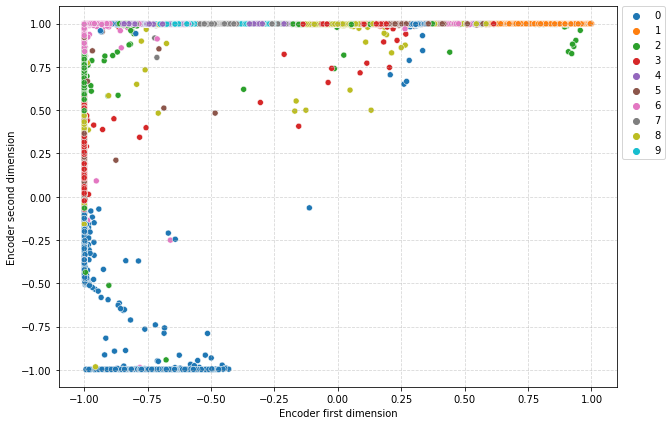

In [ ]:
latent_representation = latent_model_nadam.predict(test_images)

import seaborn as sns

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

### 2.2 Optimizing Algo: ADAMBelief

In [ ]:
autoencoder_adam_b, latent_model_adam_b = model_autoencoder(act_1='sigmoid',act_lat='tanh')

# Get summary
#autoencoder_adam_b.summary()

In [ ]:
# Compile the autoencoder model
optimizer = AdaBeliefOptimizer(learning_rate=0.025,
                               weight_decay = 1e-5,
                               epsilon = 1e-7,
                               print_change_log = False)
loss = 'mse'

autoencoder_adam_b.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_ab = autoencoder_adam_b.fit(X_t, X_t, epochs=140, batch_size=128, callbacks = [early_stop, Checkpoint],
                                   shuffle=True, validation_data=(X_v, X_v))

autoencoder_adam_b.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/adabelief/autoencoder')
latent_model_adam_b.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/adabelief/encoder')

Epoch 1/140
394/394 [==============================] - 7s 10ms/step - loss: 0.1020 - val_loss: 0.0691
Epoch 2/140
394/394 [==============================] - 4s 9ms/step - loss: 0.0681 - val_loss: 0.0678
Epoch 3/140
394/394 [==============================] - 4s 9ms/step - loss: 0.0676 - val_loss: 0.0676
Epoch 4/140
394/394 [==============================] - 4s 9ms/step - loss: 0.0674 - val_loss: 0.0675
Epoch 5/140
394/394 [==============================] - 4s 10ms/step - loss: 0.0674 - val_loss: 0.0674
Epoch 6/140
394/394 [==============================] - 4s 9ms/step - loss: 0.0673 - val_loss: 0.0674
Epoch 7/140
394/394 [==============================] - 4s 9ms/step - loss: 0.0673 - val_loss: 0.0674
Epoch 8/140
394/394 [==============================] - 4s 9ms/step - loss: 0.0673 - val_loss: 0.0674
Epoch 9/140
394/394 [==============================] - 4s 10ms/step - loss: 0.0673 - val_loss: 0.0674
Epoch 10/140
394/394 [==============================] - 4s 9ms/step - loss: 0.0673 - val

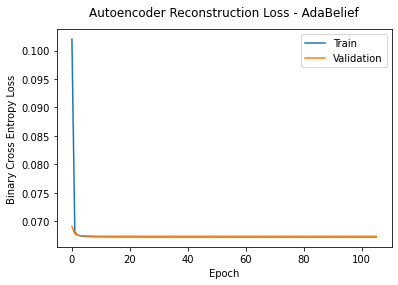

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.plot(history_ab.history['loss'], label='Train')
plt.plot(history_ab.history['val_loss'], label='Validation')
plt.ylabel('Binary Cross Entropy Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - AdaBelief', pad=13)
plt.legend(loc='upper right')

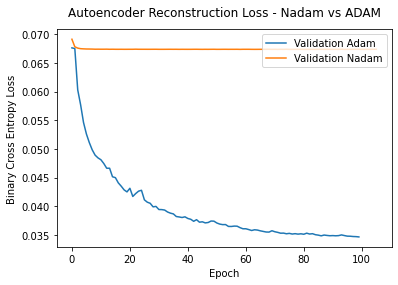

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.plot(history_lr.history['val_loss'], label='Validation Adam')
plt.plot(history_ab.history['val_loss'], label='Validation Nadam')
plt.ylabel('Binary Cross Entropy Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam vs ADAM', pad=13)
plt.legend(loc='upper right')

### 2.2 Optimizing Algo: SGD

In [ ]:
autoencoder_sgdnest, latent_model_sgdnest = model_autoencoder(act_1='sigmoid',act_lat='tanh')

# Get summary
#autoencoder_adam_b.summary()

In [ ]:
# Compile the autoencoder model
optimizer = keras.optimizers.SGD(learning_rate=0.02)
loss = 'mse'

autoencoder_sgdnest.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_ab = autoencoder_sgdnest.fit(X_t, X_t, epochs=250, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                   shuffle=True, validation_data=(X_v, X_v))

Epoch 1/250
394/394 [==============================] - 2s 4ms/step - loss: 0.2191 - val_loss: 0.1965 - lr: 0.0200
Epoch 2/250
394/394 [==============================] - 1s 4ms/step - loss: 0.1781 - val_loss: 0.1616 - lr: 0.0200
Epoch 3/250
394/394 [==============================] - 1s 3ms/step - loss: 0.1483 - val_loss: 0.1366 - lr: 0.0200
Epoch 4/250
394/394 [==============================] - 1s 3ms/step - loss: 0.1273 - val_loss: 0.1192 - lr: 0.0200
Epoch 5/250
394/394 [==============================] - 1s 3ms/step - loss: 0.1127 - val_loss: 0.1070 - lr: 0.0200
Epoch 6/250
394/394 [==============================] - 1s 3ms/step - loss: 0.1023 - val_loss: 0.0984 - lr: 0.0200
Epoch 7/250
394/394 [==============================] - 1s 3ms/step - loss: 0.0950 - val_loss: 0.0922 - lr: 0.0200
Epoch 8/250
394/394 [==============================] - 1s 3ms/step - loss: 0.0897 - val_loss: 0.0876 - lr: 0.0200
Epoch 9/250
394/394 [==============================] - 1s 3ms/step - loss: 0.0858 - val_

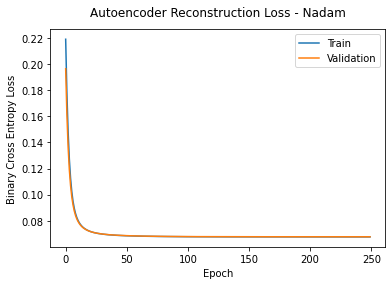

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.plot(history_ab.history['loss'], label='Train')
plt.plot(history_ab.history['val_loss'], label='Validation')
plt.ylabel('Binary Cross Entropy Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam', pad=13)
plt.legend(loc='upper right')

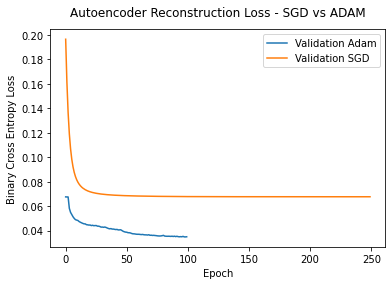

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.plot(history_nolr.history['val_loss'], label='Validation Adam')
plt.plot(history_ab.history['val_loss'], label='Validation SGD')
plt.ylabel('Binary Cross Entropy Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - SGD vs ADAM', pad=13)
plt.legend(loc='upper right')

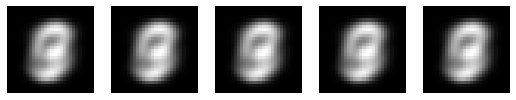

In [ ]:
compressed_images = autoencoder_sgdnest.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

## 3.0 Variational Autoencoders:

In [ ]:
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

In [ ]:
input_dim = 28*28
latent_vec_dim = 2

input_layer = Input(shape=(input_dim,))

# Define the autoencoder architecture
# First build the encoder
enc_layer_1 = Dense(500, activation='sigmoid')(input_layer)
enc_layer_2 = Dense(300, activation='sigmoid')(enc_layer_1)
enc_layer_3 = Dense(100, activation='sigmoid')(enc_layer_2)
enc_layer_4 = Dense(32, activation='sigmoid')(enc_layer_3)
z_mean = layers.Dense(latent_vec_dim, name="z_mean")(enc_layer_4)
z_log_var = layers.Dense(latent_vec_dim, name="z_log_var")(enc_layer_4)
z = Sampling()([z_mean, z_log_var])
encoder = keras.Model(input_layer, [z_mean, z_log_var, z], name="encoder")
encoder.summary()


Model: "encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_17 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_93 (Dense)               (None, 500)          392500      ['input_17[0][0]']               
                                                                                                  
 dense_94 (Dense)               (None, 300)          150300      ['dense_93[0][0]']               
                                                                                                  
 dense_95 (Dense)               (None, 100)          30100       ['dense_94[0][0]']               
                                                                                            

In [ ]:
# Then build the decoder
latent_inputs = keras.Input(shape=(latent_vec_dim,))
dec_layer_0 = Dense(32, activation='sigmoid')(latent_inputs)
dec_layer_1 = Dense(100, activation='sigmoid')(dec_layer_0)
dec_layer_2 = Dense(300, activation='sigmoid')(dec_layer_1)
dec_layer_3 = Dense(500, activation='sigmoid')(dec_layer_2)
dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)

decoder = keras.Model(latent_inputs, dec_layer_4, name="decoder")
decoder.summary()

Model: "decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_18 (InputLayer)       [(None, 2)]               0         
                                                                 
 dense_97 (Dense)            (None, 32)                96        
                                                                 
 dense_98 (Dense)            (None, 100)               3300      
                                                                 
 dense_99 (Dense)            (None, 300)               30300     
                                                                 
 dense_100 (Dense)           (None, 500)               150500    
                                                                 
 dense_101 (Dense)           (None, 784)               392784    
                                                                 
Total params: 576,980
Trainable params: 576,980
Non-trainab

In [ ]:
# instantiate VAE model
outputs = decoder(encoder(input_layer)[2])
vae = keras.Model(input_layer, outputs, name='vae_mlp')

What we've done so far allows us to instantiate 3 models:

* an end-to-end autoencoder mapping inputs to reconstructions
* an encoder mapping inputs to the latent space
* a generator that can take points on the latent space and will output the corresponding reconstructed samples.

We train the model using the end-to-end model, with a custom loss function: the sum of a reconstruction term, and the KL divergence regularization term.

In [ ]:
reconstruction_loss = keras.losses.binary_crossentropy(input_layer, outputs)
reconstruction_loss *= input_dim
kl_loss = 1 + z_log_var - K.square(z_mean) - K.exp(z_log_var)
kl_loss = K.sum(kl_loss, axis=-1)
kl_loss *= -0.5
vae_loss = K.mean(reconstruction_loss + kl_loss)
vae.add_loss(vae_loss)
vae.compile(optimizer='adam')

In [ ]:
history_vae = vae.fit(X_t, X_t,
                      epochs=100,
                      batch_size=128,
                      callbacks = [early_stop, Checkpoint, lr],
                      shuffle=True,
                      validation_data=(X_v, X_v))

Epoch 1/100
394/394 [==============================] - 3s 6ms/step - loss: 211.1557 - val_loss: 206.9186 - lr: 0.0010
Epoch 2/100
394/394 [==============================] - 2s 6ms/step - loss: 206.6700 - val_loss: 206.6702 - lr: 0.0010
Epoch 3/100
394/394 [==============================] - 2s 6ms/step - loss: 206.6015 - val_loss: 206.6421 - lr: 0.0010
Epoch 4/100
394/394 [==============================] - 2s 6ms/step - loss: 206.5069 - val_loss: 206.3991 - lr: 0.0010
Epoch 5/100
394/394 [==============================] - 2s 6ms/step - loss: 206.4293 - val_loss: 206.4631 - lr: 0.0010
Epoch 6/100
394/394 [==============================] - 2s 6ms/step - loss: 206.4181 - val_loss: 206.3296 - lr: 0.0010
Epoch 7/100
394/394 [==============================] - 2s 6ms/step - loss: 193.8835 - val_loss: 187.3345 - lr: 0.0010
Epoch 8/100
394/394 [==============================] - 2s 6ms/step - loss: 184.2414 - val_loss: 181.0177 - lr: 0.0010
Epoch 9/100
394/394 [==============================] - 2

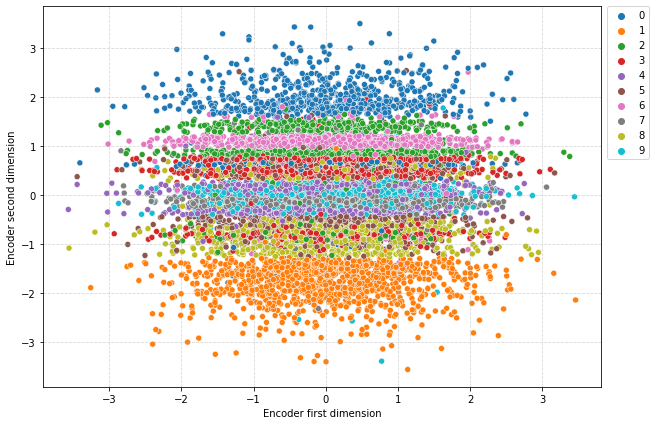

In [ ]:
latent_representation = encoder.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[2][:,0],
                y=latent_representation[2][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

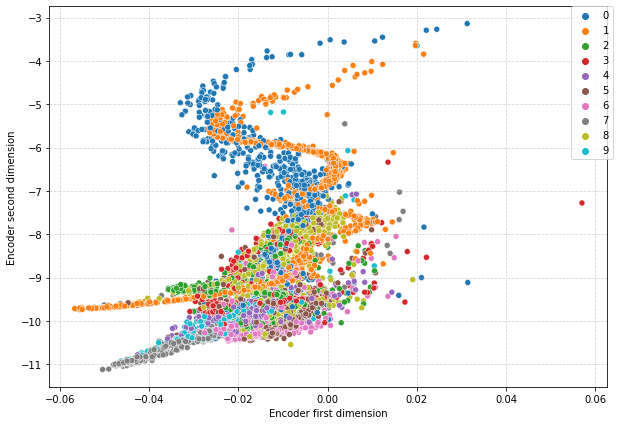

In [ ]:
plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[1][:,0],
                y=latent_representation[1][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

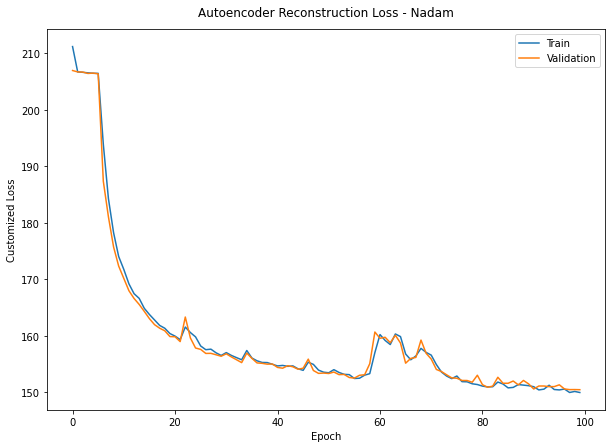

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_vae.history['loss'], label='Train')
plt.plot(history_vae.history['val_loss'], label='Validation')
plt.ylabel('Customized Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam', pad=13)
plt.legend(loc='upper right')

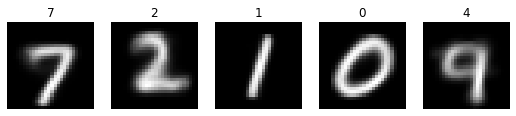

In [ ]:
compressed_images = vae.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")

  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

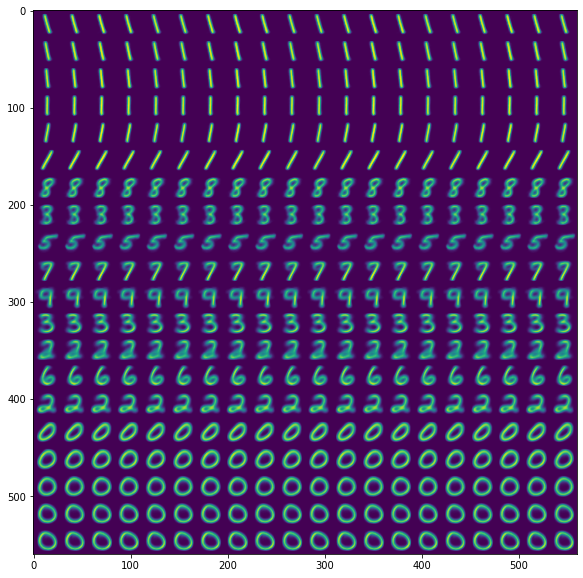

In [ ]:
# Display a 2D manifold of the digits
n = 20  # figure with 15x15 digits
digit_size = 28
figure = np.zeros((digit_size * n, digit_size * n))
# We will sample n points within [-15, 15] standard deviations
grid_x = np.linspace(-3, 3, n)
grid_y = np.linspace(-3, 3, n)

for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
        z_sample = np.array([[xi, yi]])
        x_decoded = decoder.predict(z_sample)
        digit = x_decoded[0].reshape(digit_size, digit_size)
        figure[i * digit_size: (i + 1) * digit_size,
               j * digit_size: (j + 1) * digit_size] = digit

plt.figure(figsize=(10, 10))
plt.imshow(figure)
plt.show()

In [ ]:
vae.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/vae/autoencoder')
encoder.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_tanh/vae/encoder')

## 3.0 Exploring Different Activation Functions:

#### 4.1 Linear for Latent Dimension:

In [ ]:
autoencoder_siglin, latent_model_siglin = model_autoencoder(act_1='sigmoid',act_lat='linear')

# Get summary
autoencoder_siglin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_20 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_110 (Dense)           (None, 500)               392500    
                                                                 
 dense_111 (Dense)           (None, 300)               150300    
                                                                 
 dense_112 (Dense)           (None, 100)               30100     
                                                                 
 dense_113 (Dense)           (None, 2)                 202       
                                                                 
 dense_114 (Dense)           (None, 100)               300       
                                                                 
 dense_115 (Dense)           (None, 300)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_siglin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_siglin = autoencoder_siglin.fit(X_t, X_t, epochs=100, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                    shuffle=True, validation_data=(X_v, X_v))

autoencoder_siglin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_lin/enc/autoencoder')
latent_model_siglin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/sig_lin/enc/encoder')

Epoch 1/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0692 - val_loss: 0.0676 - lr: 0.0010
Epoch 2/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0675 - val_loss: 0.0675 - lr: 0.0010
Epoch 3/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0620 - val_loss: 0.0577 - lr: 0.0010
Epoch 4/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0557 - val_loss: 0.0543 - lr: 0.0010
Epoch 5/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0529 - val_loss: 0.0515 - lr: 0.0010
Epoch 6/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0506 - val_loss: 0.0498 - lr: 0.0010
Epoch 7/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0493 - val_loss: 0.0488 - lr: 0.0010
Epoch 8/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0484 - val_loss: 0.0479 - lr: 0.0010
Epoch 9/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0475 - val_

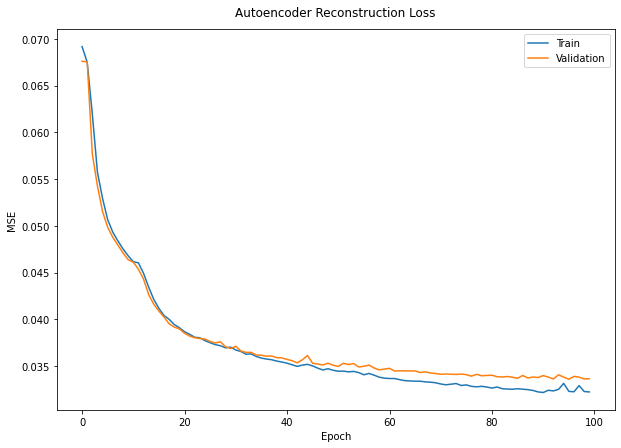

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_siglin.history['loss'], label='Train')
plt.plot(history_siglin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

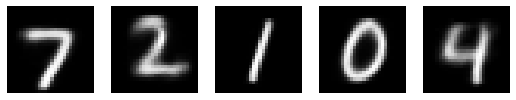

In [ ]:
compressed_images = autoencoder_siglin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

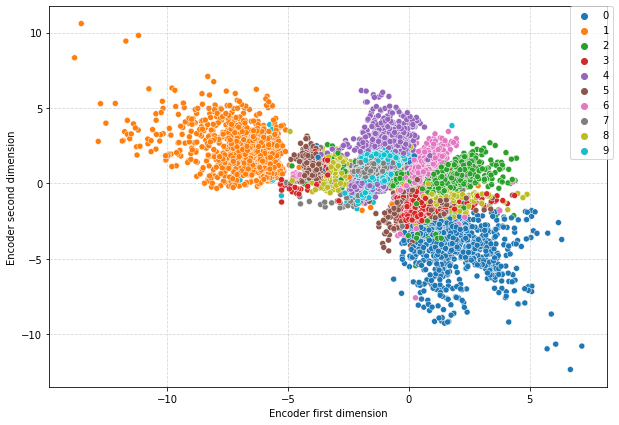

In [ ]:
latent_representation = latent_model_siglin.predict(test_images)

import seaborn as sns

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.2 Hidden Layers: Relu - Latent Space: Linear

In [ ]:
def model_autoencoder(act_1='relu',act_lat='tanh',kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, activation=act_1, kernel_initializer=kernel)(input_layer)
  enc_layer_2 = Dense(300, activation=act_1, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_3 = Dense(100, activation=act_1, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_4 = Dense(latent_vec_dim, activation=act_lat)(enc_layer_3)
  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, activation=act_1, kernel_initializer=kernel)(encoder)
  dec_layer_2 = Dense(300, activation=act_1, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_3 = Dense(500, activation=act_1, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_rellin, latent_model_rellin = model_autoencoder(act_1='relu',act_lat='linear')

# Get summary
autoencoder_rellin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_23 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_134 (Dense)           (None, 500)               392500    
                                                                 
 dense_135 (Dense)           (None, 300)               150300    
                                                                 
 dense_136 (Dense)           (None, 100)               30100     
                                                                 
 dense_137 (Dense)           (None, 2)                 202       
                                                                 
 dense_138 (Dense)           (None, 100)               300       
                                                                 
 dense_139 (Dense)           (None, 300)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_rellin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_rellin = autoencoder_rellin.fit(X_t, X_t, epochs=100, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_rellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/rel_lin/enc/autoencoder')
latent_model_rellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/rel_lin/enc/encoder')

Epoch 1/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0546 - val_loss: 0.0464 - lr: 0.0010
Epoch 2/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0442 - val_loss: 0.0429 - lr: 0.0010
Epoch 3/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0413 - val_loss: 0.0403 - lr: 0.0010
Epoch 4/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0396 - val_loss: 0.0393 - lr: 0.0010
Epoch 5/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0384 - val_loss: 0.0382 - lr: 0.0010
Epoch 6/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0377 - val_loss: 0.0382 - lr: 0.0010
Epoch 7/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0371 - val_loss: 0.0369 - lr: 0.0010
Epoch 8/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0366 - val_loss: 0.0367 - lr: 0.0010
Epoch 9/100
394/394 [==============================] - 1s 4ms/step - loss: 0.0362 - val_

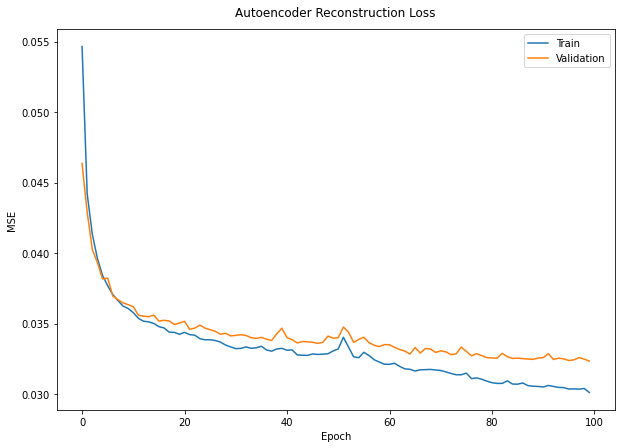

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_rellin.history['loss'], label='Train')
plt.plot(history_rellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

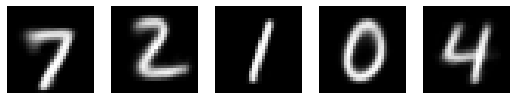

In [ ]:
compressed_images = autoencoder_rellin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

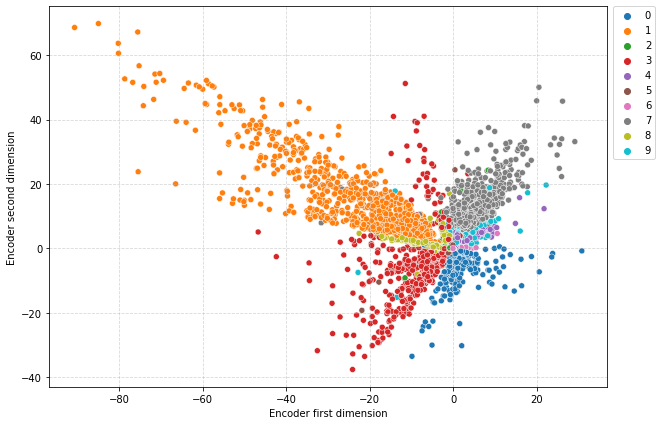

In [ ]:
latent_representation = latent_model_rellin.predict(test_images)

import seaborn as sns

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.2 Hidden Layers: PRelu - Latent Space: Linear

In [ ]:
def model_autoencoder(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.PReLU()(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.PReLU()(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.PReLU()(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.PReLU()(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.PReLU()(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.PReLU()(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_31 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_180 (Dense)           (None, 500)               392500    
                                                                 
 p_re_lu_21 (PReLU)          (None, 500)               500       
                                                                 
 dense_181 (Dense)           (None, 300)               150300    
                                                                 
 p_re_lu_22 (PReLU)          (None, 300)               300       
                                                                 
 dense_182 (Dense)           (None, 100)               30100     
                                                                 
 p_re_lu_23 (PReLU)          (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_prellin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, X_t, epochs=100, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin/enc/encoder')

Epoch 1/100
394/394 [==============================] - 3s 5ms/step - loss: 0.0550 - val_loss: 0.0469 - lr: 0.0010
Epoch 2/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0444 - val_loss: 0.0427 - lr: 0.0010
Epoch 3/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0414 - val_loss: 0.0407 - lr: 0.0010
Epoch 4/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0397 - val_loss: 0.0397 - lr: 0.0010
Epoch 5/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0385 - val_loss: 0.0383 - lr: 0.0010
Epoch 6/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0375 - val_loss: 0.0375 - lr: 0.0010
Epoch 7/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0370 - val_loss: 0.0371 - lr: 0.0010
Epoch 8/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0367 - val_loss: 0.0368 - lr: 0.0010
Epoch 9/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0362 - val_

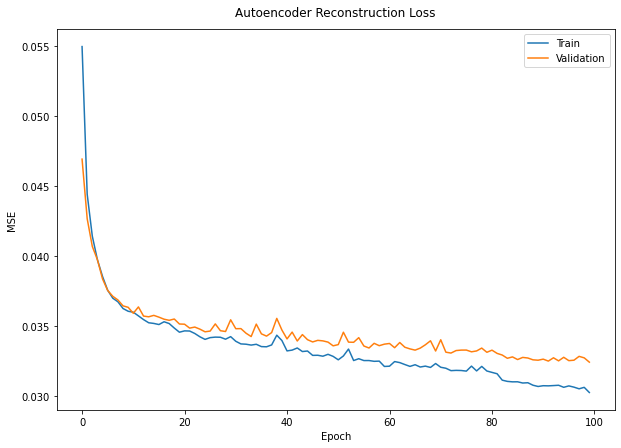

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

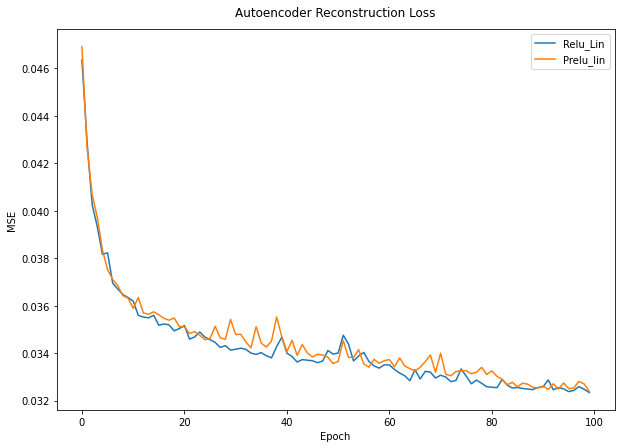

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_rellin.history['val_loss'], label='Relu_Lin')
plt.plot(history_prellin.history['val_loss'], label='Prelu_lin')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

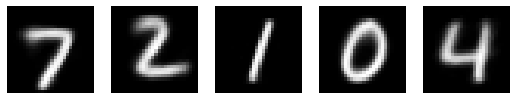

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

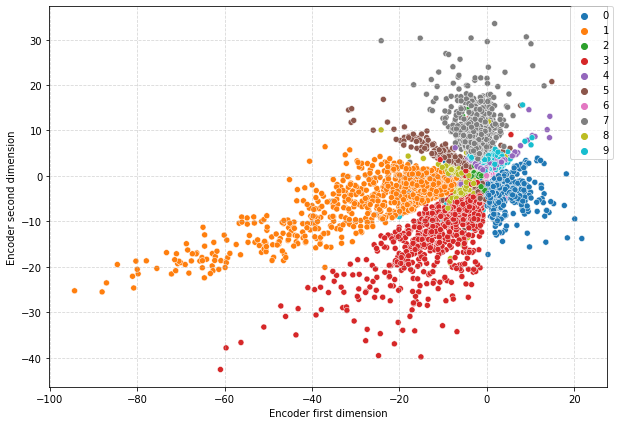

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.3 Hidden Layers: PRelu - Latent Space: Linear + Regularization L1

In [ ]:
def model_autoencoder(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.PReLU()(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.PReLU()(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.PReLU()(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=0.001))(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.PReLU()(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.PReLU()(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.PReLU()(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_17 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_88 (Dense)            (None, 500)               392500    
                                                                 
 p_re_lu_20 (PReLU)          (None, 500)               500       
                                                                 
 dense_89 (Dense)            (None, 300)               150300    
                                                                 
 p_re_lu_21 (PReLU)          (None, 300)               300       
                                                                 
 dense_90 (Dense)            (None, 100)               30100     
                                                                 
 p_re_lu_22 (PReLU)          (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_prellin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_l1/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_l1/enc/encoder')

Epoch 1/120
394/394 [==============================] - 3s 6ms/step - loss: 0.0615 - val_loss: 0.0475 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0450 - val_loss: 0.0434 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0421 - val_loss: 0.0414 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 6ms/step - loss: 0.0405 - val_loss: 0.0402 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 6ms/step - loss: 0.0394 - val_loss: 0.0394 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0386 - val_loss: 0.0391 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0380 - val_loss: 0.0381 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0375 - val_loss: 0.0377 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0371 - val_

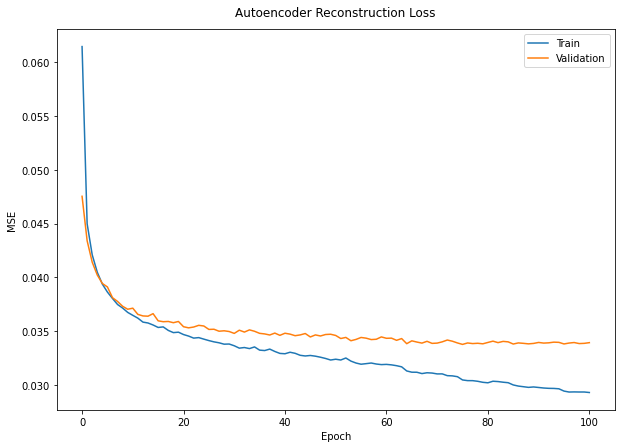

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

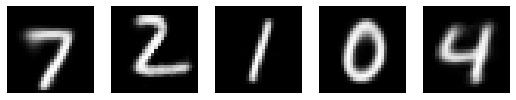

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

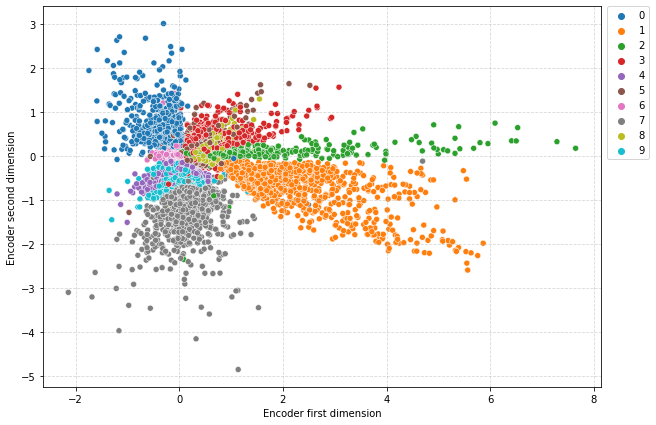

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.3.1 Hidden Layers: PRelu - Latent Space: Linear + BatchNorm

In [ ]:
def model_autoencoder(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1)
  enc_layer_1 = tf.keras.layers.PReLU()(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.layers.PReLU()(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.layers.PReLU()(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.layers.PReLU()(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.layers.PReLU()(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.layers.PReLU()(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_18 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_96 (Dense)            (None, 500)               392500    
                                                                 
 batch_normalization (BatchN  (None, 500)              2000      
 ormalization)                                                   
                                                                 
 p_re_lu_26 (PReLU)          (None, 500)               500       
                                                                 
 dense_97 (Dense)            (None, 300)               150300    
                                                                 
 batch_normalization_1 (Batc  (None, 300)              1200      
 hNormalization)                                  

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_prellin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_bn/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_bn/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 9ms/step - loss: 0.0498 - val_loss: 0.0428 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 3s 9ms/step - loss: 0.0420 - val_loss: 0.0403 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 3s 9ms/step - loss: 0.0403 - val_loss: 0.0391 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 9ms/step - loss: 0.0393 - val_loss: 0.0384 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 3s 9ms/step - loss: 0.0387 - val_loss: 0.0379 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 3s 9ms/step - loss: 0.0380 - val_loss: 0.0369 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 3s 9ms/step - loss: 0.0376 - val_loss: 0.0369 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 3s 9ms/step - loss: 0.0373 - val_loss: 0.0368 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 3s 9ms/step - loss: 0.0370 - val_

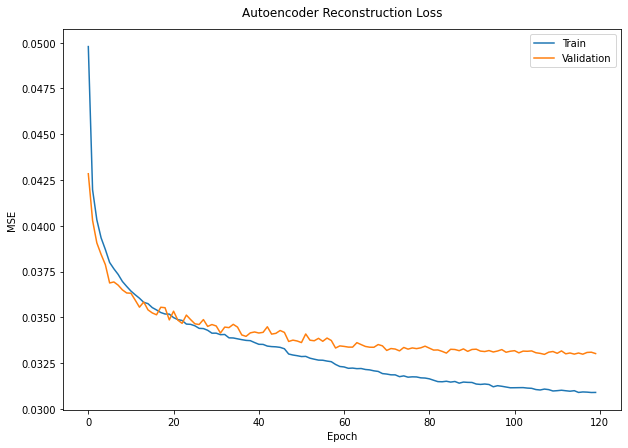

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

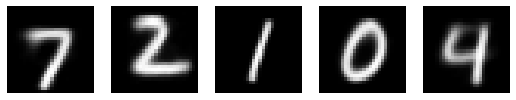

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

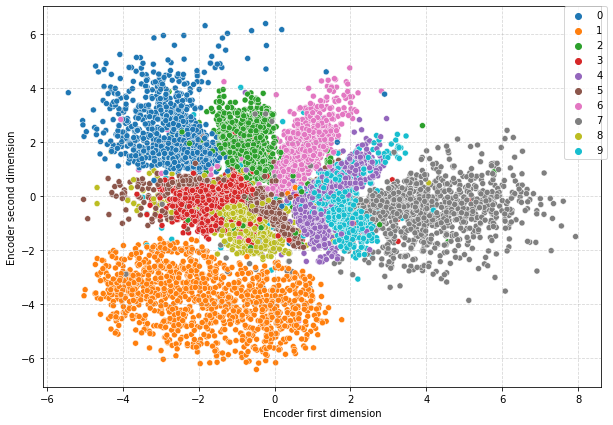

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.4 Hidden: Swish - Latent Linear

In [ ]:
def model_autoencoder(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.swish(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.swish(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.swish(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.swish(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.swish(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.swish(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_swilin, latent_model_swilin = model_autoencoder()

# Get summary
autoencoder_swilin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_35 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_193 (Dense)           (None, 500)               392500    
                                                                 
 tf.nn.silu_2 (TFOpLambda)   (None, 500)               0         
                                                                 
 dense_194 (Dense)           (None, 300)               150300    
                                                                 
 tf.nn.silu_3 (TFOpLambda)   (None, 300)               0         
                                                                 
 dense_195 (Dense)           (None, 100)               30100     
                                                                 
 tf.nn.silu_4 (TFOpLambda)   (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_swilin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_swilin = autoencoder_swilin.fit(X_t, X_t, epochs=100, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_swilin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin/enc/autoencoder')
latent_model_swilin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin/enc/encoder')

Epoch 1/100
394/394 [==============================] - 2s 5ms/step - loss: 0.0528 - val_loss: 0.0451 - lr: 0.0010
Epoch 2/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0427 - val_loss: 0.0412 - lr: 0.0010
Epoch 3/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0402 - val_loss: 0.0395 - lr: 0.0010
Epoch 4/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0392 - val_loss: 0.0386 - lr: 0.0010
Epoch 5/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0379 - val_loss: 0.0376 - lr: 0.0010
Epoch 6/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0372 - val_loss: 0.0369 - lr: 0.0010
Epoch 7/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0368 - val_loss: 0.0368 - lr: 0.0010
Epoch 8/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0363 - val_loss: 0.0361 - lr: 0.0010
Epoch 9/100
394/394 [==============================] - 2s 4ms/step - loss: 0.0359 - val_

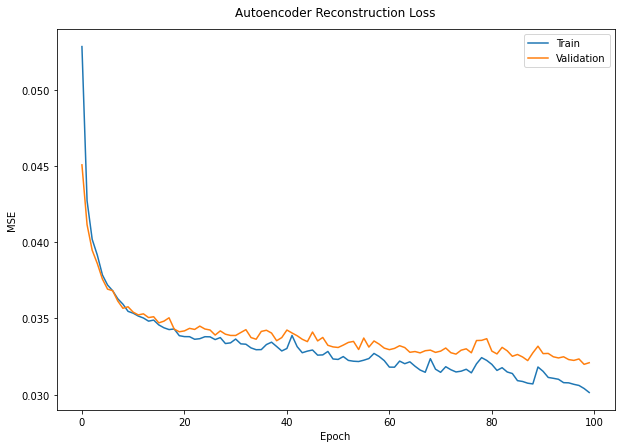

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_swilin.history['loss'], label='Train')
plt.plot(history_swilin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

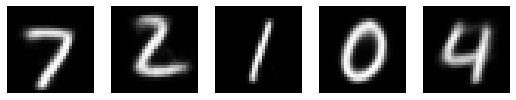

In [ ]:
compressed_images = autoencoder_swilin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

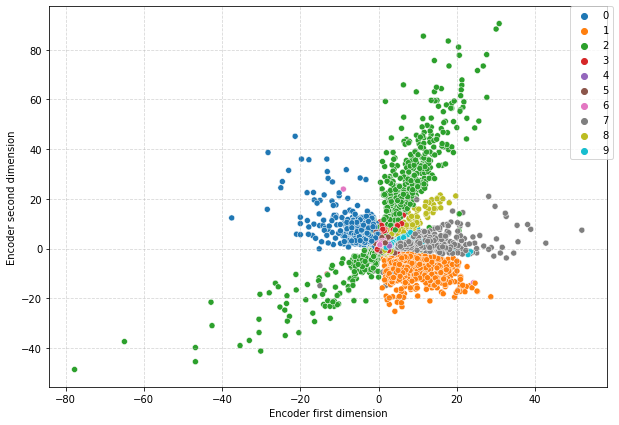

In [ ]:
latent_representation = latent_model_swilin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

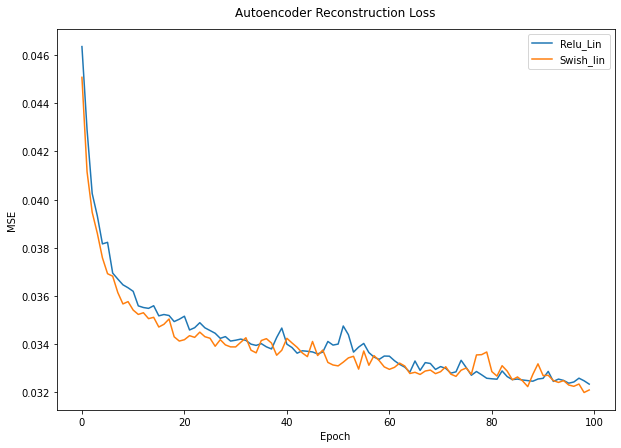

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_rellin.history['val_loss'], label='Relu_Lin')
plt.plot(history_swilin.history['val_loss'], label='Swish_lin')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

#### 4.5 Hidden: Swish - Latent: Sig

In [ ]:
def model_autoencoder(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.swish(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.swish(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.swish(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='sigmoid')(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.swish(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.swish(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.swish(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_swisig, latent_model_swisig = model_autoencoder()

# Get summary
autoencoder_swisig.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense_16 (Dense)            (None, 500)               392500    
                                                                 
 tf.nn.silu_12 (TFOpLambda)  (None, 500)               0         
                                                                 
 dense_17 (Dense)            (None, 300)               150300    
                                                                 
 tf.nn.silu_13 (TFOpLambda)  (None, 300)               0         
                                                                 
 dense_18 (Dense)            (None, 100)               30100     
                                                                 
 tf.nn.silu_14 (TFOpLambda)  (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_swisig.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_swisig = autoencoder_swisig.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_swisig.save(f'/content/drive/MyDrive/Exercises/Autoencoders/swi_sig/enc/autoencoder')
latent_model_swisig.save(f'/content/drive/MyDrive/Exercises/Autoencoders/swi_sig/enc/encoder')

Epoch 1/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0698 - val_loss: 0.0676 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0675 - val_loss: 0.0675 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0674 - val_loss: 0.0675 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0674 - val_loss: 0.0674 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0674 - val_loss: 0.0674 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0674 - val_loss: 0.0674 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0673 - val_loss: 0.0674 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0673 - val_loss: 0.0674 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0673 - val_

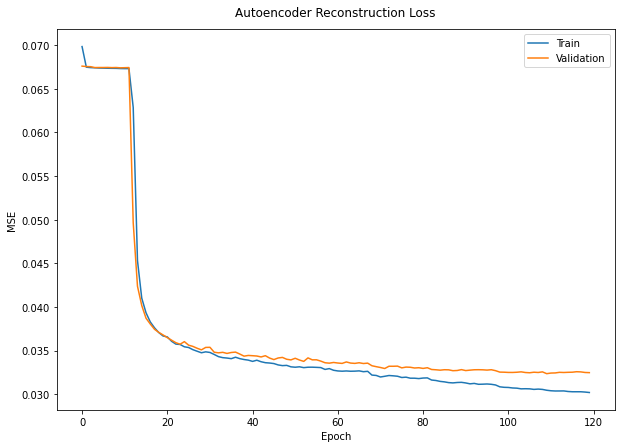

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_swisig.history['loss'], label='Train')
plt.plot(history_swisig.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

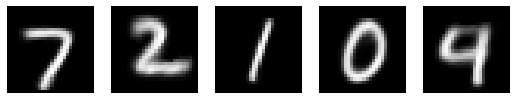

In [ ]:
compressed_images = autoencoder_swisig.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

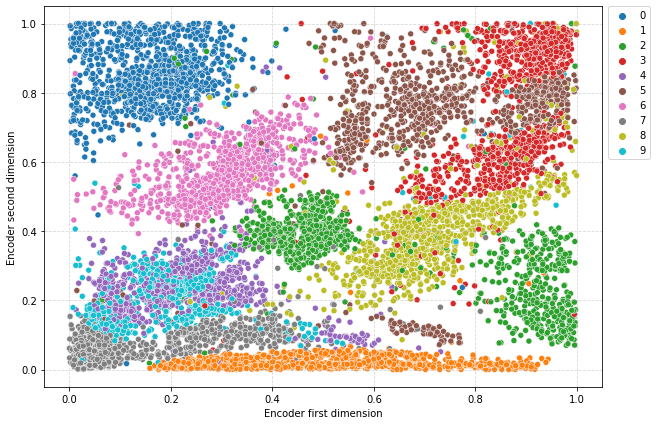

In [ ]:
latent_representation = latent_model_swisig.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.6 Hidden: Selu - Latent: Linear

In [ ]:
def model_autoencoder(kernel="lecun_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.selu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.selu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.selu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.selu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.selu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.selu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_selulin, latent_model_selulin = model_autoencoder()

# Get summary
autoencoder_selulin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_5 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense_32 (Dense)            (None, 500)               392500    
                                                                 
 tf.nn.selu_6 (TFOpLambda)   (None, 500)               0         
                                                                 
 dense_33 (Dense)            (None, 300)               150300    
                                                                 
 tf.nn.selu_7 (TFOpLambda)   (None, 300)               0         
                                                                 
 dense_34 (Dense)            (None, 100)               30100     
                                                                 
 tf.nn.selu_8 (TFOpLambda)   (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_selulin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_selulin = autoencoder_selulin.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_selulin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/selu_lin/enc/autoencoder')
latent_model_selulin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/selu_lin/enc/encoder')

Epoch 1/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0574 - val_loss: 0.0490 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0471 - val_loss: 0.0452 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0440 - val_loss: 0.0426 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0426 - val_loss: 0.0413 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0408 - val_loss: 0.0404 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0400 - val_loss: 0.0397 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0392 - val_loss: 0.0395 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0388 - val_loss: 0.0402 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0384 - val_

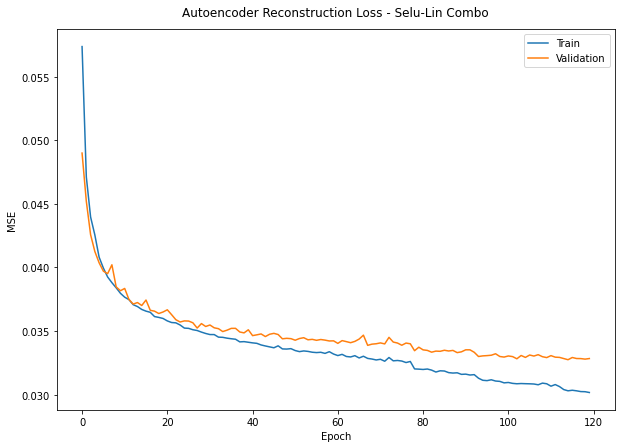

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_selulin.history['loss'], label='Train')
plt.plot(history_selulin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Selu-Lin Combo', pad=13)
plt.legend(loc='upper right')

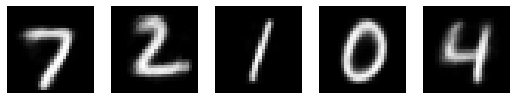

In [ ]:
compressed_images = autoencoder_selulin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

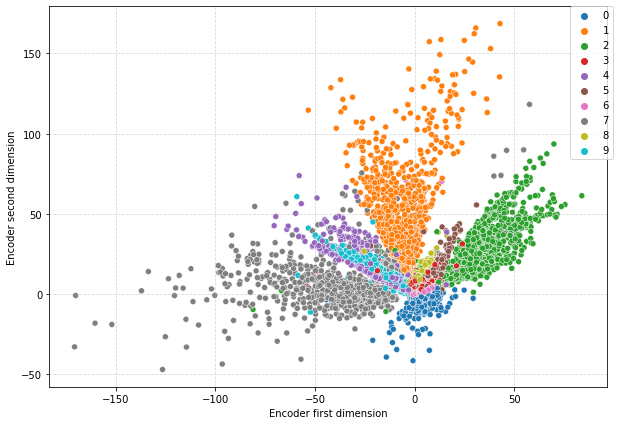

In [ ]:
latent_representation = latent_model_selulin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.7 Hidden: Selu - Latent: Linear + regulatization





In [ ]:
def model_autoencoder(kernel="lecun_normal", l1=0.01):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.selu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.selu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.selu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=l1))(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.selu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.selu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.selu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_selulin_r, latent_model_selulin_r = model_autoencoder(l1=0.001)

# Get summary
autoencoder_selulin_r.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_8 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense_56 (Dense)            (None, 500)               392500    
                                                                 
 tf.nn.selu_24 (TFOpLambda)  (None, 500)               0         
                                                                 
 dense_57 (Dense)            (None, 300)               150300    
                                                                 
 tf.nn.selu_25 (TFOpLambda)  (None, 300)               0         
                                                                 
 dense_58 (Dense)            (None, 100)               30100     
                                                                 
 tf.nn.selu_26 (TFOpLambda)  (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_selulin_r.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_selulin_r = autoencoder_selulin_r.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_selulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/selu_lin_reg/enc/autoencoder')
latent_model_selulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/selu_lin_reg/enc/encoder')

Epoch 1/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0668 - val_loss: 0.0509 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0484 - val_loss: 0.0463 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0453 - val_loss: 0.0442 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0432 - val_loss: 0.0428 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0420 - val_loss: 0.0415 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0411 - val_loss: 0.0412 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0404 - val_loss: 0.0401 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0399 - val_loss: 0.0398 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0395 - val_

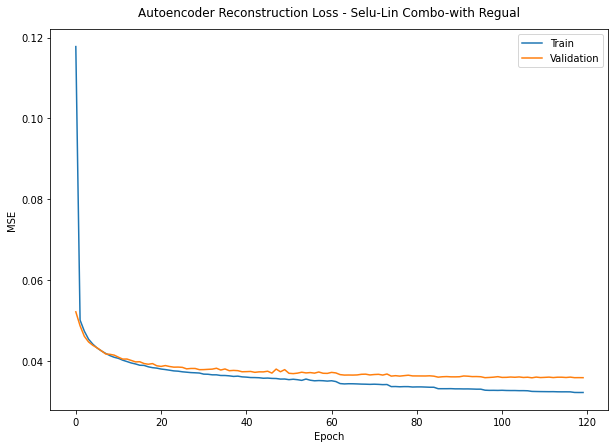

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_selulin.history['loss'], label='Train')
plt.plot(history_selulin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Selu-Lin Combo-with Regual', pad=13)
plt.legend(loc='upper right')

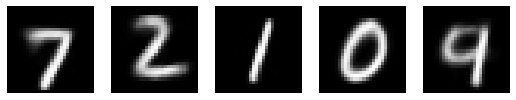

In [ ]:
compressed_images = autoencoder_selulin_r.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

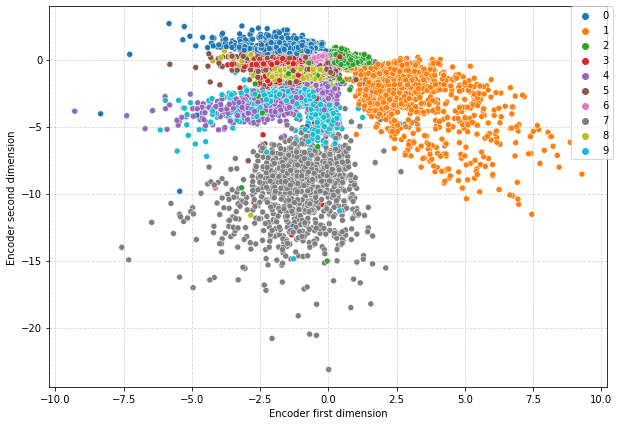

In [ ]:
latent_representation = latent_model_selulin_r.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.5 Hidden: Elu - Latent: Sig

In [ ]:
def model_autoencoder_(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.elu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.elu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.elu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='sigmoid')(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.elu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.elu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.elu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_elusig, latent_model_elusig = model_autoencoder_()

# Get summary
autoencoder_elusig.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_13 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_96 (Dense)            (None, 500)               392500    
                                                                 
 tf.nn.elu_18 (TFOpLambda)   (None, 500)               0         
                                                                 
 dense_97 (Dense)            (None, 300)               150300    
                                                                 
 tf.nn.elu_19 (TFOpLambda)   (None, 300)               0         
                                                                 
 dense_98 (Dense)            (None, 100)               30100     
                                                                 
 tf.nn.elu_20 (TFOpLambda)   (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_elusig.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_elusig = autoencoder_elusig.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_elusig.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_sig/enc/autoencoder')
latent_model_elusig.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_sig/enc/encoder')

Epoch 1/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0666 - val_loss: 0.0586 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0529 - val_loss: 0.0481 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0467 - val_loss: 0.0458 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0448 - val_loss: 0.0444 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0432 - val_loss: 0.0426 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0421 - val_loss: 0.0416 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0412 - val_loss: 0.0410 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0406 - val_loss: 0.0403 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0400 - val_

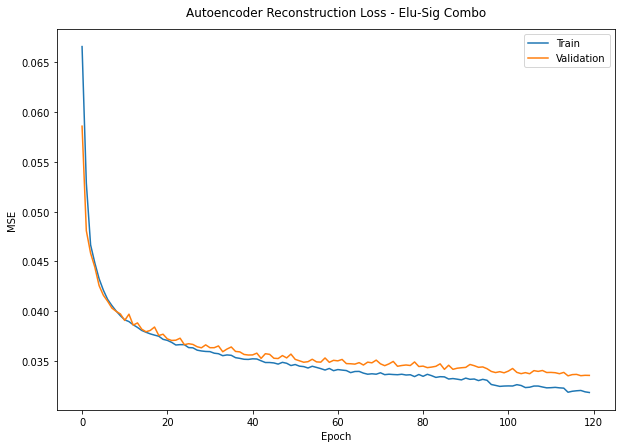

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_elusig.history['loss'], label='Train')
plt.plot(history_elusig.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Elu-Sig Combo', pad=13)
plt.legend(loc='upper right')

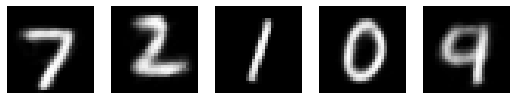

In [ ]:
compressed_images = autoencoder_elusig.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

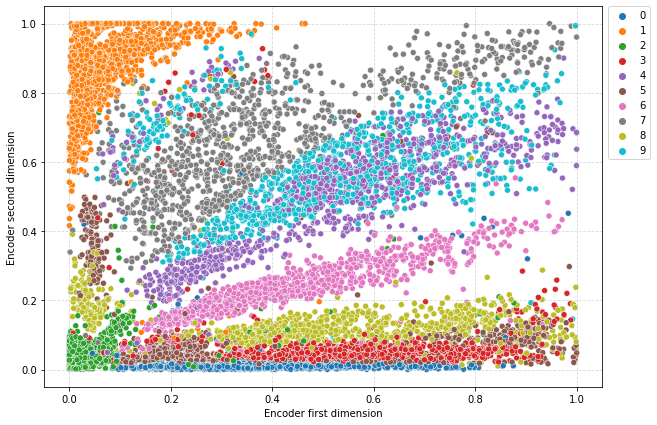

In [ ]:
latent_representation = latent_model_elusig.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.5 Hidden: Elu - Latent: Lin

In [ ]:
def model_autoencoder_(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.elu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.elu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.elu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.elu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.elu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.elu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_elulin, latent_model_elulin = model_autoencoder_()

# Get summary
autoencoder_elulin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_16 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_120 (Dense)           (None, 500)               392500    
                                                                 
 tf.nn.elu_36 (TFOpLambda)   (None, 500)               0         
                                                                 
 dense_121 (Dense)           (None, 300)               150300    
                                                                 
 tf.nn.elu_37 (TFOpLambda)   (None, 300)               0         
                                                                 
 dense_122 (Dense)           (None, 100)               30100     
                                                                 
 tf.nn.elu_38 (TFOpLambda)   (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_elulin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_elulin = autoencoder_elulin.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_elulin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin/enc/autoencoder')
latent_model_elulin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin/enc/encoder')

Epoch 1/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0553 - val_loss: 0.0476 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0453 - val_loss: 0.0439 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0426 - val_loss: 0.0417 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0411 - val_loss: 0.0412 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0400 - val_loss: 0.0401 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0391 - val_loss: 0.0389 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0385 - val_loss: 0.0385 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0380 - val_loss: 0.0384 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0377 - val_

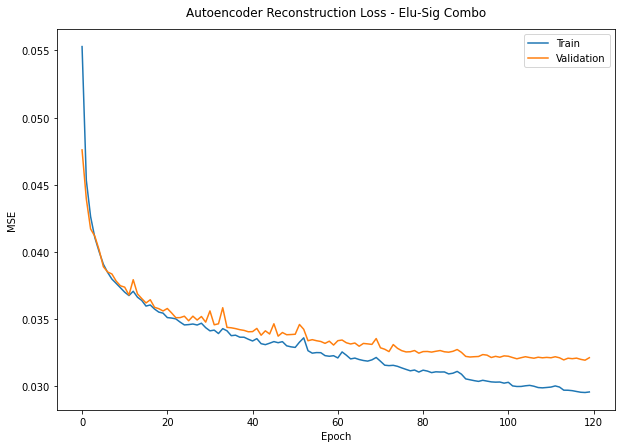

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_elulin.history['loss'], label='Train')
plt.plot(history_elulin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Elu-Sig Combo', pad=13)
plt.legend(loc='upper right')

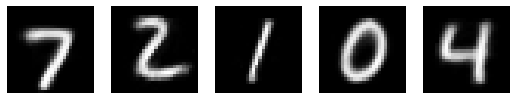

In [ ]:
compressed_images = autoencoder_elulin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

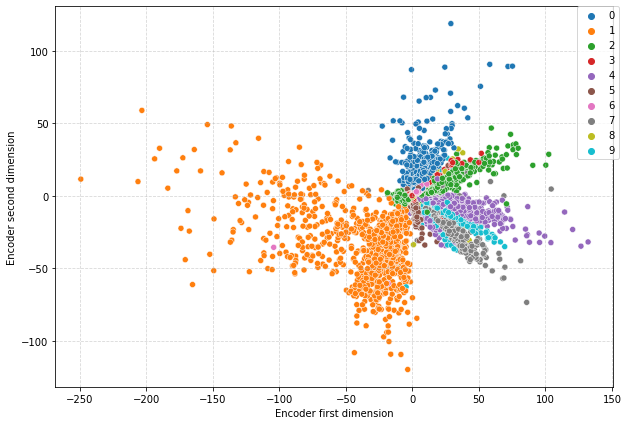

In [ ]:
latent_representation = latent_model_elulin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.6 Hidden: Elu - Latent: Lin + BN

In [ ]:
def model_autoencoder_(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1)
  enc_layer_1 = tf.keras.activations.elu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.elu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.elu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.elu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.elu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.elu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_elulin, latent_model_elulin = model_autoencoder_()

# Get summary
autoencoder_elulin.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_19 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_104 (Dense)           (None, 500)               392500    
                                                                 
 batch_normalization_6 (Batc  (None, 500)              2000      
 hNormalization)                                                 
                                                                 
 tf.nn.elu_17 (TFOpLambda)   (None, 500)               0         
                                                                 
 dense_105 (Dense)           (None, 300)               150300    
                                                                 
 batch_normalization_7 (Batc  (None, 300)              1200      
 hNormalization)                                  

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_elulin.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_elulin = autoencoder_elulin.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_elulin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin_bn/enc/autoencoder')
latent_model_elulin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin_bn/enc/encoder')

Epoch 1/120
394/394 [==============================] - 5s 9ms/step - loss: 0.0542 - val_loss: 0.0461 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0456 - val_loss: 0.0442 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0444 - val_loss: 0.0431 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0436 - val_loss: 0.0429 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0430 - val_loss: 0.0428 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0425 - val_loss: 0.0415 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0420 - val_loss: 0.0412 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0416 - val_loss: 0.0406 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0413 - val_

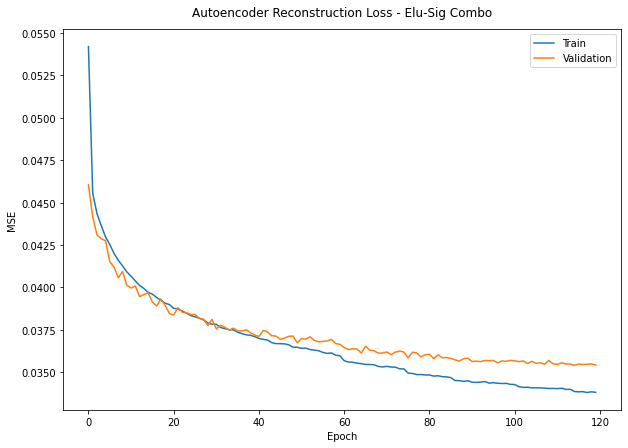

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_elulin.history['loss'], label='Train')
plt.plot(history_elulin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Elu-Sig Combo', pad=13)
plt.legend(loc='upper right')

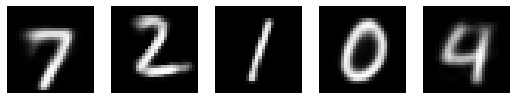

In [ ]:
compressed_images = autoencoder_elulin.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

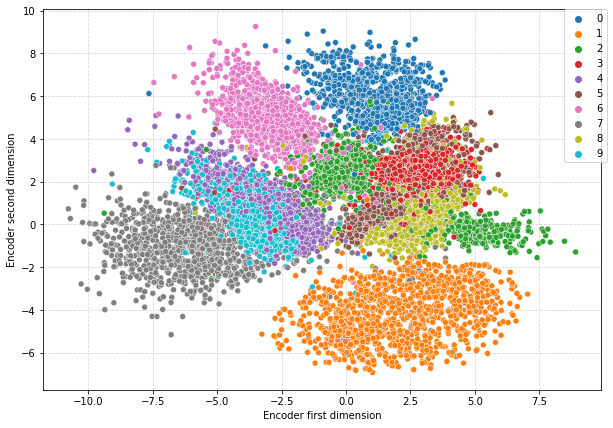

In [ ]:
latent_representation = latent_model_elulin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.7 Hidden: Elu - Latent: Lin + Reg L1

In [ ]:
def model_autoencoder_(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.elu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.elu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.elu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=0.01))(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.elu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.elu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.elu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_elulin_r, latent_model_elulin_r = model_autoencoder_()

# Get summary
autoencoder_elulin_r.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_17 (InputLayer)       [(None, 784)]             0         
                                                                 
 dense_128 (Dense)           (None, 500)               392500    
                                                                 
 tf.nn.elu_42 (TFOpLambda)   (None, 500)               0         
                                                                 
 dense_129 (Dense)           (None, 300)               150300    
                                                                 
 tf.nn.elu_43 (TFOpLambda)   (None, 300)               0         
                                                                 
 dense_130 (Dense)           (None, 100)               30100     
                                                                 
 tf.nn.elu_44 (TFOpLambda)   (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_elulin_r.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_elulin_r = autoencoder_elulin_r.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin/enc/autoencoder')
latent_model_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin/enc/encoder')

Epoch 1/120
394/394 [==============================] - 2s 4ms/step - loss: 0.1114 - val_loss: 0.0516 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0495 - val_loss: 0.0477 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0466 - val_loss: 0.0453 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0445 - val_loss: 0.0435 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0432 - val_loss: 0.0428 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0423 - val_loss: 0.0419 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0416 - val_loss: 0.0419 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 1s 4ms/step - loss: 0.0410 - val_loss: 0.0407 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0405 - val_

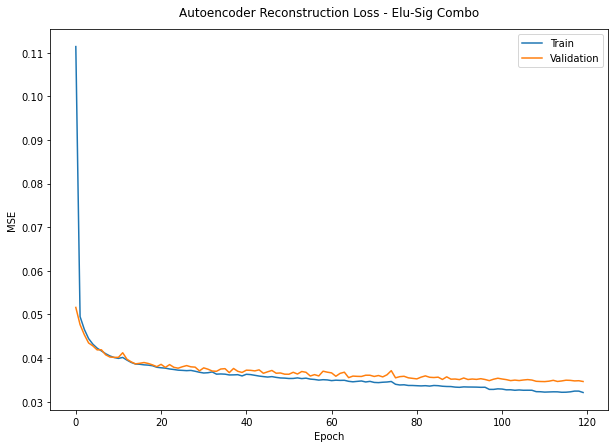

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_elulin_r.history['loss'], label='Train')
plt.plot(history_elulin_r.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Elu-Sig Combo', pad=13)
plt.legend(loc='upper right')

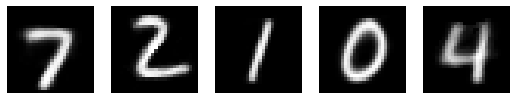

In [ ]:
compressed_images = autoencoder_elulin_r.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

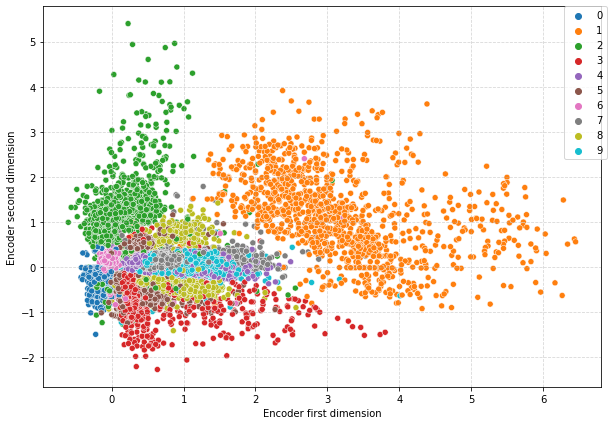

In [ ]:
latent_representation = latent_model_elulin_r.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.8 Hidden: Elu - Latent: Lin + Reg L2

In [ ]:
def model_autoencoder_(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.elu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.elu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.elu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L2(l2=0.01))(enc_layer_3)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.elu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.elu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.elu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_elulin_r, latent_model_elulin_r = model_autoencoder_()

# Get summary
autoencoder_elulin_r.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_6 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense_28 (Dense)            (None, 500)               392500    
                                                                 
 tf.nn.elu_3 (TFOpLambda)    (None, 500)               0         
                                                                 
 dense_29 (Dense)            (None, 300)               150300    
                                                                 
 tf.nn.elu_4 (TFOpLambda)    (None, 300)               0         
                                                                 
 dense_30 (Dense)            (None, 100)               30100     
                                                                 
 tf.nn.elu_5 (TFOpLambda)    (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_elulin_r.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_elulin_r = autoencoder_elulin_r.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin_rl2/enc/autoencoder')
latent_model_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin_rl2/enc/encoder')

Epoch 1/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0646 - val_loss: 0.0490 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0468 - val_loss: 0.0447 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0438 - val_loss: 0.0429 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0421 - val_loss: 0.0416 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0409 - val_loss: 0.0407 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0401 - val_loss: 0.0398 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0393 - val_loss: 0.0392 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0388 - val_loss: 0.0388 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2s 4ms/step - loss: 0.0383 - val_

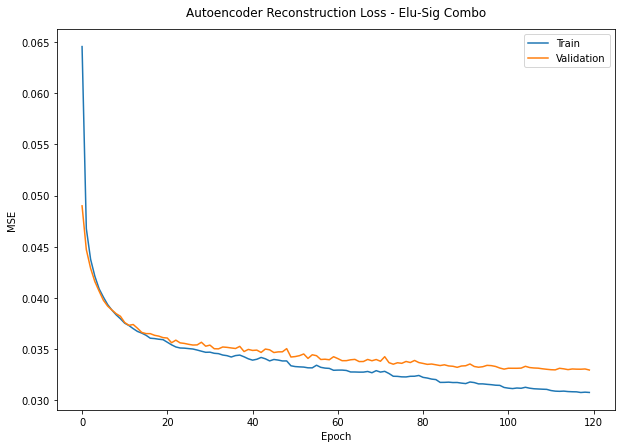

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_elulin_r.history['loss'], label='Train')
plt.plot(history_elulin_r.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Elu-Sig Combo', pad=13)
plt.legend(loc='upper right')

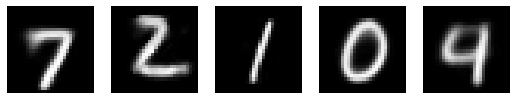

In [ ]:
compressed_images = autoencoder_elulin_r.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

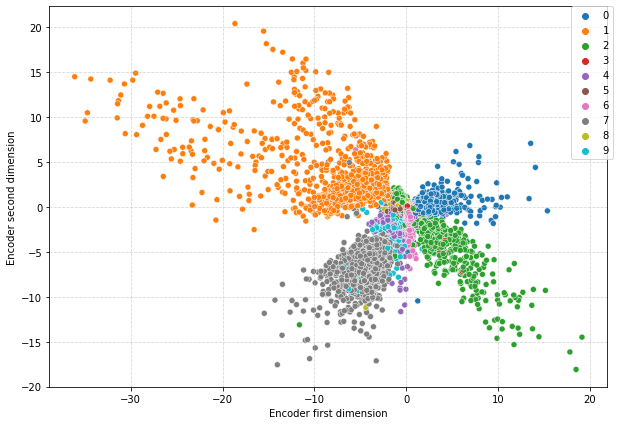

In [ ]:
latent_representation = latent_model_elulin_r.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.9 Hidden: Gelu - Latent: Lin

In [ ]:
def model_autoencoder_(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.gelu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.gelu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.gelu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', )(enc_layer_3) #kernel_regularizer = tf.keras.regularizers.L2(l2=0.01)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.gelu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.gelu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.gelu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='linear')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_elulin_r, latent_model_elulin_r = model_autoencoder_()

# Get summary
autoencoder_elulin_r.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense (Dense)               (None, 500)               392500    
                                                                 
 tf.nn.gelu (TFOpLambda)     (None, 500)               0         
                                                                 
 dense_1 (Dense)             (None, 300)               150300    
                                                                 
 tf.nn.gelu_1 (TFOpLambda)   (None, 300)               0         
                                                                 
 dense_2 (Dense)             (None, 100)               30100     
                                                                 
 tf.nn.gelu_2 (TFOpLambda)   (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_elulin_r.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_elulin_r = autoencoder_elulin_r.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin/enc/autoencoder')
latent_model_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 5ms/step - loss: 0.0548 - val_loss: 0.0470 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0447 - val_loss: 0.0429 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0416 - val_loss: 0.0407 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0399 - val_loss: 0.0393 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0388 - val_loss: 0.0385 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0381 - val_loss: 0.0380 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0375 - val_loss: 0.0374 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0370 - val_loss: 0.0374 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0366 - val_

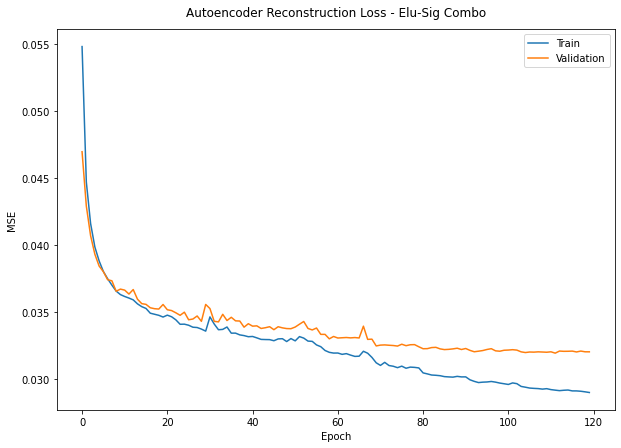

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_elulin_r.history['loss'], label='Train')
plt.plot(history_elulin_r.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Elu-Sig Combo', pad=13)
plt.legend(loc='upper right')

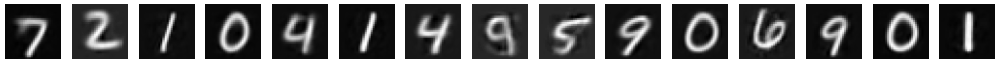

In [ ]:
compressed_images = autoencoder_elulin_r.predict(test_images)
n = 15
plt.figure(figsize=(26, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

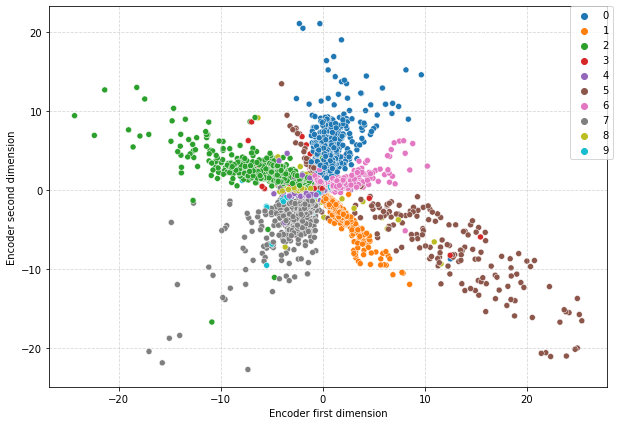

In [ ]:
latent_representation = latent_model_elulin_r.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.10 Hidden: Gelu - Latent: Tanh

In [ ]:
def model_autoencoder_(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.gelu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.gelu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.gelu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='tanh', )(enc_layer_3) #kernel_regularizer = tf.keras.regularizers.L2(l2=0.01)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.gelu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.gelu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.gelu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='linear')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_elulin_r, latent_model_elulin_r = model_autoencoder_()

# Get summary
autoencoder_elulin_r.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense_8 (Dense)             (None, 500)               392500    
                                                                 
 tf.nn.gelu_6 (TFOpLambda)   (None, 500)               0         
                                                                 
 dense_9 (Dense)             (None, 300)               150300    
                                                                 
 tf.nn.gelu_7 (TFOpLambda)   (None, 300)               0         
                                                                 
 dense_10 (Dense)            (None, 100)               30100     
                                                                 
 tf.nn.gelu_8 (TFOpLambda)   (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_elulin_r.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_elulin_r = autoencoder_elulin_r.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_tahn/enc/autoencoder')
latent_model_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_tahn/enc/encoder')

Epoch 1/120
394/394 [==============================] - 3s 5ms/step - loss: 0.0541 - val_loss: 0.0468 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0446 - val_loss: 0.0428 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0416 - val_loss: 0.0405 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0399 - val_loss: 0.0395 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0389 - val_loss: 0.0385 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0381 - val_loss: 0.0381 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0375 - val_loss: 0.0374 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0371 - val_loss: 0.0374 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0367 - val_

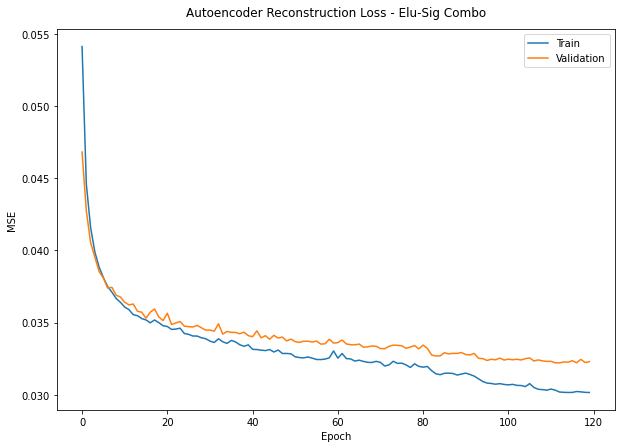

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_elulin_r.history['loss'], label='Train')
plt.plot(history_elulin_r.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Elu-Sig Combo', pad=13)
plt.legend(loc='upper right')

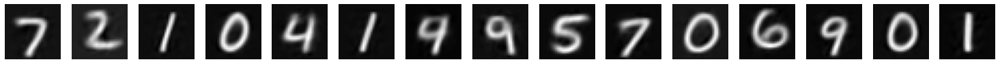

In [ ]:
compressed_images = autoencoder_elulin_r.predict(test_images)
n = 15
plt.figure(figsize=(26, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

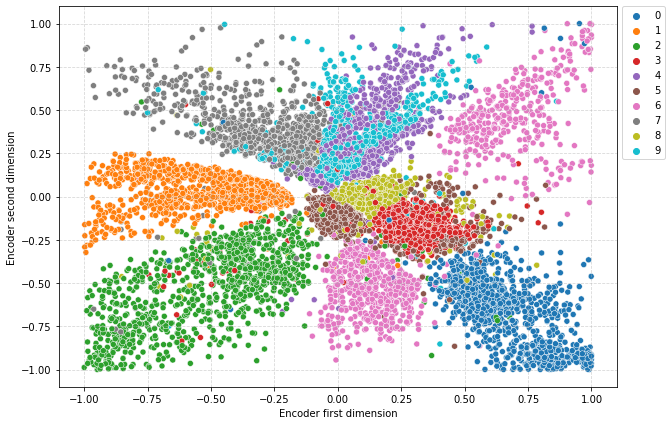

In [ ]:
latent_representation = latent_model_elulin_r.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

#### 4.11 Hidden: Gelu - Latent: Lin - L1 Reg

In [ ]:
def model_autoencoder_(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.activations.gelu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.activations.gelu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.activations.gelu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=0.01))(enc_layer_3) #kernel_regularizer = tf.keras.regularizers.L2(l2=0.01)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.activations.gelu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.activations.gelu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.activations.gelu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='linear')(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder = Model(input_layer, decoder, name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder, latent_model

In [ ]:
autoencoder_elulin_r, latent_model_elulin_r = model_autoencoder_()

# Get summary
autoencoder_elulin_r.summary()

Model: "Deep_Autoencoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 784)]             0         
                                                                 
 dense_16 (Dense)            (None, 500)               392500    
                                                                 
 tf.nn.gelu_12 (TFOpLambda)  (None, 500)               0         
                                                                 
 dense_17 (Dense)            (None, 300)               150300    
                                                                 
 tf.nn.gelu_13 (TFOpLambda)  (None, 300)               0         
                                                                 
 dense_18 (Dense)            (None, 100)               30100     
                                                                 
 tf.nn.gelu_14 (TFOpLambda)  (None, 100)          

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss = 'mse'
autoencoder_elulin_r.compile(loss=loss, optimizer=optimizer)

# Train the autoencoder with MNIST data
history_elulin_r = autoencoder_elulin_r.fit(X_t, X_t, epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, X_v))

autoencoder_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin_l1/enc/autoencoder')
latent_model_elulin_r.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin_l1/enc/encoder')

Epoch 1/120
394/394 [==============================] - 3s 5ms/step - loss: 0.1190 - val_loss: 0.0514 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0485 - val_loss: 0.0463 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0449 - val_loss: 0.0438 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0428 - val_loss: 0.0423 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0416 - val_loss: 0.0412 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0405 - val_loss: 0.0406 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0399 - val_loss: 0.0401 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0393 - val_loss: 0.0394 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0389 - val_

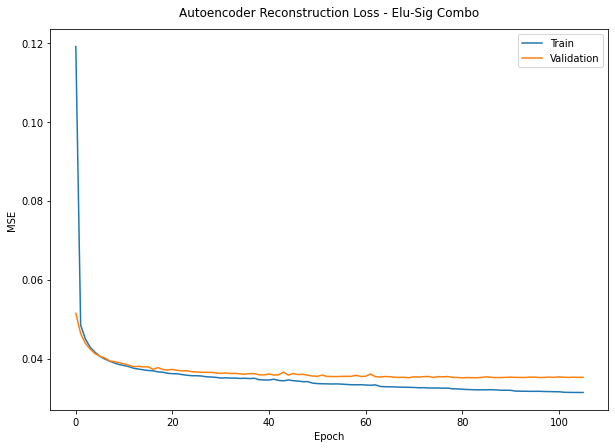

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_elulin_r.history['loss'], label='Train')
plt.plot(history_elulin_r.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Elu-Sig Combo', pad=13)
plt.legend(loc='upper right')

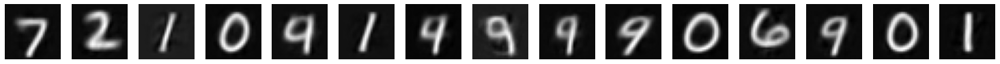

In [ ]:
compressed_images = autoencoder_elulin_r.predict(test_images)
n = 15
plt.figure(figsize=(26, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

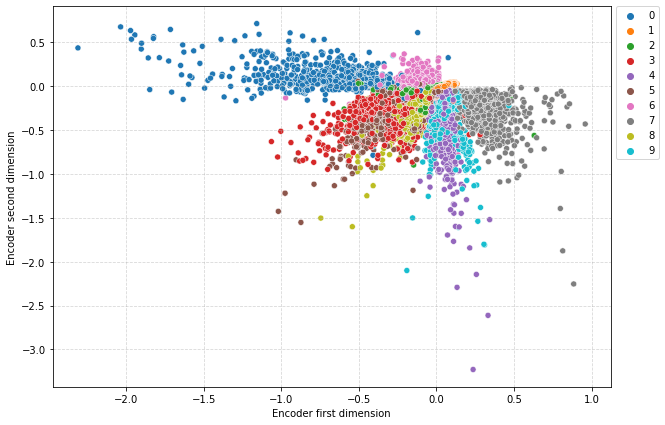

In [ ]:
latent_representation = latent_model_elulin_r.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 4.0 Variational Autoencoders Relu-Activation:

In [ ]:
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

In [ ]:
input_dim = 28*28
latent_vec_dim = 2

input_layer = Input(shape=(input_dim,))

# Define the autoencoder architecture
# First build the encoder
enc_layer_1 = Dense(500, activation='relu')(input_layer)
enc_layer_2 = Dense(300, activation='relu')(enc_layer_1)
enc_layer_3 = Dense(100, activation='relu')(enc_layer_2)
enc_layer_4 = Dense(32, activation='relu')(enc_layer_3)
z_mean = layers.Dense(latent_vec_dim, name="z_mean")(enc_layer_4)
z_log_var = layers.Dense(latent_vec_dim, name="z_log_var")(enc_layer_4)
z = Sampling()([z_mean, z_log_var])
encoder = keras.Model(input_layer, [z_mean, z_log_var, z], name="encoder")
encoder.summary()


Model: "encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense_16 (Dense)               (None, 500)          392500      ['input_3[0][0]']                
                                                                                                  
 dense_17 (Dense)               (None, 300)          150300      ['dense_16[0][0]']               
                                                                                                  
 dense_18 (Dense)               (None, 100)          30100       ['dense_17[0][0]']               
                                                                                            

In [ ]:
# Then build the decoder
latent_inputs = keras.Input(shape=(latent_vec_dim,))
dec_layer_0 = Dense(32, activation='relu')(latent_inputs)
dec_layer_1 = Dense(100, activation='relu')(dec_layer_0)
dec_layer_2 = Dense(300, activation='relu')(dec_layer_1)
dec_layer_3 = Dense(500, activation='relu')(dec_layer_2)
dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)

decoder = keras.Model(latent_inputs, dec_layer_4, name="decoder")
decoder.summary()

Model: "decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_4 (InputLayer)        [(None, 2)]               0         
                                                                 
 dense_20 (Dense)            (None, 32)                96        
                                                                 
 dense_21 (Dense)            (None, 100)               3300      
                                                                 
 dense_22 (Dense)            (None, 300)               30300     
                                                                 
 dense_23 (Dense)            (None, 500)               150500    
                                                                 
 dense_24 (Dense)            (None, 784)               392784    
                                                                 
Total params: 576,980
Trainable params: 576,980
Non-trainab

In [ ]:
# instantiate VAE model
outputs = decoder(encoder(input_layer)[2])
vae = keras.Model(input_layer, outputs, name='vae_mlp')

What we've done so far allows us to instantiate 3 models:

* an end-to-end autoencoder mapping inputs to reconstructions
* an encoder mapping inputs to the latent space
* a generator that can take points on the latent space and will output the corresponding reconstructed samples.

We train the model using the end-to-end model, with a custom loss function: the sum of a reconstruction term, and the KL divergence regularization term.

In [ ]:
reconstruction_loss = keras.losses.binary_crossentropy(input_layer, outputs)
reconstruction_loss *= input_dim
kl_loss = 1 + z_log_var - K.square(z_mean) - K.exp(z_log_var)
kl_loss = K.sum(kl_loss, axis=-1)
kl_loss *= -0.5
vae_loss = K.mean(reconstruction_loss + kl_loss)
vae.add_loss(vae_loss)
vae.compile(optimizer='adam')

In [ ]:
history_vae = vae.fit(X_t, X_t,
                      epochs=120,
                      batch_size=128,
                      callbacks = [early_stop, Checkpoint, lr],
                      shuffle=True,
                      validation_data=(X_v, X_v))

Epoch 1/120
394/394 [==============================] - 4s 7ms/step - loss: 193.2681 - val_loss: 170.3724 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 6ms/step - loss: 164.6191 - val_loss: 159.9635 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 6ms/step - loss: 157.1662 - val_loss: 154.6475 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 6ms/step - loss: 152.9587 - val_loss: 150.7514 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 6ms/step - loss: 149.9528 - val_loss: 149.2454 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 6ms/step - loss: 148.2898 - val_loss: 146.8797 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 6ms/step - loss: 146.4773 - val_loss: 146.1175 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 6ms/step - loss: 145.2527 - val_loss: 145.1765 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2

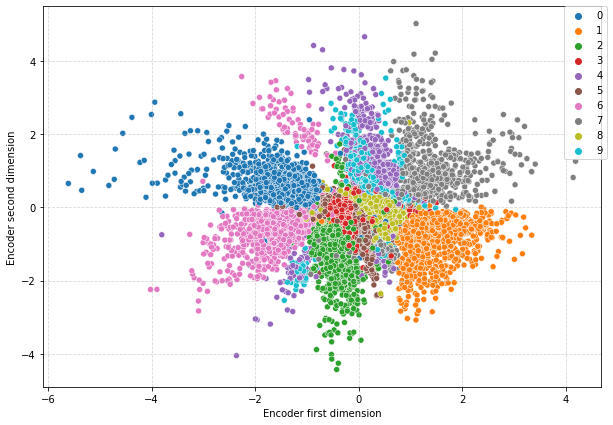

In [ ]:
latent_representation = encoder.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[2][:,0],
                y=latent_representation[2][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

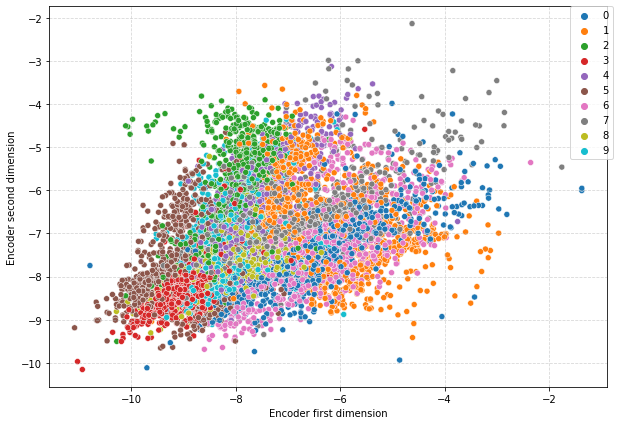

In [ ]:
plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[1][:,0],
                y=latent_representation[1][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

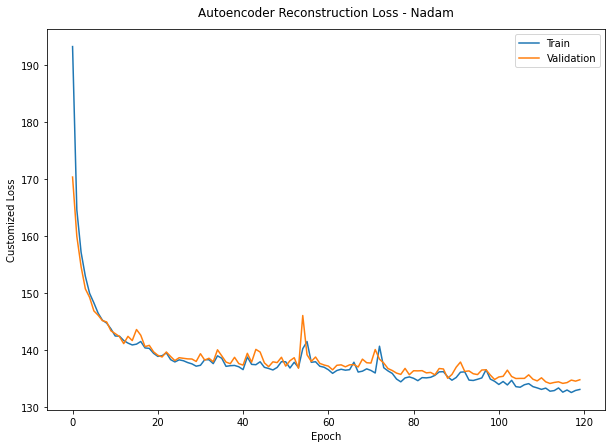

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_vae.history['loss'], label='Train')
plt.plot(history_vae.history['val_loss'], label='Validation')
plt.ylabel('Customized Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam', pad=13)
plt.legend(loc='upper right')

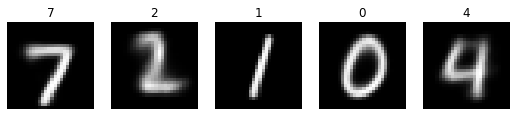

In [ ]:
compressed_images = vae.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")

  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

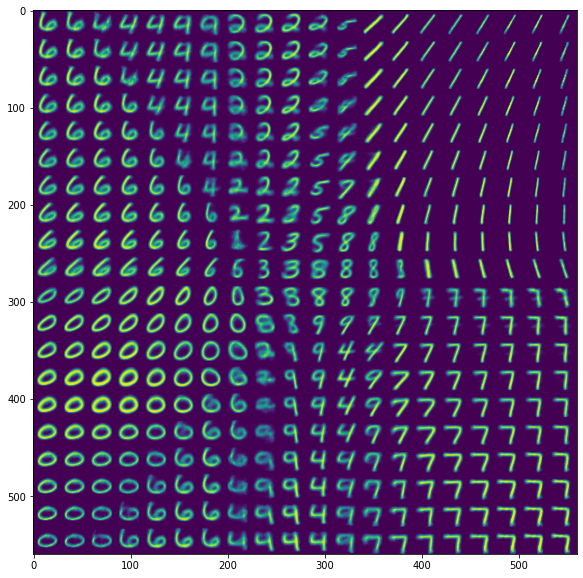

In [ ]:
# Display a 2D manifold of the digits
n = 20  # figure with 15x15 digits
digit_size = 28
figure = np.zeros((digit_size * n, digit_size * n))
# We will sample n points within [-15, 15] standard deviations
grid_x = np.linspace(-3, 3, n)
grid_y = np.linspace(-3, 3, n)

for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
        z_sample = np.array([[xi, yi]])
        x_decoded = decoder.predict(z_sample)
        digit = x_decoded[0].reshape(digit_size, digit_size)
        figure[i * digit_size: (i + 1) * digit_size,
               j * digit_size: (j + 1) * digit_size] = digit

plt.figure(figsize=(10, 10))
plt.imshow(figure)
plt.show()

In [ ]:
vae.save(f'/content/drive/MyDrive/Exercises/Autoencoders/vae/autoencoder')
encoder.save(f'/content/drive/MyDrive/Exercises/Autoencoders/vae/encoder')

## 5.0 Variational Autoencoders Prelu-Activation:

In [ ]:
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

In [ ]:
input_dim = 28*28
latent_vec_dim = 2

input_layer = Input(shape=(input_dim,))

# Define the autoencoder architecture
# First build the encoder
enc_layer_1 = Dense(500, kernel_initializer='he_normal')(input_layer)
enc_layer_1 = tf.keras.layers.PReLU()(enc_layer_1)

enc_layer_2 = Dense(300, kernel_initializer='he_normal')(enc_layer_1)
enc_layer_2 = tf.keras.layers.PReLU()(enc_layer_2)

enc_layer_3 = Dense(100, kernel_initializer='he_normal')(enc_layer_2)
enc_layer_3 = tf.keras.layers.PReLU()(enc_layer_3)

enc_layer_4 = Dense(32, kernel_initializer='he_normal')(enc_layer_3)
enc_layer_4 = tf.keras.layers.PReLU()(enc_layer_4)

z_mean = layers.Dense(latent_vec_dim, name="z_mean")(enc_layer_4)
z_log_var = layers.Dense(latent_vec_dim, name="z_log_var")(enc_layer_4)
z = Sampling()([z_mean, z_log_var])
encoder = keras.Model(input_layer, [z_mean, z_log_var, z], name="encoder")
encoder.summary()


Model: "encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_11 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_54 (Dense)               (None, 500)          392500      ['input_11[0][0]']               
                                                                                                  
 p_re_lu (PReLU)                (None, 500)          500         ['dense_54[0][0]']               
                                                                                                  
 dense_55 (Dense)               (None, 300)          150300      ['p_re_lu[0][0]']                
                                                                                            

In [ ]:
# Then build the decoder
latent_inputs = keras.Input(shape=(latent_vec_dim,))

dec_layer_0 = Dense(32, kernel_initializer='he_normal')(latent_inputs)
dec_layer_0 = tf.keras.layers.PReLU()(dec_layer_0)

dec_layer_1 = Dense(100, kernel_initializer='he_normal')(dec_layer_0)
dec_layer_1 = tf.keras.layers.PReLU()(dec_layer_1)


dec_layer_2 = Dense(300, kernel_initializer='he_normal')(dec_layer_1)
dec_layer_2 = tf.keras.layers.PReLU()(dec_layer_2)

dec_layer_3 = Dense(500, kernel_initializer='he_normal')(dec_layer_2)
dec_layer_3 = tf.keras.layers.PReLU()(dec_layer_3)

dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)

decoder = keras.Model(latent_inputs, dec_layer_4, name="decoder")
decoder.summary()

Model: "decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_12 (InputLayer)       [(None, 2)]               0         
                                                                 
 dense_58 (Dense)            (None, 32)                96        
                                                                 
 p_re_lu_4 (PReLU)           (None, 32)                32        
                                                                 
 dense_59 (Dense)            (None, 100)               3300      
                                                                 
 p_re_lu_5 (PReLU)           (None, 100)               100       
                                                                 
 dense_60 (Dense)            (None, 300)               30300     
                                                                 
 p_re_lu_6 (PReLU)           (None, 300)               300 

In [ ]:
# instantiate VAE model
outputs = decoder(encoder(input_layer)[2])
vae = keras.Model(input_layer, outputs, name='vae_mlp')

What we've done so far allows us to instantiate 3 models:

* an end-to-end autoencoder mapping inputs to reconstructions
* an encoder mapping inputs to the latent space
* a generator that can take points on the latent space and will output the corresponding reconstructed samples.

We train the model using the end-to-end model, with a custom loss function: the sum of a reconstruction term, and the KL divergence regularization term.

In [ ]:
reconstruction_loss = keras.losses.binary_crossentropy(input_layer, outputs)
reconstruction_loss *= input_dim
kl_loss = 1 + z_log_var - K.square(z_mean) - K.exp(z_log_var)
kl_loss = K.sum(kl_loss, axis=-1)
kl_loss *= -0.5
vae_loss = K.mean(reconstruction_loss + kl_loss)
vae.add_loss(vae_loss)
vae.compile(optimizer='adam')

In [ ]:
history_vae = vae.fit(X_t, X_t,
                      epochs=120,
                      batch_size=128,
                      callbacks = [early_stop, Checkpoint, lr],
                      shuffle=True,
                      validation_data=(X_v, X_v))

Epoch 1/120
394/394 [==============================] - 5s 8ms/step - loss: 184.7888 - val_loss: 162.6150 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 3s 7ms/step - loss: 156.9168 - val_loss: 152.2403 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 3s 7ms/step - loss: 151.0356 - val_loss: 149.3441 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 7ms/step - loss: 148.6270 - val_loss: 147.3758 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 3s 7ms/step - loss: 146.3035 - val_loss: 146.2085 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 3s 8ms/step - loss: 144.9240 - val_loss: 145.3967 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 3s 8ms/step - loss: 143.9175 - val_loss: 143.7155 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 3s 7ms/step - loss: 143.0696 - val_loss: 142.9008 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 3

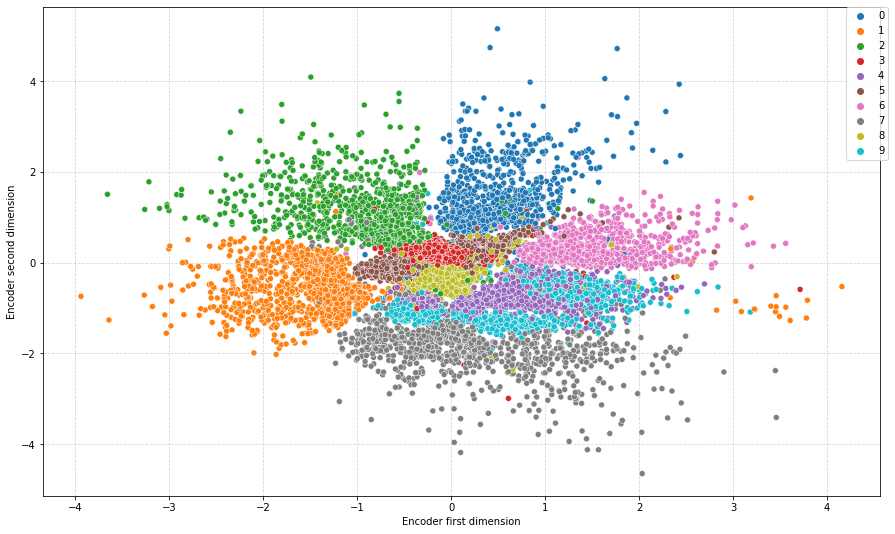

In [ ]:
latent_representation = encoder.predict(test_images)

plt.figure(figsize=(15, 9))

sns.scatterplot(x=latent_representation[2][:,0],
                y=latent_representation[2][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

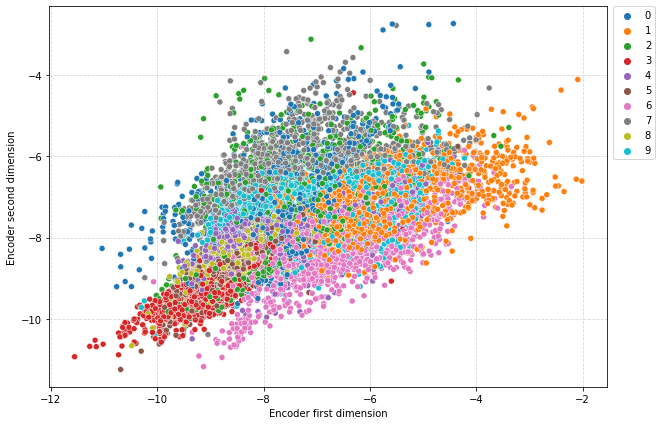

In [ ]:
plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[1][:,0],
                y=latent_representation[1][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

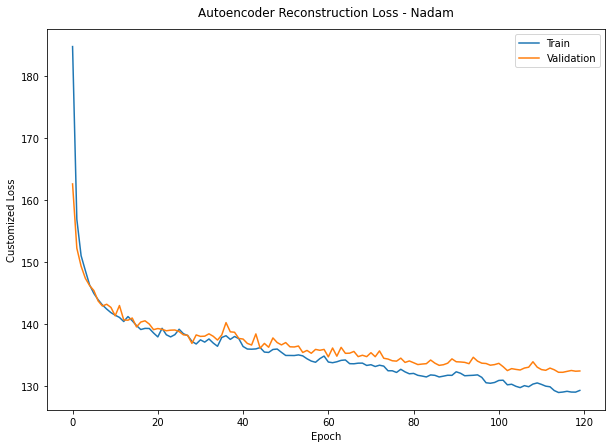

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_vae.history['loss'], label='Train')
plt.plot(history_vae.history['val_loss'], label='Validation')
plt.ylabel('Customized Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam', pad=13)
plt.legend(loc='upper right')

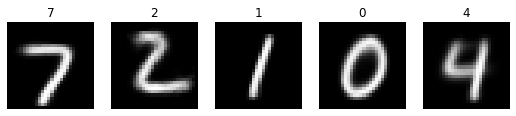

In [ ]:
compressed_images = vae.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")

  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

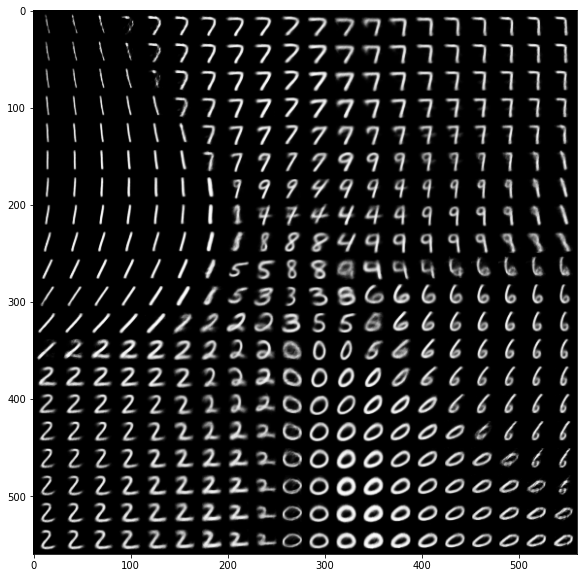

In [ ]:
# Display a 2D manifold of the digits
n = 20  # figure with 15x15 digits
digit_size = 28
figure = np.zeros((digit_size * n, digit_size * n))
# We will sample n points within [-15, 15] standard deviations
grid_x = np.linspace(-3, 3, n)
grid_y = np.linspace(-3, 3, n)

for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
        z_sample = np.array([[xi, yi]])
        x_decoded = decoder.predict(z_sample)
        digit = x_decoded[0].reshape(digit_size, digit_size)
        figure[i * digit_size: (i + 1) * digit_size,
               j * digit_size: (j + 1) * digit_size] = digit

plt.figure(figsize=(10, 10))
plt.imshow(figure, cmap="gray")
plt.show()

In [ ]:
vae.save(f'/content/drive/MyDrive/Exercises/Autoencoders/vae_prelu/autoencoder')
encoder.save(f'/content/drive/MyDrive/Exercises/Autoencoders/vae_prelu/encoder')

## 6.0 Variational Autoencoders Elu-Activation:

In [ ]:
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

In [ ]:
input_dim = 28*28
latent_vec_dim = 2

input_layer = Input(shape=(input_dim,))

# Define the autoencoder architecture
# First build the encoder
enc_layer_1 = Dense(500, kernel_initializer='he_normal')(input_layer)
enc_layer_1 = tf.keras.activations.elu(enc_layer_1)

enc_layer_2 = Dense(300, kernel_initializer='he_normal')(enc_layer_1)
enc_layer_2 = tf.keras.activations.elu(enc_layer_2)

enc_layer_3 = Dense(100, kernel_initializer='he_normal')(enc_layer_2)
enc_layer_3 = tf.keras.activations.elu(enc_layer_3)

enc_layer_4 = Dense(32, kernel_initializer='he_normal')(enc_layer_3)
enc_layer_4 = tf.keras.activations.elu(enc_layer_4)

z_mean = layers.Dense(latent_vec_dim, name="z_mean")(enc_layer_4)
z_log_var = layers.Dense(latent_vec_dim, name="z_log_var")(enc_layer_4)
z = Sampling()([z_mean, z_log_var])
encoder = keras.Model(input_layer, [z_mean, z_log_var, z], name="encoder")
encoder.summary()


Model: "encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_13 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_63 (Dense)               (None, 500)          392500      ['input_13[0][0]']               
                                                                                                  
 tf.nn.elu_9 (TFOpLambda)       (None, 500)          0           ['dense_63[0][0]']               
                                                                                                  
 dense_64 (Dense)               (None, 300)          150300      ['tf.nn.elu_9[0][0]']            
                                                                                            

In [ ]:
# Then build the decoder
latent_inputs = keras.Input(shape=(latent_vec_dim,))

dec_layer_0 = Dense(32, kernel_initializer='he_normal')(latent_inputs)
dec_layer_0 = tf.keras.activations.elu(dec_layer_0)

dec_layer_1 = Dense(100, kernel_initializer='he_normal')(dec_layer_0)
dec_layer_1 = tf.keras.activations.elu(dec_layer_1)


dec_layer_2 = Dense(300, kernel_initializer='he_normal')(dec_layer_1)
dec_layer_2 = tf.keras.activations.elu(dec_layer_2)

dec_layer_3 = Dense(500, kernel_initializer='he_normal')(dec_layer_2)
dec_layer_3 = tf.keras.activations.elu(dec_layer_3)

dec_layer_4 = Dense(input_dim, activation='sigmoid')(dec_layer_3)

decoder = keras.Model(latent_inputs, dec_layer_4, name="decoder")
decoder.summary()

Model: "decoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_14 (InputLayer)       [(None, 2)]               0         
                                                                 
 dense_67 (Dense)            (None, 32)                96        
                                                                 
 tf.nn.elu_13 (TFOpLambda)   (None, 32)                0         
                                                                 
 dense_68 (Dense)            (None, 100)               3300      
                                                                 
 tf.nn.elu_14 (TFOpLambda)   (None, 100)               0         
                                                                 
 dense_69 (Dense)            (None, 300)               30300     
                                                                 
 tf.nn.elu_15 (TFOpLambda)   (None, 300)               0   

In [ ]:
# instantiate VAE model
outputs = decoder(encoder(input_layer)[2])
vae = keras.Model(input_layer, outputs, name='vae_mlp')

What we've done so far allows us to instantiate 3 models:

* an end-to-end autoencoder mapping inputs to reconstructions
* an encoder mapping inputs to the latent space
* a generator that can take points on the latent space and will output the corresponding reconstructed samples.

We train the model using the end-to-end model, with a custom loss function: the sum of a reconstruction term, and the KL divergence regularization term.

In [ ]:
reconstruction_loss = keras.losses.binary_crossentropy(input_layer, outputs)
reconstruction_loss *= input_dim
kl_loss = 1 + z_log_var - K.square(z_mean) - K.exp(z_log_var)
kl_loss = K.sum(kl_loss, axis=-1)
kl_loss *= -0.5
vae_loss = K.mean(reconstruction_loss + kl_loss)
vae.add_loss(vae_loss)
vae.compile(optimizer='adam')

In [ ]:
history_vae = vae.fit(X_t, X_t,
                      epochs=120,
                      batch_size=128,
                      callbacks = [early_stop, Checkpoint, lr],
                      shuffle=True,
                      validation_data=(X_v, X_v))

Epoch 1/120
394/394 [==============================] - 3s 7ms/step - loss: 183.9652 - val_loss: 173.7935 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 6ms/step - loss: 163.1258 - val_loss: 158.6214 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 6ms/step - loss: 154.8391 - val_loss: 152.9492 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 6ms/step - loss: 151.1741 - val_loss: 150.0251 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 6ms/step - loss: 148.6520 - val_loss: 147.7269 - lr: 0.0010
Epoch 6/120
394/394 [==============================] - 2s 6ms/step - loss: 146.8576 - val_loss: 146.5367 - lr: 0.0010
Epoch 7/120
394/394 [==============================] - 2s 6ms/step - loss: 145.7271 - val_loss: 145.3893 - lr: 0.0010
Epoch 8/120
394/394 [==============================] - 2s 6ms/step - loss: 144.6410 - val_loss: 144.6632 - lr: 0.0010
Epoch 9/120
394/394 [==============================] - 2

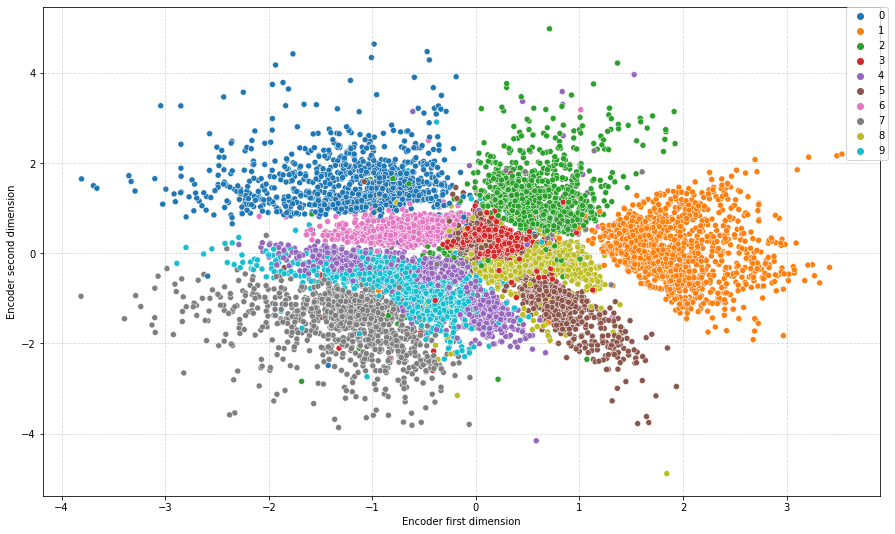

In [ ]:
latent_representation = encoder.predict(test_images)

plt.figure(figsize=(15, 9))

sns.scatterplot(x=latent_representation[2][:,0],
                y=latent_representation[2][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

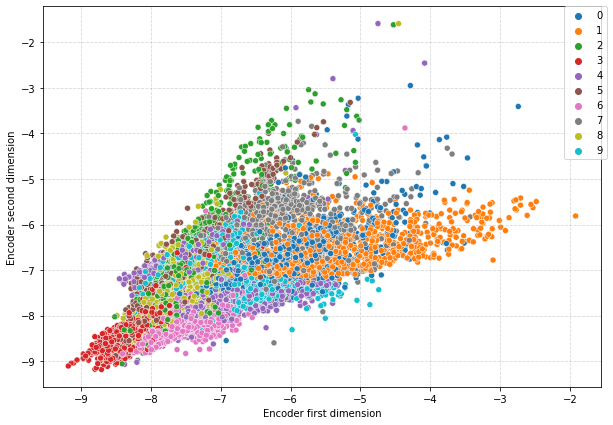

In [ ]:
plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[1][:,0],
                y=latent_representation[1][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

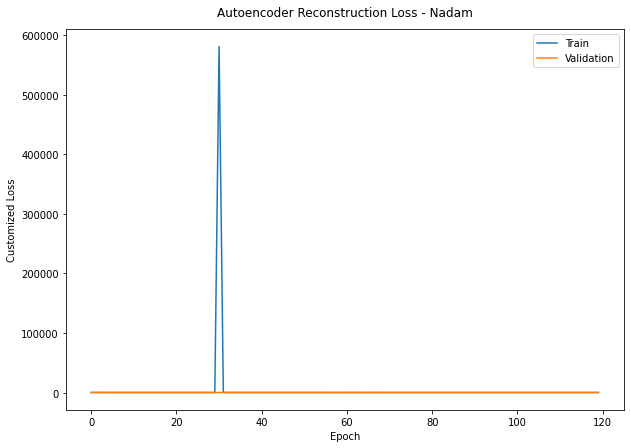

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_vae.history['loss'], label='Train')
plt.plot(history_vae.history['val_loss'], label='Validation')
plt.ylabel('Customized Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam', pad=13)
plt.legend(loc='upper right')

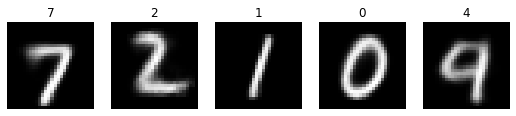

In [ ]:
compressed_images = vae.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")

  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

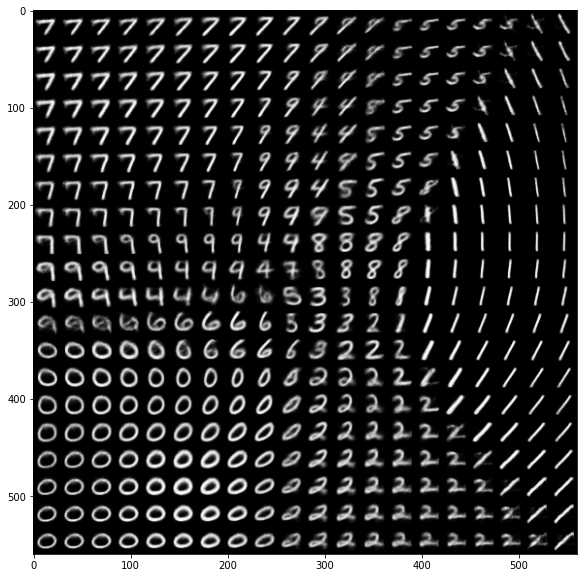

In [ ]:
# Display a 2D manifold of the digits
n = 20  # figure with 15x15 digits
digit_size = 28
figure = np.zeros((digit_size * n, digit_size * n))
# We will sample n points within [-15, 15] standard deviations
grid_x = np.linspace(-3, 3, n)
grid_y = np.linspace(-3, 3, n)

for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
        z_sample = np.array([[xi, yi]])
        x_decoded = decoder.predict(z_sample)
        digit = x_decoded[0].reshape(digit_size, digit_size)
        figure[i * digit_size: (i + 1) * digit_size,
               j * digit_size: (j + 1) * digit_size] = digit

plt.figure(figsize=(10, 10))
plt.imshow(figure, cmap="gray")
plt.show()

In [ ]:
vae.save(f'/content/drive/MyDrive/Exercises/Autoencoders/vae_elu/autoencoder')
encoder.save(f'/content/drive/MyDrive/Exercises/Autoencoders/vae_elu/encoder')

## 7.0 Hidden Layers: PRelu - Latent Space: Linear + BatchNorm: MULTIPLE OUTPUT

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400, 10) (9600, 10) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1)
  enc_layer_1 = tf.keras.layers.PReLU()(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.layers.PReLU()(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.layers.PReLU()(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3)

  output_1 = Dense(10, activation='softmax', name="Class Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.layers.PReLU()(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.layers.PReLU()(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.layers.PReLU()(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric. Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_20 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_112 (Dense)              (None, 500)          392500      ['input_20[0][0]']               
                                                                                                  
 batch_normalization_12 (BatchN  (None, 500)         2000        ['dense_112[0][0]']              
 ormalization)                                                                                    
                                                                                                  
 p_re_lu_32 (PReLU)             (None, 500)          500         ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#
autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_bn_mo/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_bn_mo/enc/encoder')

Epoch 1/120
394/394 [==============================] - 7s 11ms/step - loss: 0.2418 - dense_120_loss: 0.0564 - dense_116_loss: 0.7979 - val_loss: 0.1636 - val_dense_120_loss: 0.0548 - val_dense_116_loss: 0.4901 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 4s 10ms/step - loss: 0.1271 - dense_120_loss: 0.0526 - dense_116_loss: 0.3506 - val_loss: 0.1245 - val_dense_120_loss: 0.0538 - val_dense_116_loss: 0.3364 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 4s 10ms/step - loss: 0.0886 - dense_120_loss: 0.0520 - dense_116_loss: 0.1984 - val_loss: 0.1040 - val_dense_120_loss: 0.0518 - val_dense_116_loss: 0.2605 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 4s 10ms/step - loss: 0.0721 - dense_120_loss: 0.0515 - dense_116_loss: 0.1338 - val_loss: 0.0966 - val_dense_120_loss: 0.0511 - val_dense_116_loss: 0.2329 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 4s 10ms/step - loss: 0.0642 - dense_120_loss: 0.0504 

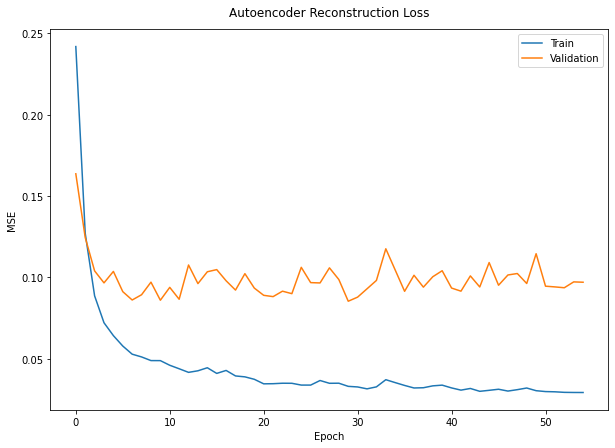

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

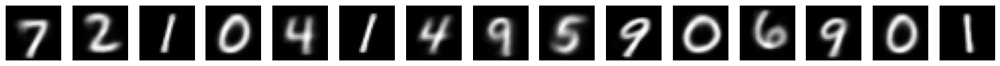

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

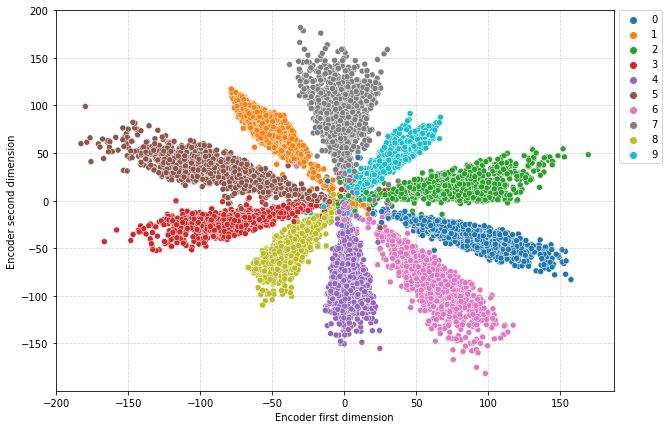

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

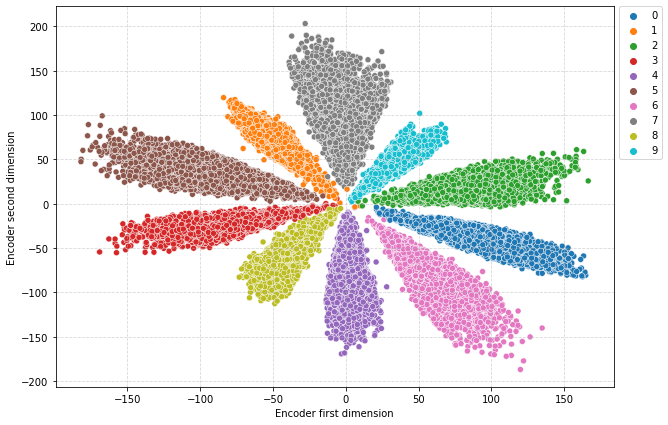

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=np.argmax(y_t, axis=1), palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

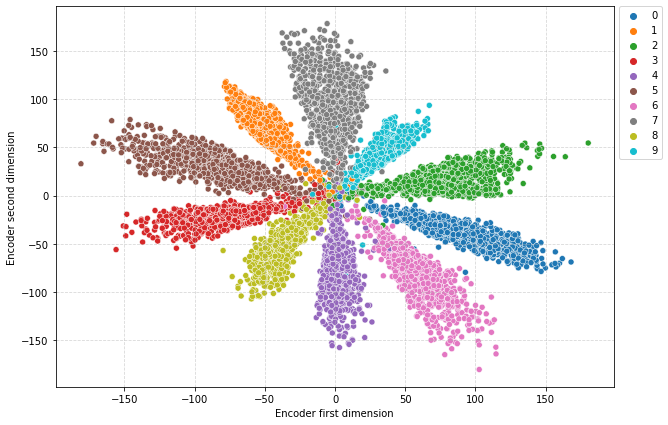

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=np.argmax(y_v, axis=1), palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.1 Hidden Layers: PRelu - Latent Space: Linear + BatchNorm + Regularization: MULTIPLE OUTPUT

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1)
  enc_layer_1 = tf.keras.layers.PReLU()(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.layers.PReLU()(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.layers.PReLU()(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L2(l2=1.0))(enc_layer_3)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.layers.PReLU()(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.layers.PReLU()(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.layers.PReLU()(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = tf.keras.Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = tf.keras.Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_91 (Dense)               (None, 500)          392500      ['input_15[0][0]']               
                                                                                                  
 batch_normalization_69 (BatchN  (None, 500)         2000        ['dense_91[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 p_re_lu_27 (PReLU)             (None, 500)          500         ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#
autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_bn_mo_reg_l2_v2/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_bn_mo_reg_l2_v2/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 10ms/step - loss: 1.0775 - Ric_Output_loss: 0.0558 - Class_Output_loss: 1.5102 - val_loss: 0.4578 - val_Ric_Output_loss: 0.0514 - val_Class_Output_loss: 1.4141 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 4s 9ms/step - loss: 0.4045 - Ric_Output_loss: 0.0512 - Class_Output_loss: 1.2077 - val_loss: 0.3518 - val_Ric_Output_loss: 0.0508 - val_Class_Output_loss: 1.0034 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 4s 9ms/step - loss: 0.3110 - Ric_Output_loss: 0.0511 - Class_Output_loss: 0.8501 - val_loss: 0.2706 - val_Ric_Output_loss: 0.0537 - val_Class_Output_loss: 0.6992 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 4s 9ms/step - loss: 0.2411 - Ric_Output_loss: 0.0511 - Class_Output_loss: 0.5929 - val_loss: 0.2211 - val_Ric_Output_loss: 0.0514 - val_Class_Output_loss: 0.5376 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 4s 9ms/step - loss: 0.18

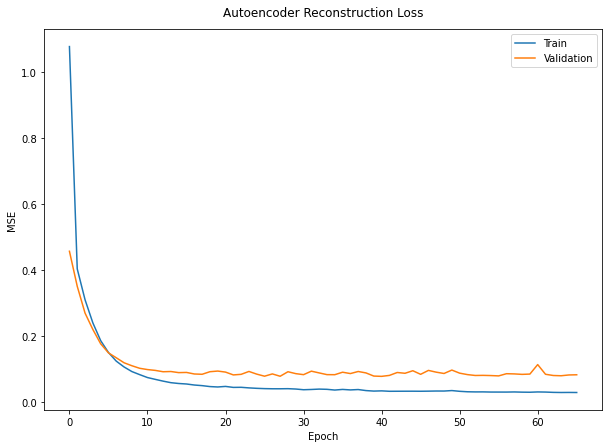

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

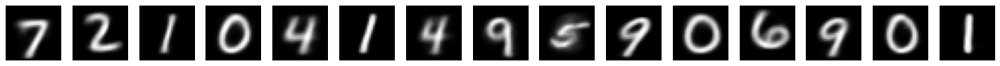

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

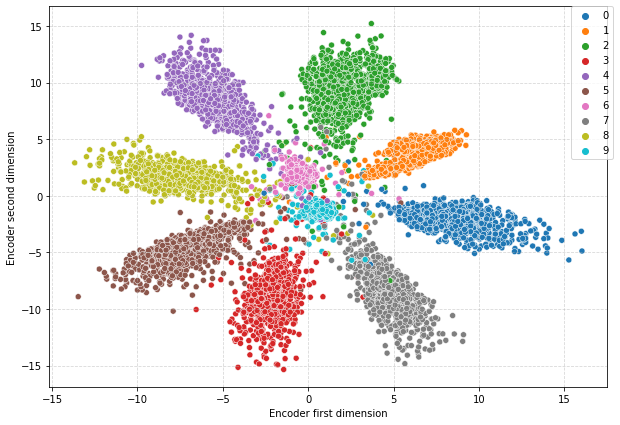

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

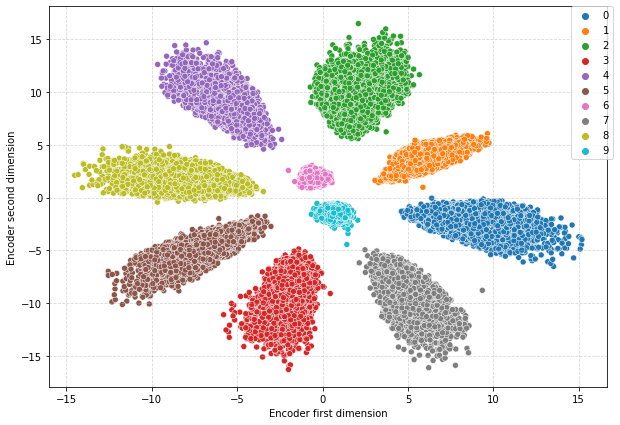

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

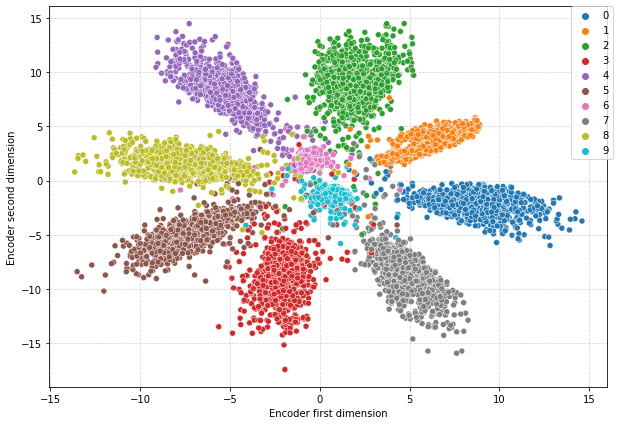

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.2 Hidden Layers: PRelu - Latent Space: Linear + BatchNorm + Regularization: MULTIPLE OUTPUT test 2

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1)
  enc_layer_1 = tf.keras.layers.PReLU()(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.layers.PReLU()(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.layers.PReLU()(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=0.01))(enc_layer_3)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.layers.PReLU()(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.layers.PReLU()(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.layers.PReLU()(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense_36 (Dense)               (None, 500)          392500      ['input_7[0][0]']                
                                                                                                  
 batch_normalization_30 (BatchN  (None, 500)         2000        ['dense_36[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 p_re_lu_30 (PReLU)             (None, 500)          500         ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_bn_mo_reg_l1/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/prel_lin_bn_mo_reg_l1/enc/encoder')

Epoch 1/120
394/394 [==============================] - 7s 11ms/step - loss: 0.4419 - Ric_Output_loss: 0.0565 - Class_Output_loss: 1.1470 - val_loss: 0.3273 - val_Ric_Output_loss: 0.0553 - val_Class_Output_loss: 0.8001 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 4s 10ms/step - loss: 0.2885 - Ric_Output_loss: 0.0527 - Class_Output_loss: 0.6510 - val_loss: 0.2457 - val_Ric_Output_loss: 0.0537 - val_Class_Output_loss: 0.5003 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 4s 10ms/step - loss: 0.2215 - Ric_Output_loss: 0.0522 - Class_Output_loss: 0.4306 - val_loss: 0.2057 - val_Ric_Output_loss: 0.0525 - val_Class_Output_loss: 0.3996 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 4s 11ms/step - loss: 0.1754 - Ric_Output_loss: 0.0517 - Class_Output_loss: 0.3061 - val_loss: 0.1697 - val_Ric_Output_loss: 0.0511 - val_Class_Output_loss: 0.3166 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 4s 10ms/step - loss: 

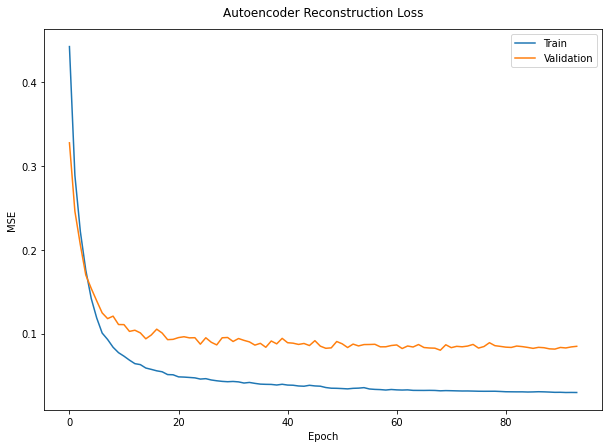

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

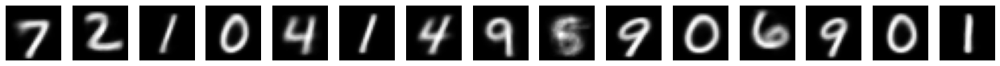

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

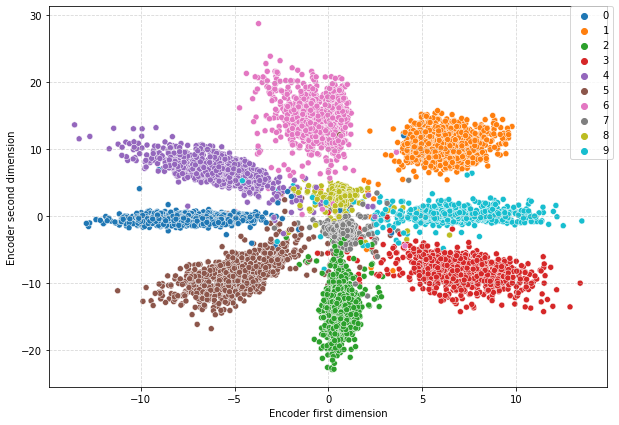

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

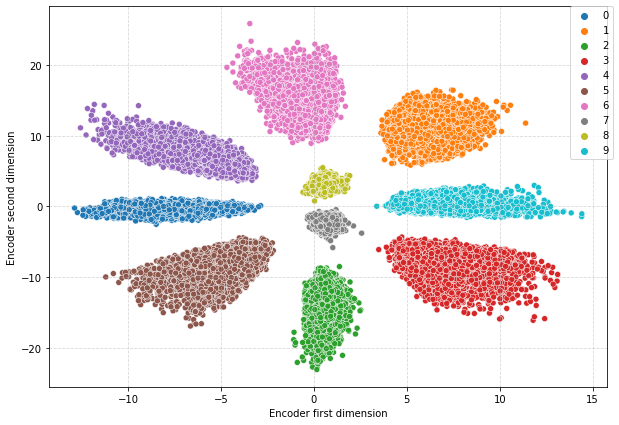

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

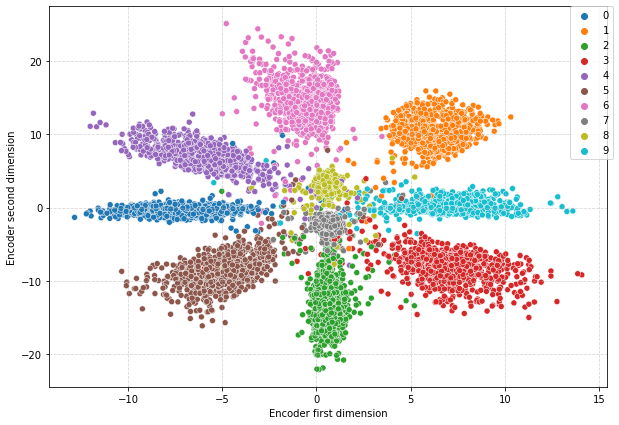

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.3 Hidden Layers: Selu - Latent Space: Linear + BatchNorm + Regularization: MULTIPLE OUTPUT

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="lecun_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1)
  enc_layer_1 = tf.keras.activations.selu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.selu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.selu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L2(l2=0.01))(enc_layer_3)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.selu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.selu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.selu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_10 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_57 (Dense)               (None, 500)          392500      ['input_10[0][0]']               
                                                                                                  
 batch_normalization_49 (BatchN  (None, 500)         2000        ['dense_57[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 tf.nn.selu_12 (TFOpLambda)     (None, 500)          0           ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/selu_lin_bn_mo_bn/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/selu_lin_bn_mo_bn/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 10ms/step - loss: 0.3596 - Ric_Output_loss: 0.0758 - Class_Output_loss: 1.1070 - val_loss: 0.2669 - val_Ric_Output_loss: 0.0563 - val_Class_Output_loss: 0.8079 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 4s 9ms/step - loss: 0.2425 - Ric_Output_loss: 0.0545 - Class_Output_loss: 0.7152 - val_loss: 0.2167 - val_Ric_Output_loss: 0.0546 - val_Class_Output_loss: 0.6146 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 4s 9ms/step - loss: 0.2075 - Ric_Output_loss: 0.0537 - Class_Output_loss: 0.5794 - val_loss: 0.1956 - val_Ric_Output_loss: 0.0532 - val_Class_Output_loss: 0.5373 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 4s 9ms/step - loss: 0.1832 - Ric_Output_loss: 0.0533 - Class_Output_loss: 0.4882 - val_loss: 0.1879 - val_Ric_Output_loss: 0.0534 - val_Class_Output_loss: 0.5079 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 4s 9ms/step - loss: 0.16

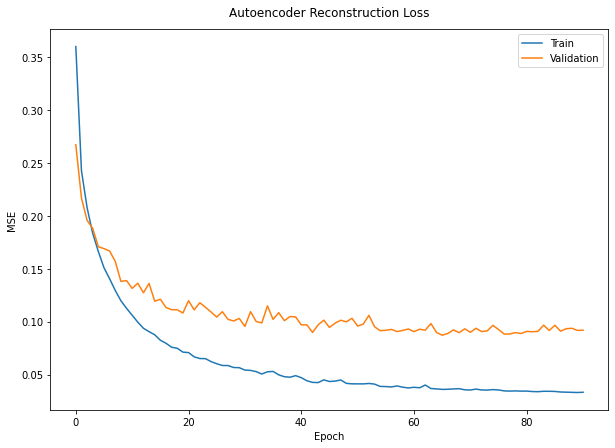

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

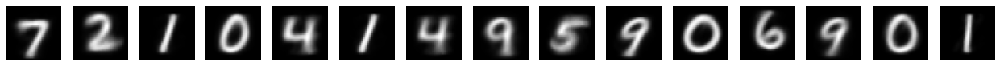

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

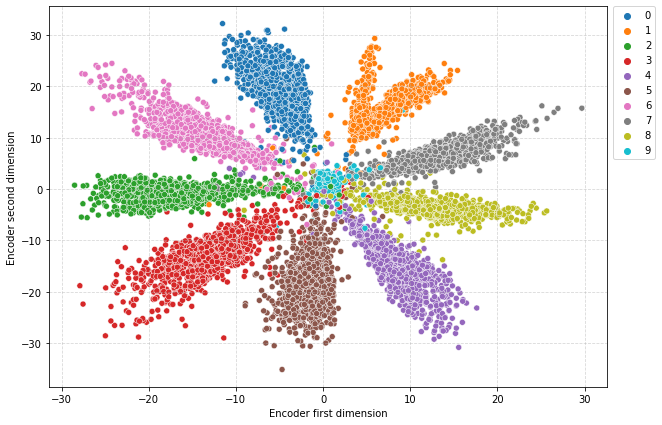

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

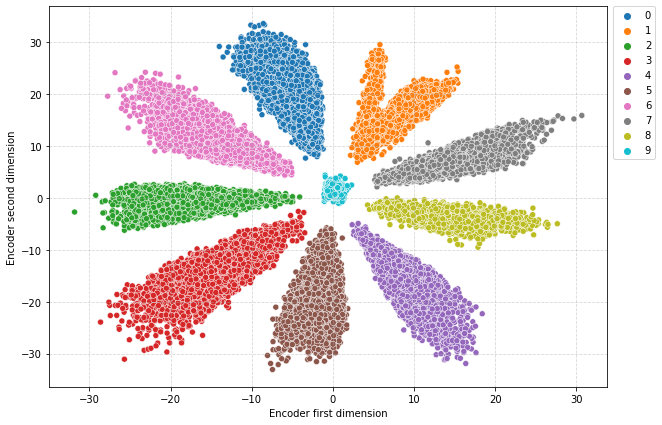

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

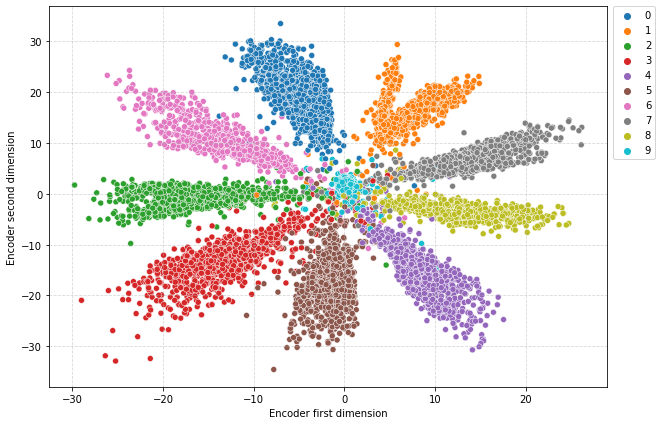

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.4 Hidden Layers: Selu - Latent Space: Linear + BatchNorm + Regularization L1: MULTIPLE OUTPUT

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="lecun_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1)
  enc_layer_1 = tf.keras.activations.selu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.selu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.selu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=0.01))(enc_layer_3)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.selu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.selu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.selu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_12 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_71 (Dense)               (None, 500)          392500      ['input_12[0][0]']               
                                                                                                  
 batch_normalization_61 (BatchN  (None, 500)         2000        ['dense_71[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 tf.nn.selu_24 (TFOpLambda)     (None, 500)          0           ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/selu_lin_bn_mo_l1/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/selu_lin_bn_mo_l1/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 10ms/step - loss: 0.4427 - Ric_Output_loss: 0.0760 - Class_Output_loss: 1.1207 - val_loss: 0.3438 - val_Ric_Output_loss: 0.0567 - val_Class_Output_loss: 0.8942 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 4s 9ms/step - loss: 0.3050 - Ric_Output_loss: 0.0541 - Class_Output_loss: 0.7652 - val_loss: 0.2713 - val_Ric_Output_loss: 0.0541 - val_Class_Output_loss: 0.6511 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 4s 10ms/step - loss: 0.2601 - Ric_Output_loss: 0.0533 - Class_Output_loss: 0.6158 - val_loss: 0.2361 - val_Ric_Output_loss: 0.0529 - val_Class_Output_loss: 0.5324 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 9ms/step - loss: 0.2245 - Ric_Output_loss: 0.0530 - Class_Output_loss: 0.4872 - val_loss: 0.2126 - val_Ric_Output_loss: 0.0526 - val_Class_Output_loss: 0.4520 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 3s 8ms/step - loss: 0.1

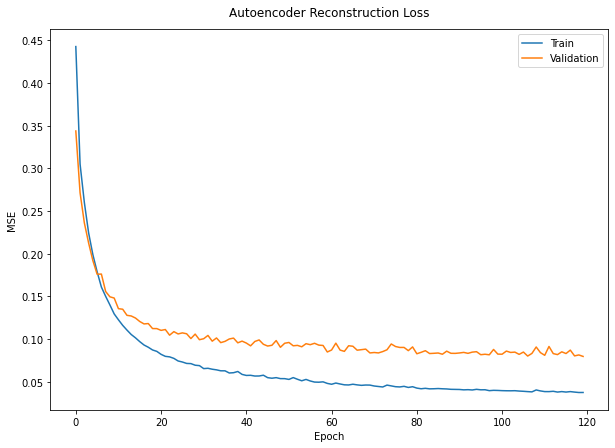

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

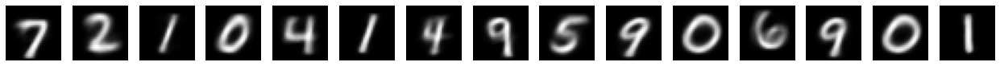

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

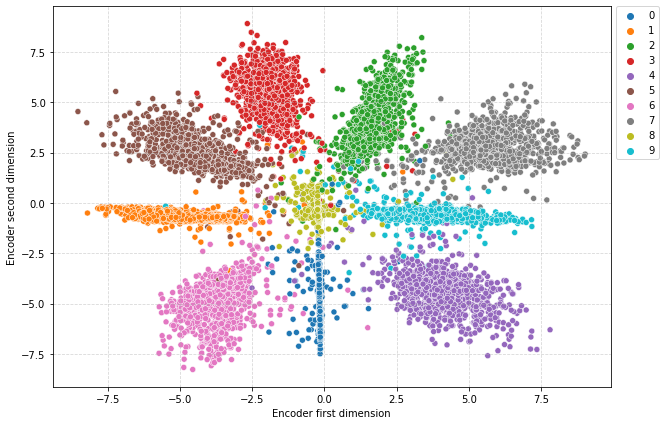

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

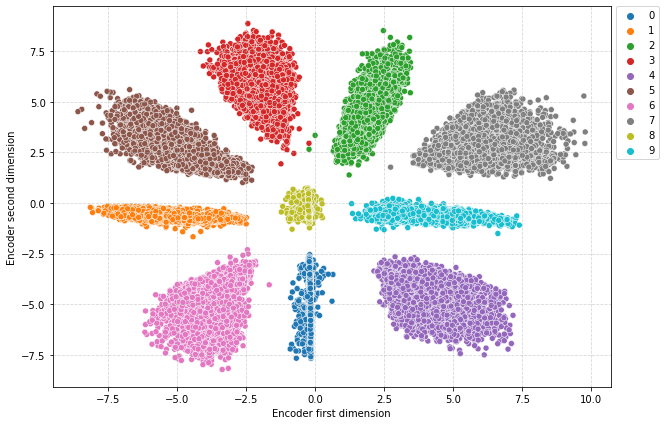

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

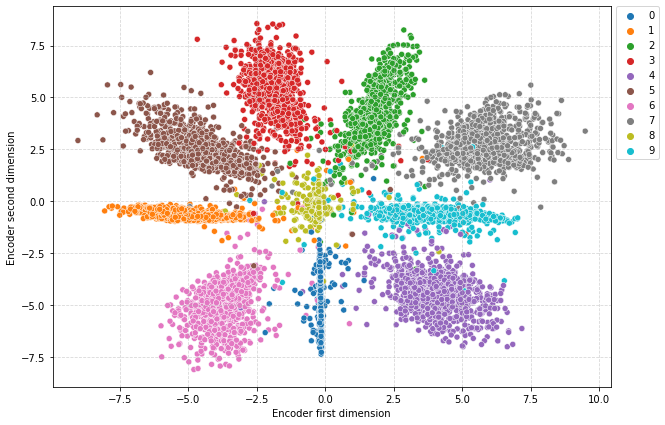

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.5 Hidden Layers: Elu - Latent Space: Linear: MULTIPLE OUTPUT

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  #enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.elu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  #enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.elu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  #enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.elu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  #dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.elu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  #dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.elu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  #dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.elu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_15 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_92 (Dense)               (None, 500)          392500      ['input_15[0][0]']               
                                                                                                  
 tf.nn.elu_12 (TFOpLambda)      (None, 500)          0           ['dense_92[0][0]']               
                                                                                                  
 dense_93 (Dense)               (None, 300)          150300      ['tf.nn.elu_12[0][0]']           
                                                                                   

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin_mo/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin_mo/enc/encoder')

Epoch 1/120
394/394 [==============================] - 3s 5ms/step - loss: 0.2912 - Ric_Output_loss: 0.0615 - Class_Output_loss: 0.9805 - val_loss: 0.1880 - val_Ric_Output_loss: 0.0536 - val_Class_Output_loss: 0.5913 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 5ms/step - loss: 0.1607 - Ric_Output_loss: 0.0530 - Class_Output_loss: 0.4839 - val_loss: 0.1444 - val_Ric_Output_loss: 0.0524 - val_Class_Output_loss: 0.4205 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 5ms/step - loss: 0.1173 - Ric_Output_loss: 0.0515 - Class_Output_loss: 0.3147 - val_loss: 0.1162 - val_Ric_Output_loss: 0.0505 - val_Class_Output_loss: 0.3134 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 5ms/step - loss: 0.0989 - Ric_Output_loss: 0.0505 - Class_Output_loss: 0.2443 - val_loss: 0.1182 - val_Ric_Output_loss: 0.0499 - val_Class_Output_loss: 0.3232 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 5ms/step - loss: 0.086

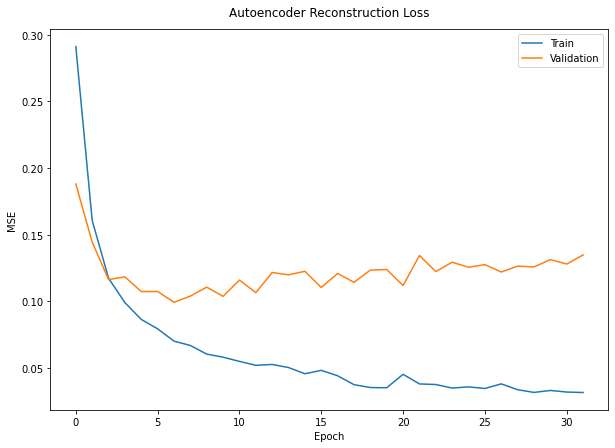

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

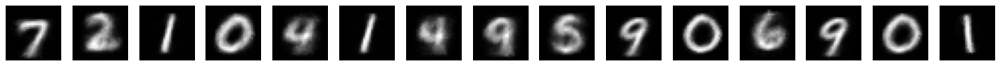

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

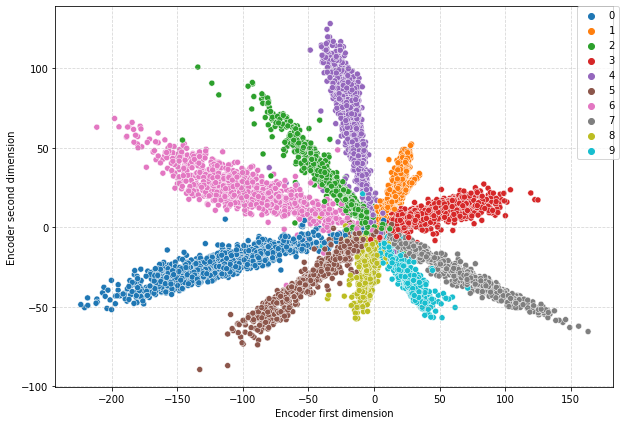

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

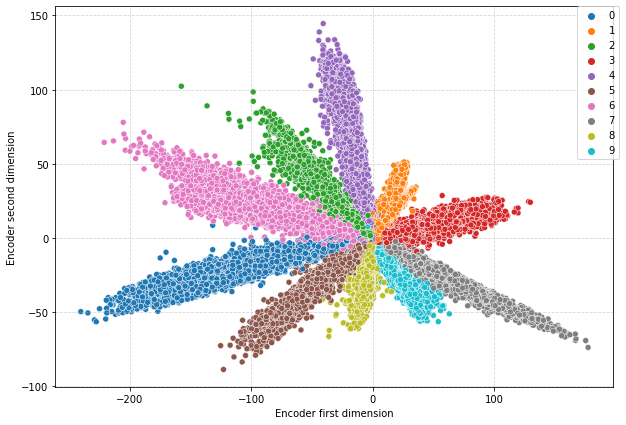

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

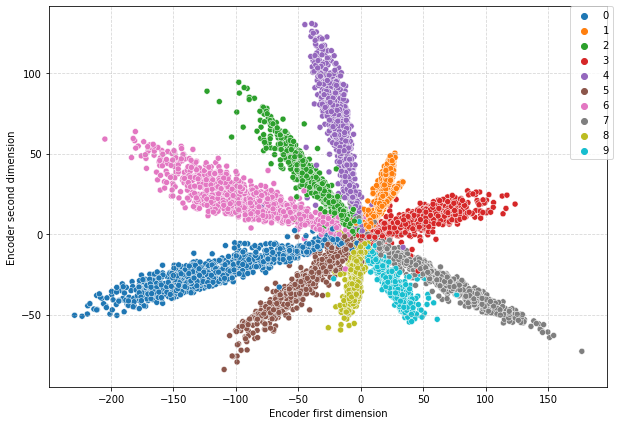

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.6 Hidden Layers: Elu - Latent Space: Linear: MULTIPLE OUTPUT and L1 reg

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  #enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.elu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  #enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.elu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  #enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.elu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=0.01))(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  #dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.elu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  #dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.elu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  #dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.elu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense (Dense)                  (None, 500)          392500      ['input_1[0][0]']                
                                                                                                  
 tf.nn.elu (TFOpLambda)         (None, 500)          0           ['dense[0][0]']                  
                                                                                                  
 dense_1 (Dense)                (None, 300)          150300      ['tf.nn.elu[0][0]']              
                                                                                   

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin_l1_mo/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/elu_lin_l1_mo/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 6ms/step - loss: 0.3955 - Ric_Output_loss: 0.0590 - Class_Output_loss: 1.0695 - val_loss: 0.2565 - val_Ric_Output_loss: 0.0531 - val_Class_Output_loss: 0.7461 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 5ms/step - loss: 0.2192 - Ric_Output_loss: 0.0518 - Class_Output_loss: 0.6210 - val_loss: 0.1917 - val_Ric_Output_loss: 0.0507 - val_Class_Output_loss: 0.5283 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 5ms/step - loss: 0.1732 - Ric_Output_loss: 0.0502 - Class_Output_loss: 0.4595 - val_loss: 0.1638 - val_Ric_Output_loss: 0.0496 - val_Class_Output_loss: 0.4297 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 5ms/step - loss: 0.1457 - Ric_Output_loss: 0.0492 - Class_Output_loss: 0.3598 - val_loss: 0.1429 - val_Ric_Output_loss: 0.0486 - val_Class_Output_loss: 0.3551 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 5ms/step - loss: 0.125

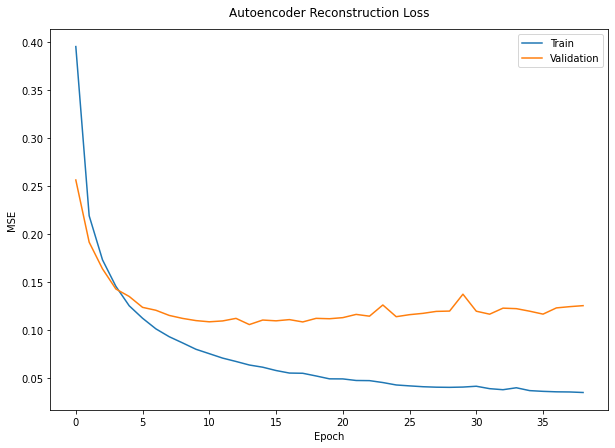

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

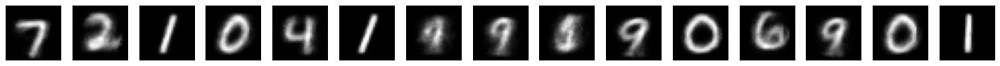

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

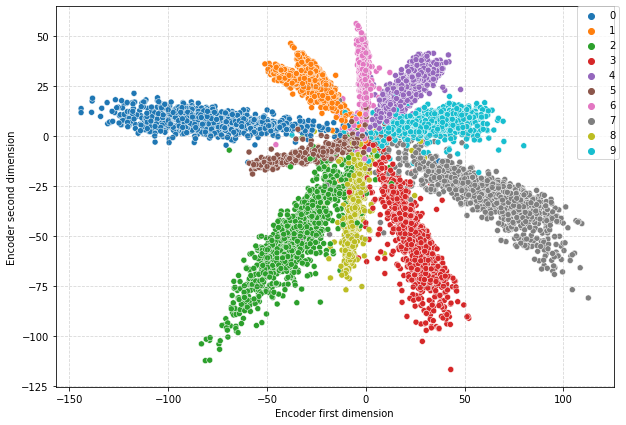

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

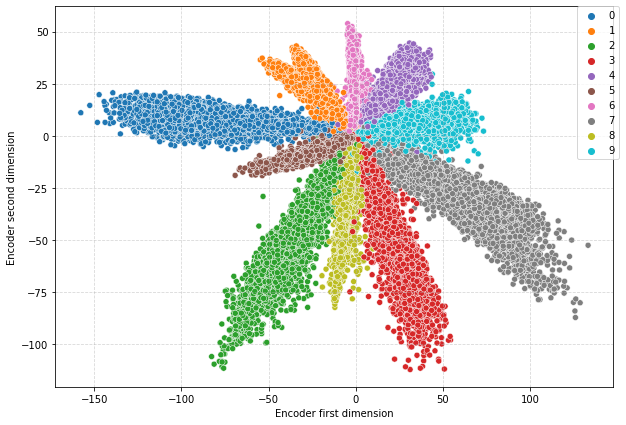

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

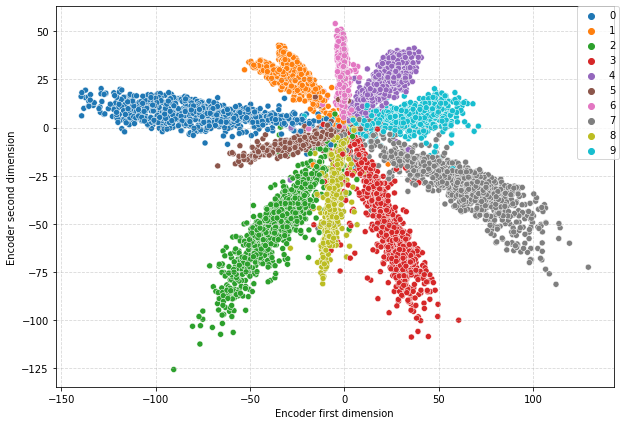

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.7 Hidden Layers: Relu - Latent Space: Linear: MULTIPLE OUTPUT

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.relu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.relu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.relu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear')(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.relu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.relu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.relu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense_14 (Dense)               (None, 500)          392500      ['input_3[0][0]']                
                                                                                                  
 batch_normalization (BatchNorm  (None, 500)         2000        ['dense_14[0][0]']               
 alization)                                                                                       
                                                                                                  
 tf.nn.relu_6 (TFOpLambda)      (None, 500)          0           ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/relu_lin_bn_mo/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/relu_lin_bn_mo/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 9ms/step - loss: 0.2451 - Ric_Output_loss: 0.0560 - Class_Output_loss: 0.8122 - val_loss: 0.1654 - val_Ric_Output_loss: 0.0540 - val_Class_Output_loss: 0.4996 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 3s 9ms/step - loss: 0.1370 - Ric_Output_loss: 0.0524 - Class_Output_loss: 0.3909 - val_loss: 0.1501 - val_Ric_Output_loss: 0.0541 - val_Class_Output_loss: 0.4381 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 3s 9ms/step - loss: 0.1039 - Ric_Output_loss: 0.0523 - Class_Output_loss: 0.2587 - val_loss: 0.1258 - val_Ric_Output_loss: 0.0524 - val_Class_Output_loss: 0.3462 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 8ms/step - loss: 0.0862 - Ric_Output_loss: 0.0519 - Class_Output_loss: 0.1892 - val_loss: 0.1114 - val_Ric_Output_loss: 0.0517 - val_Class_Output_loss: 0.2903 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 3s 8ms/step - loss: 0.073

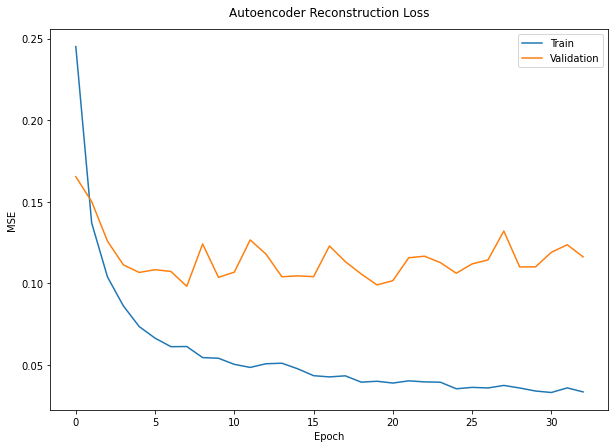

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

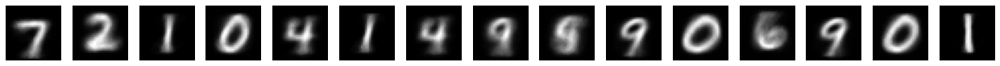

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

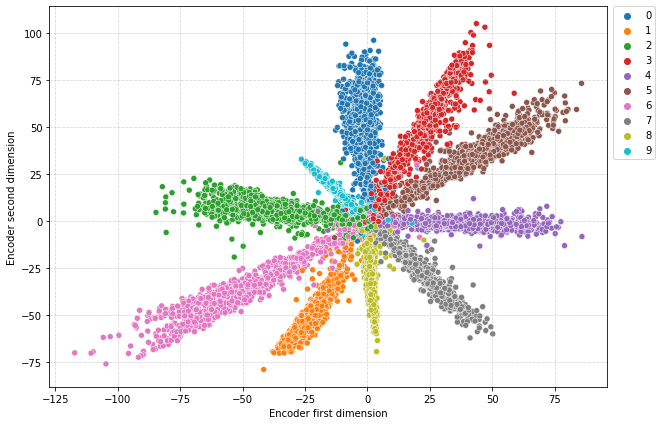

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

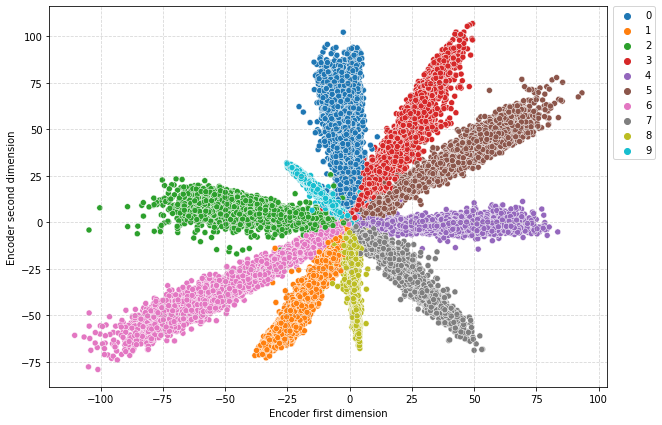

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

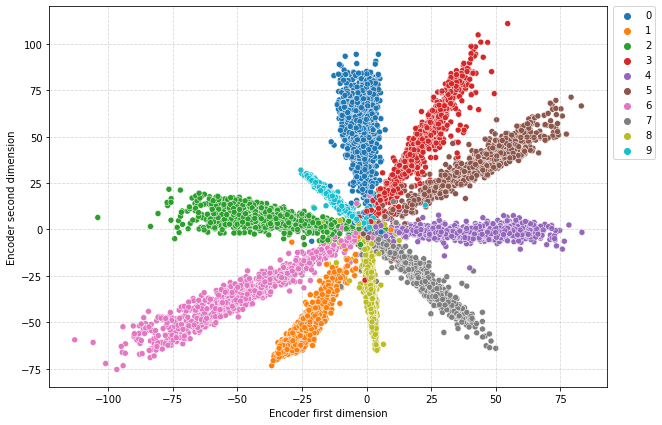

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.8 Hidden Layers: Relu - Latent Space: Linear: MULTIPLE OUTPUT and L1 reg

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.relu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.relu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.relu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=0.01))(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.relu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.relu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.relu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense_21 (Dense)               (None, 500)          392500      ['input_4[0][0]']                
                                                                                                  
 batch_normalization_6 (BatchNo  (None, 500)         2000        ['dense_21[0][0]']               
 rmalization)                                                                                     
                                                                                                  
 tf.nn.relu_12 (TFOpLambda)     (None, 500)          0           ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/relu_lin_bn_mo/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/relu_lin_bn_mo/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 10ms/step - loss: 0.4314 - Ric_Output_loss: 0.0569 - Class_Output_loss: 1.0824 - val_loss: 0.3346 - val_Ric_Output_loss: 0.0539 - val_Class_Output_loss: 0.7943 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 3s 9ms/step - loss: 0.2970 - Ric_Output_loss: 0.0524 - Class_Output_loss: 0.6685 - val_loss: 0.2599 - val_Ric_Output_loss: 0.0519 - val_Class_Output_loss: 0.5493 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 3s 8ms/step - loss: 0.2379 - Ric_Output_loss: 0.0519 - Class_Output_loss: 0.4795 - val_loss: 0.2209 - val_Ric_Output_loss: 0.0515 - val_Class_Output_loss: 0.4361 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 8ms/step - loss: 0.1988 - Ric_Output_loss: 0.0516 - Class_Output_loss: 0.3582 - val_loss: 0.1969 - val_Ric_Output_loss: 0.0519 - val_Class_Output_loss: 0.3677 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 3s 8ms/step - loss: 0.17

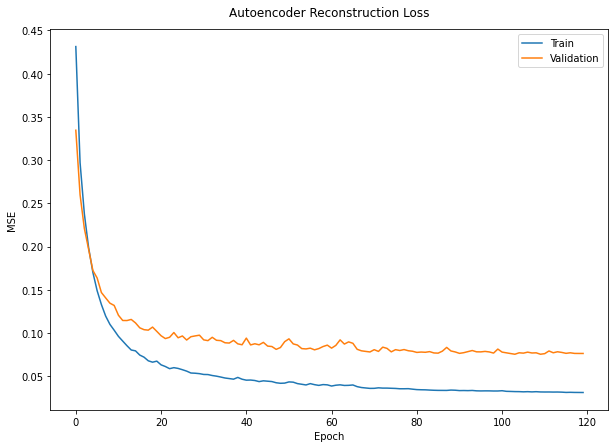

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

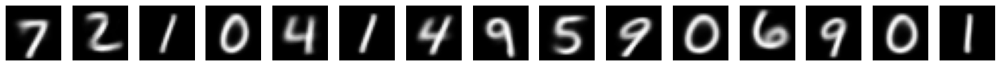

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

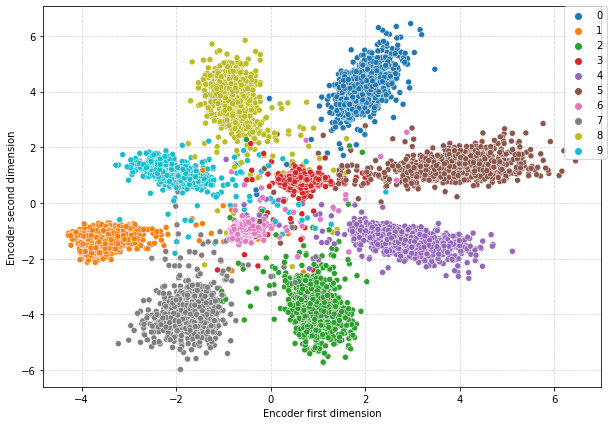

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

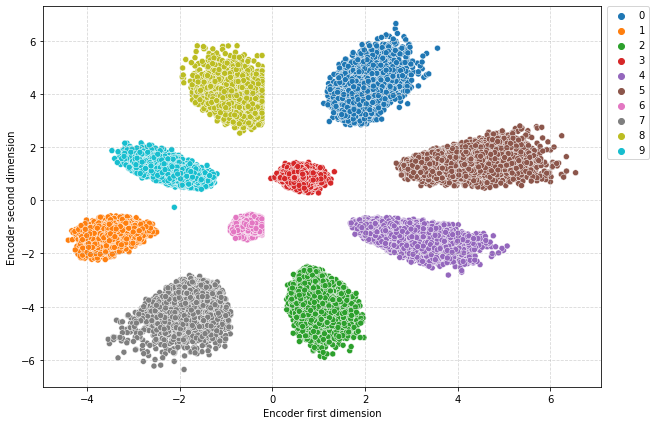

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

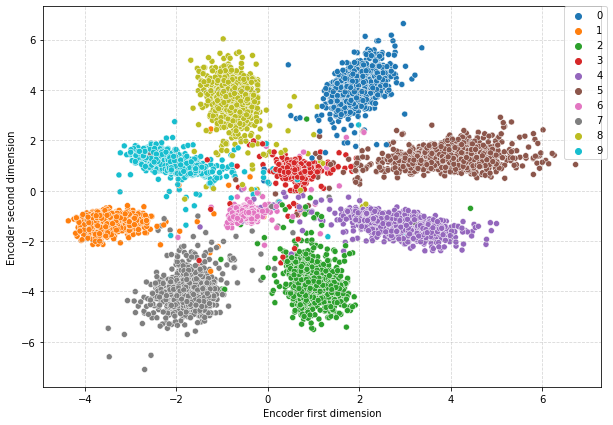

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.9 Hidden Layers: Relu - Latent Space: Linear: MULTIPLE OUTPUT and L2 reg

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.relu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.relu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.relu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L2(l2=0.1))(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.relu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.relu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.relu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_12 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_70 (Dense)               (None, 500)          392500      ['input_12[0][0]']               
                                                                                                  
 batch_normalization_51 (BatchN  (None, 500)         2000        ['dense_70[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 tf.nn.relu_36 (TFOpLambda)     (None, 500)          0           ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/relu_lin_bn_l2_mo/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/relu_lin_bn_l2_mo/enc/encoder')

Epoch 1/120
394/394 [==============================] - 6s 10ms/step - loss: 0.4161 - Ric_Output_loss: 0.0554 - Class_Output_loss: 1.0925 - val_loss: 0.2975 - val_Ric_Output_loss: 0.0523 - val_Class_Output_loss: 0.8226 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 3s 8ms/step - loss: 0.2671 - Ric_Output_loss: 0.0514 - Class_Output_loss: 0.7155 - val_loss: 0.2297 - val_Ric_Output_loss: 0.0510 - val_Class_Output_loss: 0.5832 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 3s 8ms/step - loss: 0.2081 - Ric_Output_loss: 0.0509 - Class_Output_loss: 0.5033 - val_loss: 0.1919 - val_Ric_Output_loss: 0.0502 - val_Class_Output_loss: 0.4558 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 8ms/step - loss: 0.1686 - Ric_Output_loss: 0.0503 - Class_Output_loss: 0.3677 - val_loss: 0.1637 - val_Ric_Output_loss: 0.0503 - val_Class_Output_loss: 0.3575 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 3s 9ms/step - loss: 0.14

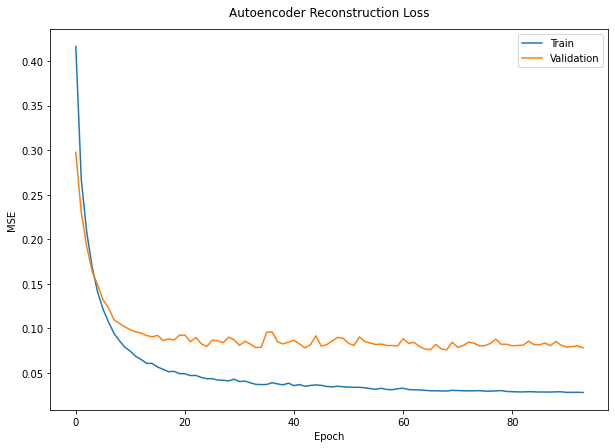

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

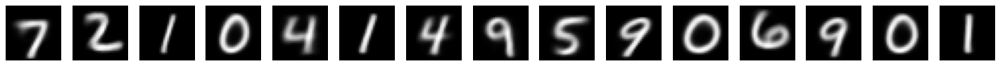

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

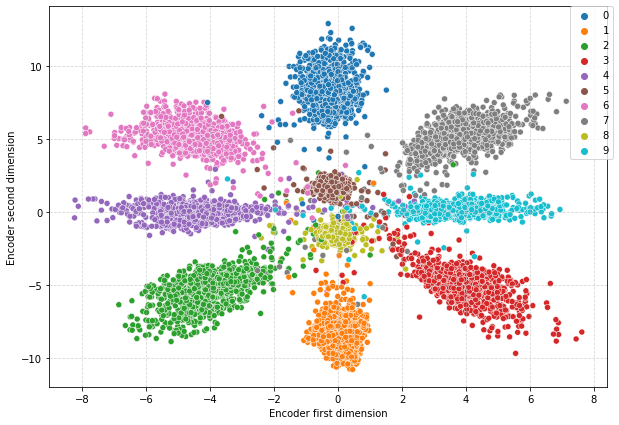

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

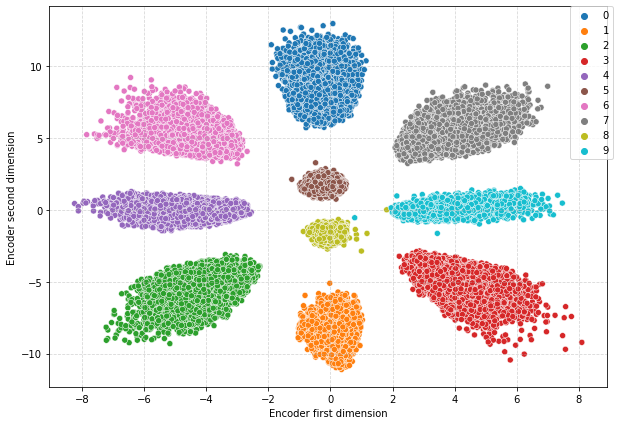

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

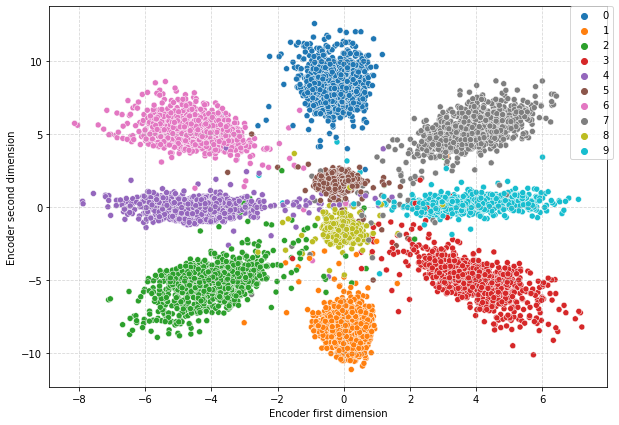

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.10 Hidden Layers: Relu - Latent Space: Linear: MULTIPLE OUTPUT and L2 reg v2

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.relu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.relu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.relu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L2(l2=1.0))(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.relu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.relu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.relu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_13 (InputLayer)          [(None, 784)]        0           []                               
                                                                                                  
 dense_77 (Dense)               (None, 500)          392500      ['input_13[0][0]']               
                                                                                                  
 batch_normalization_57 (BatchN  (None, 500)         2000        ['dense_77[0][0]']               
 ormalization)                                                                                    
                                                                                                  
 tf.nn.relu_42 (TFOpLambda)     (None, 500)          0           ['batch_normalizat

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/relu_lin_bn_l2_mo_v2/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/relu_lin_bn_l2_mo_v2/enc/encoder')

Epoch 1/120
394/394 [==============================] - 5s 9ms/step - loss: 1.1233 - Ric_Output_loss: 0.0557 - Class_Output_loss: 1.4322 - val_loss: 0.4496 - val_Ric_Output_loss: 0.0510 - val_Class_Output_loss: 1.3626 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 3s 8ms/step - loss: 0.4084 - Ric_Output_loss: 0.0505 - Class_Output_loss: 1.2218 - val_loss: 0.3617 - val_Ric_Output_loss: 0.0525 - val_Class_Output_loss: 1.0371 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 3s 9ms/step - loss: 0.3306 - Ric_Output_loss: 0.0500 - Class_Output_loss: 0.9239 - val_loss: 0.2996 - val_Ric_Output_loss: 0.0521 - val_Class_Output_loss: 0.7960 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 3s 8ms/step - loss: 0.2735 - Ric_Output_loss: 0.0498 - Class_Output_loss: 0.7032 - val_loss: 0.2547 - val_Ric_Output_loss: 0.0514 - val_Class_Output_loss: 0.6360 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 3s 8ms/step - loss: 0.229

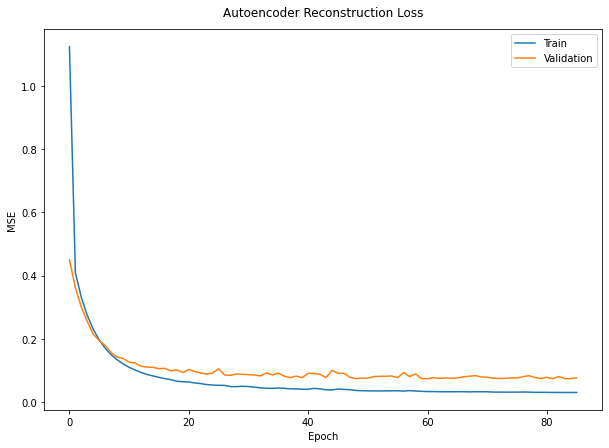

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

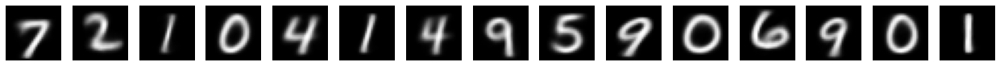

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

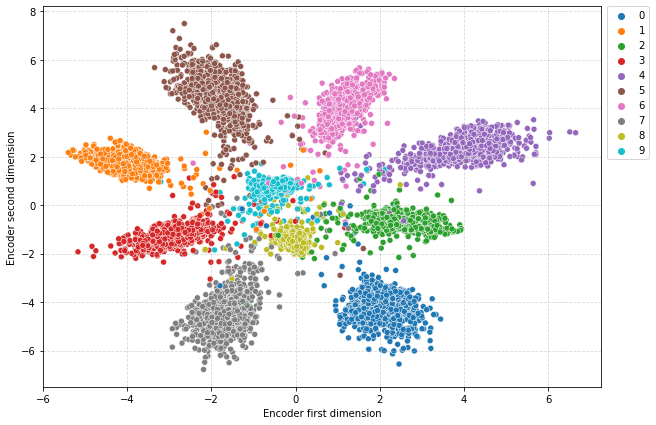

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

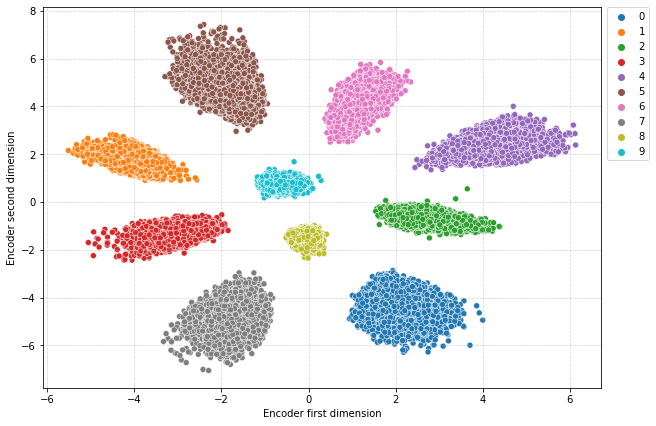

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

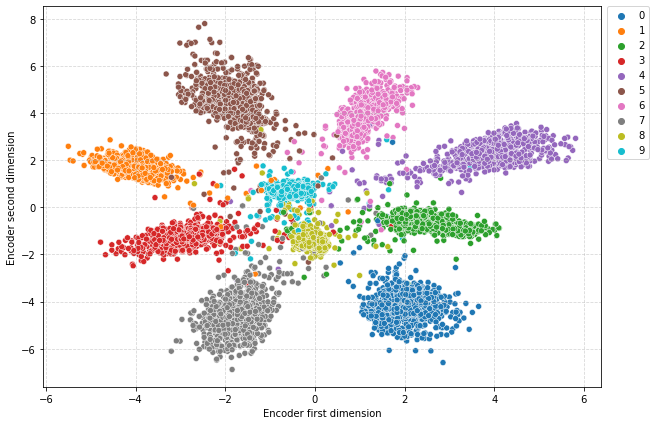

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.11 Hidden Layers: Gelu - Latent Space: Linear: MULTIPLE OUTPUT

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  #enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.gelu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  #enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.gelu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  #enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.gelu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear',)(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  #dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.gelu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  #dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.gelu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  #dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.gelu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense_24 (Dense)               (None, 500)          392500      ['input_4[0][0]']                
                                                                                                  
 tf.nn.gelu_18 (TFOpLambda)     (None, 500)          0           ['dense_24[0][0]']               
                                                                                                  
 dense_25 (Dense)               (None, 300)          150300      ['tf.nn.gelu_18[0][0]']          
                                                                                   

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin_mo/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin_mo/enc/encoder')

Epoch 1/120
394/394 [==============================] - 4s 7ms/step - loss: 0.2666 - Ric_Output_loss: 0.0614 - Class_Output_loss: 0.8821 - val_loss: 0.1587 - val_Ric_Output_loss: 0.0531 - val_Class_Output_loss: 0.4752 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 6ms/step - loss: 0.1255 - Ric_Output_loss: 0.0513 - Class_Output_loss: 0.3478 - val_loss: 0.1184 - val_Ric_Output_loss: 0.0505 - val_Class_Output_loss: 0.3219 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 6ms/step - loss: 0.0893 - Ric_Output_loss: 0.0489 - Class_Output_loss: 0.2106 - val_loss: 0.1008 - val_Ric_Output_loss: 0.0481 - val_Class_Output_loss: 0.2587 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 6ms/step - loss: 0.0719 - Ric_Output_loss: 0.0476 - Class_Output_loss: 0.1447 - val_loss: 0.1017 - val_Ric_Output_loss: 0.0477 - val_Class_Output_loss: 0.2636 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 6ms/step - loss: 0.061

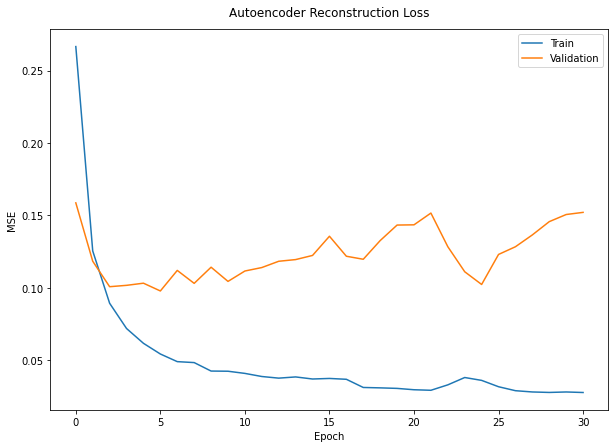

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

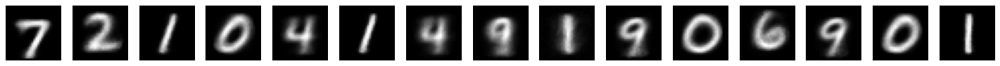

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

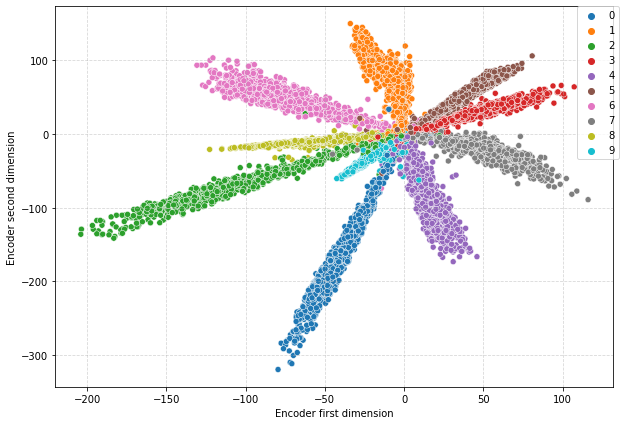

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

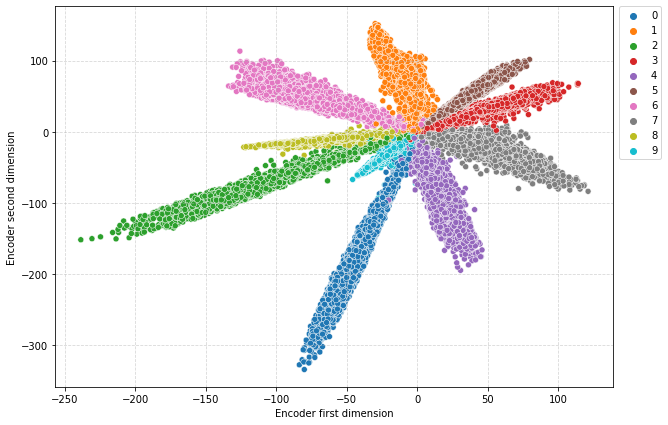

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

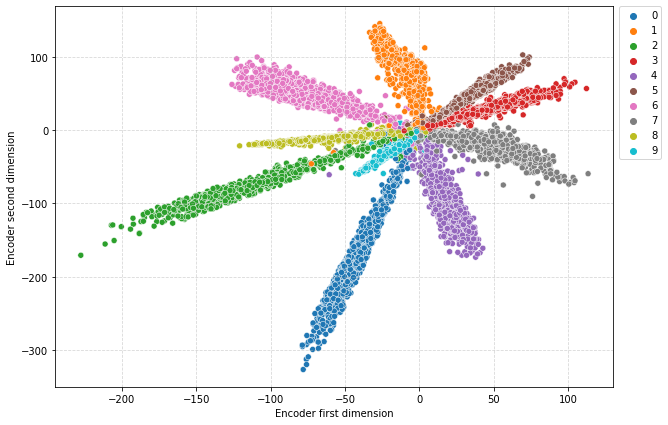

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.1 Hidden Layers: Gelu - Latent Space: Linear: MULTIPLE OUTPUT + L1 reg

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  #enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.gelu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  #enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.gelu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  #enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.gelu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L1(l1=0.1))(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  #dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.gelu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  #dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.gelu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  #dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.gelu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense_38 (Dense)               (None, 500)          392500      ['input_6[0][0]']                
                                                                                                  
 tf.nn.gelu_30 (TFOpLambda)     (None, 500)          0           ['dense_38[0][0]']               
                                                                                                  
 dense_39 (Dense)               (None, 300)          150300      ['tf.nn.gelu_30[0][0]']          
                                                                                   

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin_mo_l1/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin_mo_l1/enc/encoder')

Epoch 1/120
394/394 [==============================] - 4s 7ms/step - loss: 0.8085 - Ric_Output_loss: 0.0607 - Class_Output_loss: 0.9962 - val_loss: 0.2549 - val_Ric_Output_loss: 0.0533 - val_Class_Output_loss: 0.6944 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 6ms/step - loss: 0.2121 - Ric_Output_loss: 0.0524 - Class_Output_loss: 0.5475 - val_loss: 0.1822 - val_Ric_Output_loss: 0.0514 - val_Class_Output_loss: 0.4427 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 6ms/step - loss: 0.1617 - Ric_Output_loss: 0.0512 - Class_Output_loss: 0.3644 - val_loss: 0.1545 - val_Ric_Output_loss: 0.0501 - val_Class_Output_loss: 0.3497 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 6ms/step - loss: 0.1340 - Ric_Output_loss: 0.0505 - Class_Output_loss: 0.2703 - val_loss: 0.1415 - val_Ric_Output_loss: 0.0504 - val_Class_Output_loss: 0.3058 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 6ms/step - loss: 0.118

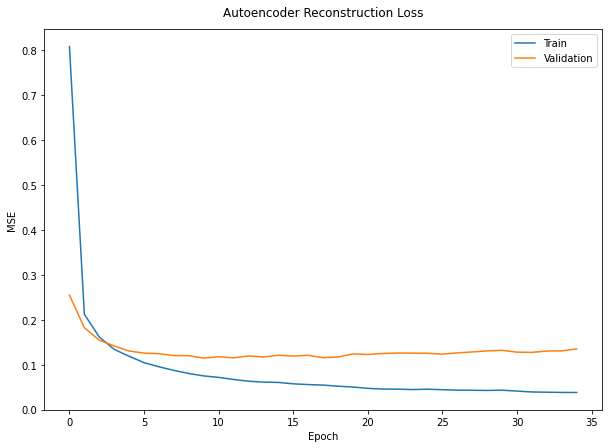

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

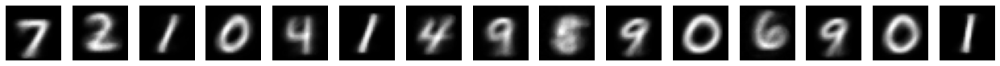

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

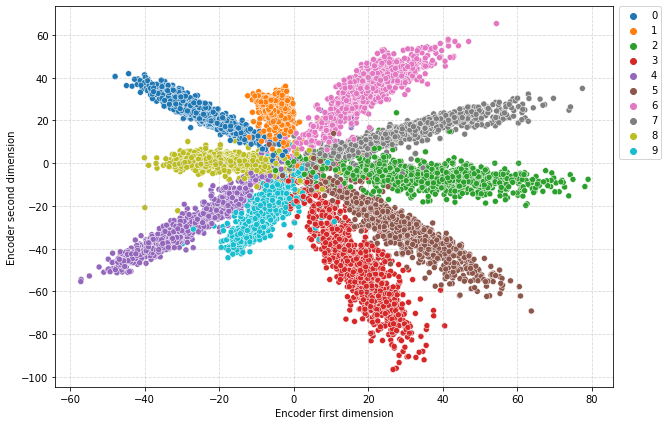

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

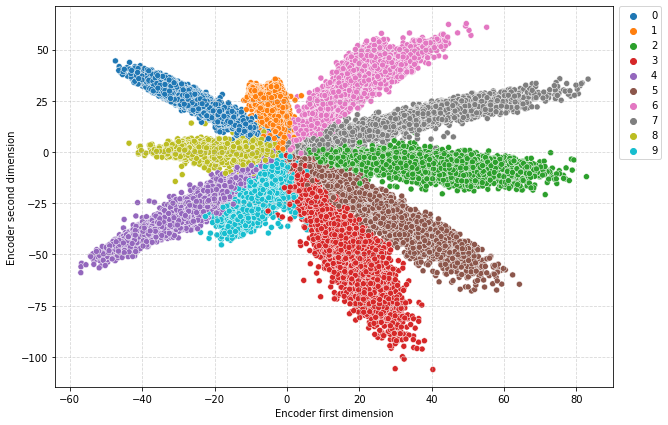

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

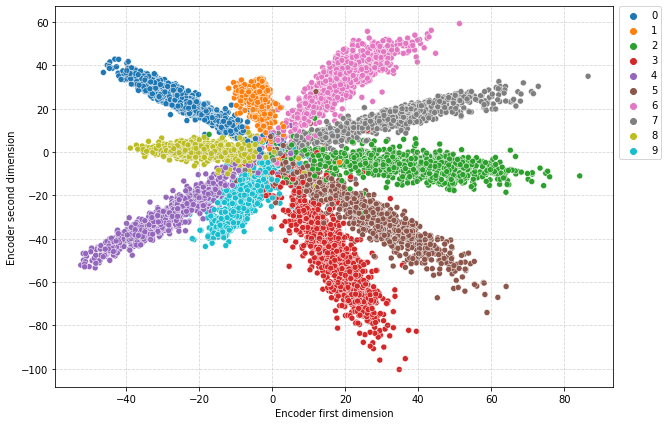

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.1 Hidden Layers: Gelu - Latent Space: Linear: MULTIPLE OUTPUT + L2 reg

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
def model_autoencoder_mult(kernel="he_normal"):
  input_dim = 28*28
  latent_vec_dim = 2

  input_layer = Input(shape=(input_dim,))

  # Define the autoencoder architecture
  # First build the encoder
  enc_layer_1 = Dense(500, kernel_initializer=kernel)(input_layer)
  #enc_layer_1 = tf.keras.layers.BatchNormalization()(enc_layer_1) #bn worsen the
  enc_layer_1 = tf.keras.activations.gelu(enc_layer_1)

  enc_layer_2 = Dense(300, kernel_initializer=kernel)(enc_layer_1)
  #enc_layer_2 = tf.keras.layers.BatchNormalization()(enc_layer_2)
  enc_layer_2 = tf.keras.activations.gelu(enc_layer_2)

  enc_layer_3 = Dense(100, kernel_initializer=kernel)(enc_layer_2)
  #enc_layer_3 = tf.keras.layers.BatchNormalization()(enc_layer_3)
  enc_layer_3 = tf.keras.activations.gelu(enc_layer_3)

  enc_layer_4 = Dense(latent_vec_dim, activation='linear', kernel_regularizer = tf.keras.regularizers.L2(l2=0.01))(enc_layer_3) #, kernel_regularizer = tf.keras.regularizers.L1(l1=0.01)
  #enc_layer_4 = tf.keras.layers.BatchNormalization()(enc_layer_4)

  output_1 = Dense(10, activation='softmax', name="Class_Output")(enc_layer_4)

  encoder = enc_layer_4

  # Then build the decoder
  dec_layer_1 = Dense(100, kernel_initializer=kernel)(encoder)
  #dec_layer_1 = tf.keras.layers.BatchNormalization()(dec_layer_1)
  dec_layer_1 = tf.keras.activations.gelu(dec_layer_1)

  dec_layer_2 = Dense(300, kernel_initializer=kernel)(dec_layer_1)
  #dec_layer_2 = tf.keras.layers.BatchNormalization()(dec_layer_2)
  dec_layer_2 = tf.keras.activations.gelu(dec_layer_2)

  dec_layer_3 = Dense(500, kernel_initializer=kernel)(dec_layer_2)
  #dec_layer_3 = tf.keras.layers.BatchNormalization()(dec_layer_3)
  dec_layer_3 = tf.keras.activations.gelu(dec_layer_3)

  dec_layer_4 = Dense(input_dim, activation='sigmoid', name="Ric_Output")(dec_layer_3)
  decoder = dec_layer_4

  # Connect both encoder and decoder
  autoencoder_mult = Model(inputs = input_layer, outputs = [decoder, output_1], name="Deep_Autoencoder")

  # Latent representation (Optional)
  latent_model = Model(input_layer, encoder)

  return autoencoder_mult, latent_model

In [ ]:
autoencoder_prellin, latent_model_prellin = model_autoencoder_mult()

# Get summary
autoencoder_prellin.summary()

Model: "Deep_Autoencoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_7 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense_45 (Dense)               (None, 500)          392500      ['input_7[0][0]']                
                                                                                                  
 tf.nn.gelu_36 (TFOpLambda)     (None, 500)          0           ['dense_45[0][0]']               
                                                                                                  
 dense_46 (Dense)               (None, 300)          150300      ['tf.nn.gelu_36[0][0]']          
                                                                                   

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = 'mse'
loss_1 = 'categorical_crossentropy'#

autoencoder_prellin.compile(loss=[loss_0, loss_1], loss_weights=[0.75,0.25], optimizer=optimizer)

# Train the autoencoder with MNIST data
history_prellin = autoencoder_prellin.fit(X_t, [X_t, y_t_], epochs=120, batch_size=128, callbacks = [early_stop, Checkpoint, lr],
                                       shuffle=True, validation_data=(X_v, [X_v, y_v_]))

autoencoder_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin_mo_l2/enc/autoencoder')
latent_model_prellin.save(f'/content/drive/MyDrive/Exercises/Autoencoders/gelu_lin_mo_l2/enc/encoder')

Epoch 1/120
394/394 [==============================] - 4s 7ms/step - loss: 0.2955 - Ric_Output_loss: 0.0614 - Class_Output_loss: 0.9142 - val_loss: 0.1902 - val_Ric_Output_loss: 0.0535 - val_Class_Output_loss: 0.5434 - lr: 0.0010
Epoch 2/120
394/394 [==============================] - 2s 6ms/step - loss: 0.1498 - Ric_Output_loss: 0.0518 - Class_Output_loss: 0.3938 - val_loss: 0.1350 - val_Ric_Output_loss: 0.0499 - val_Class_Output_loss: 0.3483 - lr: 0.0010
Epoch 3/120
394/394 [==============================] - 2s 6ms/step - loss: 0.1105 - Ric_Output_loss: 0.0491 - Class_Output_loss: 0.2571 - val_loss: 0.1217 - val_Ric_Output_loss: 0.0490 - val_Class_Output_loss: 0.3066 - lr: 0.0010
Epoch 4/120
394/394 [==============================] - 2s 6ms/step - loss: 0.0882 - Ric_Output_loss: 0.0473 - Class_Output_loss: 0.1800 - val_loss: 0.1205 - val_Ric_Output_loss: 0.0471 - val_Class_Output_loss: 0.3132 - lr: 0.0010
Epoch 5/120
394/394 [==============================] - 2s 6ms/step - loss: 0.075

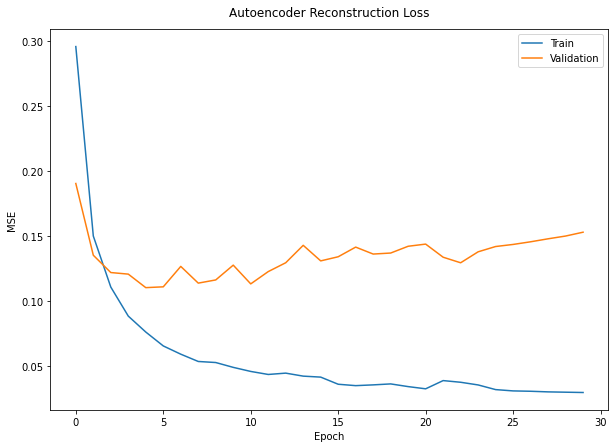

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_prellin.history['loss'], label='Train')
plt.plot(history_prellin.history['val_loss'], label='Validation')
plt.ylabel('MSE')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss', pad=13)
plt.legend(loc='upper right')

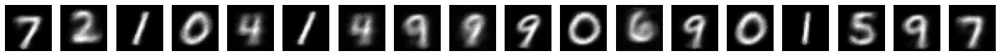

In [ ]:
compressed_images = autoencoder_prellin.predict(test_images)[0]
n = 18
plt.figure(figsize=(25, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

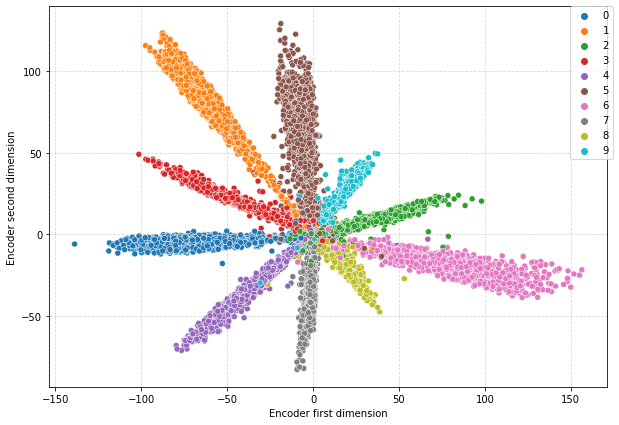

In [ ]:
latent_representation = latent_model_prellin.predict(test_images)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

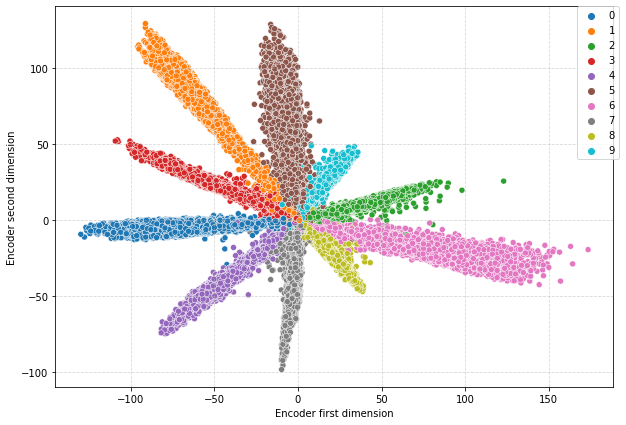

In [ ]:
latent_representation = latent_model_prellin.predict(X_t)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_t, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

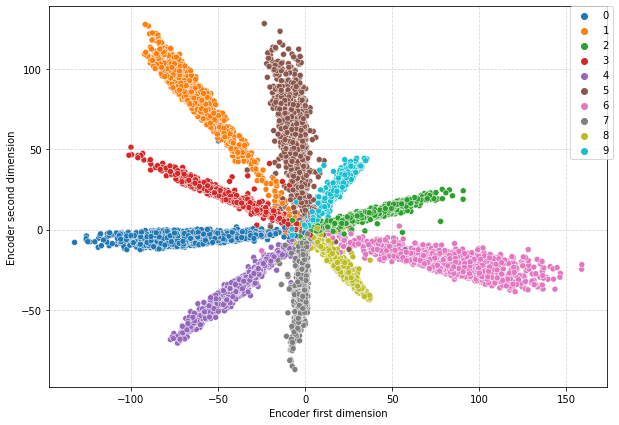

In [ ]:
latent_representation = latent_model_prellin.predict(X_v)

plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[:,0],
                y=latent_representation[:,1],
                hue=y_v, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

## 7.10 VAE: MULTIPLE OUTPUT

In [ ]:
from tensorflow.keras.utils import to_categorical

y_t_ = to_categorical(y_t)
y_v_ = to_categorical(y_v)
y_test = to_categorical(test_labels)

print(y_t.shape, y_v.shape, y_test.shape)

(50400,) (9600,) (10000, 10)


In [ ]:
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

In [ ]:
input_dim = 28*28
latent_vec_dim = 2

input_layer = Input(shape=(input_dim,))

# Define the autoencoder architecture
# First build the encoder
enc_layer_1 = Dense(500, kernel_initializer='he_normal')(input_layer)
enc_layer_1 = tf.keras.layers.PReLU()(enc_layer_1)

enc_layer_2 = Dense(300, kernel_initializer='he_normal')(enc_layer_1)
enc_layer_2 = tf.keras.layers.PReLU()(enc_layer_2)

enc_layer_3 = Dense(100, kernel_initializer='he_normal')(enc_layer_2)
enc_layer_3 = tf.keras.layers.PReLU()(enc_layer_3)

enc_layer_4 = Dense(32, kernel_initializer='he_normal')(enc_layer_3)
enc_layer_4 = tf.keras.layers.PReLU()(enc_layer_4)

z_mean = layers.Dense(latent_vec_dim, name="z_mean")(enc_layer_4)
z_log_var = layers.Dense(latent_vec_dim, name="z_log_var")(enc_layer_4)
z = Sampling()([z_mean, z_log_var])
encoder = keras.Model(input_layer, [z_mean, z_log_var, z], name="encoder")
encoder.summary()


Model: "encoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 784)]        0           []                               
                                                                                                  
 dense (Dense)                  (None, 500)          392500      ['input_1[0][0]']                
                                                                                                  
 p_re_lu (PReLU)                (None, 500)          500         ['dense[0][0]']                  
                                                                                                  
 dense_1 (Dense)                (None, 300)          150300      ['p_re_lu[0][0]']                
                                                                                            

In [ ]:
# Then build the decoder
latent_inputs = keras.Input(shape=(latent_vec_dim,))

dec_layer_0 = Dense(32, kernel_initializer='he_normal')(latent_inputs)
dec_layer_0 = tf.keras.layers.PReLU()(dec_layer_0)

dec_layer_1 = Dense(100, kernel_initializer='he_normal')(dec_layer_0)
dec_layer_1 = tf.keras.layers.PReLU()(dec_layer_1)


dec_layer_2 = Dense(300, kernel_initializer='he_normal')(dec_layer_1)
dec_layer_2 = tf.keras.layers.PReLU()(dec_layer_2)

dec_layer_3 = Dense(500, kernel_initializer='he_normal')(dec_layer_2)
dec_layer_3 = tf.keras.layers.PReLU()(dec_layer_3)

output_1 = Dense(input_dim, activation='sigmoid')(dec_layer_3)
output_2 = Dense(10, activation='softmax', name="Class_Output")(latent_inputs)


decoder = keras.Model(latent_inputs, [output_1,output_2], name="decoder")
decoder.summary()

Model: "decoder"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 2)]          0           []                               
                                                                                                  
 dense_4 (Dense)                (None, 32)           96          ['input_2[0][0]']                
                                                                                                  
 p_re_lu_4 (PReLU)              (None, 32)           32          ['dense_4[0][0]']                
                                                                                                  
 dense_5 (Dense)                (None, 100)          3300        ['p_re_lu_4[0][0]']              
                                                                                            

In [ ]:
# instantiate VAE model
outputs = decoder(encoder(input_layer)[2])
vae = keras.Model(input_layer, outputs, name='vae_mlp')

What we've done so far allows us to instantiate 3 models:

* an end-to-end autoencoder mapping inputs to reconstructions
* an encoder mapping inputs to the latent space
* a generator that can take points on the latent space and will output the corresponding reconstructed samples.

We train the model using the end-to-end model, with a custom loss function: the sum of a reconstruction term, and the KL divergence regularization term.

In [ ]:
#reconstruction_loss = keras.losses.binary_crossentropy(input_layer, outputs[0])
#reconstruction_loss *= input_dim
#kl_loss = 1 + z_log_var - K.square(z_mean) - K.exp(z_log_var)
#kl_loss = K.sum(kl_loss, axis=-1)
#kl_loss *= -0.5
#vae_loss = K.mean(reconstruction_loss + kl_loss)
#vae.add_loss(vae_loss)
#vae.compile(optimizer='adam')

def vae_loss(x, z_decoded):
        # Reconstruction loss
        xent_loss = keras.metrics.binary_crossentropy(x, z_decoded)
        # KL divergence
        kl_loss = -5e-4 * K.mean(1 + z_log_var - K.square(z_mean) - K.exp(z_log_var), axis=-1)
        return K.mean(xent_loss + kl_loss)

In [ ]:
# Compile the autoencoder model
optimizer = tf.keras.optimizers.Adam()
loss_0 = vae_loss
loss_1 = 'categorical_crossentropy'

vae.compile(optimizer=optimizer,loss=[vae_loss, loss_1],loss_weights=[0.75,0.25],)

In [ ]:
history_vae = vae.fit(X_t, [X_t, y_t_],
                      epochs=120,
                      batch_size=128,
                      callbacks = [early_stop, Checkpoint, lr],
                      shuffle=True,
                      validation_data=(X_v, [X_v, y_v_]))

Epoch 1/120


TypeError: ignored

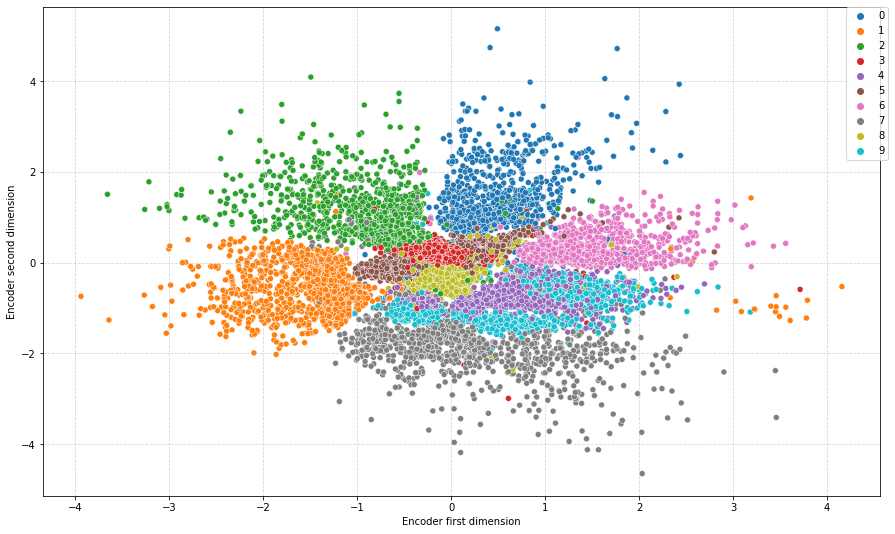

In [ ]:
latent_representation = encoder.predict(test_images)

plt.figure(figsize=(15, 9))

sns.scatterplot(x=latent_representation[2][:,0],
                y=latent_representation[2][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

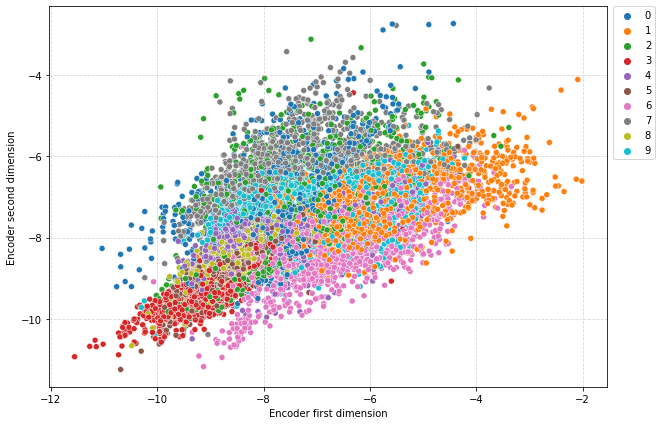

In [ ]:
plt.figure(figsize=(10, 7))

sns.scatterplot(x=latent_representation[1][:,0],
                y=latent_representation[1][:,1],
                hue=test_labels, palette='tab10')

plt.xlabel("Encoder first dimension")
plt.ylabel("Encoder second dimension")

plt.grid(linestyle='--', alpha=0.5)

plt.legend(bbox_to_anchor=(1.01, 1),
           borderaxespad=0);

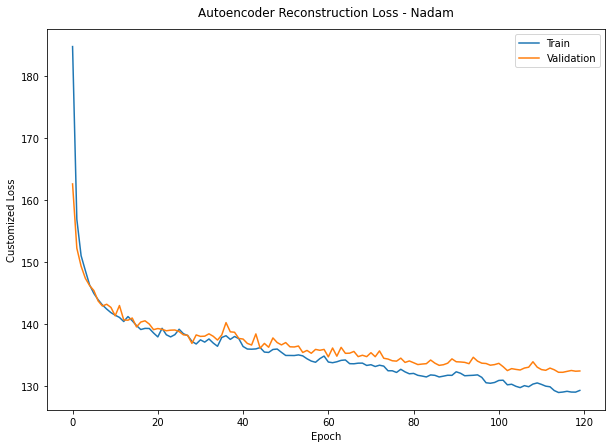

In [ ]:
# Plot training and validation loss scores
# against the number of epochs.
plt.figure(figsize=(10, 7))
plt.plot(history_vae.history['loss'], label='Train')
plt.plot(history_vae.history['val_loss'], label='Validation')
plt.ylabel('Customized Loss')
plt.xlabel('Epoch')
plt.title('Autoencoder Reconstruction Loss - Nadam', pad=13)
plt.legend(loc='upper right')

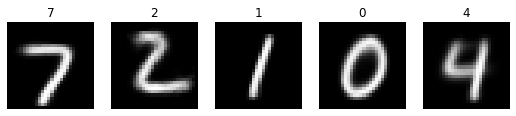

In [ ]:
compressed_images = vae.predict(test_images)
n = 5
plt.figure(figsize=(9, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")

  plt.title(test_labels[i])
  ax.axis('off')

plt.show()

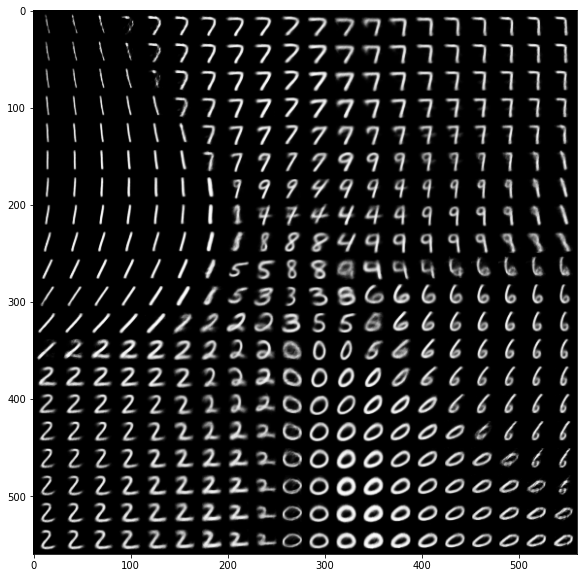

In [ ]:
# Display a 2D manifold of the digits
n = 20  # figure with 15x15 digits
digit_size = 28
figure = np.zeros((digit_size * n, digit_size * n))
# We will sample n points within [-15, 15] standard deviations
grid_x = np.linspace(-3, 3, n)
grid_y = np.linspace(-3, 3, n)

for i, yi in enumerate(grid_x):
    for j, xi in enumerate(grid_y):
        z_sample = np.array([[xi, yi]])
        x_decoded = decoder.predict(z_sample)
        digit = x_decoded[0].reshape(digit_size, digit_size)
        figure[i * digit_size: (i + 1) * digit_size,
               j * digit_size: (j + 1) * digit_size] = digit

plt.figure(figsize=(10, 10))
plt.imshow(figure, cmap="gray")
plt.show()

In [ ]:
vae.save(f'/content/drive/MyDrive/Exercises/Autoencoders/vae_prelu/autoencoder')
encoder.save(f'/content/drive/MyDrive/Exercises/Autoencoders/vae_prelu/encoder')

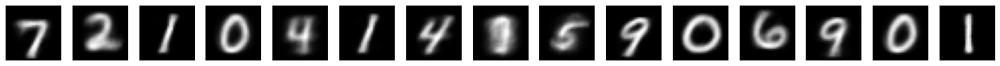

In [ ]:
compressed_images = vae.predict(test_images)[0]
n = 15
plt.figure(figsize=(22, 2))
for i in range(n):
  ax = plt.subplot(1, n, i+1)
  plt.imshow(compressed_images[i].reshape(28, 28), cmap="gray")
  ax.axis('off')

plt.show()

# END